In [1]:
# !pip list

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
sns.set(font_scale=1.2)
import matplotlib
matplotlib.rcParams['figure.figsize'] = (12,8)
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = (12,8)
%matplotlib inline

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [2]:
# load dataset
df = pd.read_excel(r'part6\Historical Weather Data 2010-2021.xlsx', sheet_name='201021')
df.head()

,observation,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,Relative humidity_6to7,Relative humidity_avg(%),windspeedKmph_7to8,...,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No),Type of Disease (Bacterial Blight/Telya),Anthracnose,Fruit Spot/ Rot,Fusarium Wilt,Fruit Borer / Blight Blora
0,2010-01-01,20,30,20,23,42,33,59,44,9,...,45,6.91,7.18,1709.0,NO,NaN,NaN,NaN,NaN,NaN
1,2010-01-02,23,29,23,25,49,40,62,50,9,...,45,6.77,7.66,1707.0,YES,Bacterial Blight,Anthracnose,NaN,NaN,NaN
2,2010-01-03,24,27,21,24,61,50,78,63,4,...,41,6.76,7.44,1707.0,NO,NaN,NaN,NaN,NaN,NaN
3,2010-01-04,23,29,20,24,57,30,52,46,5,...,43,7.10,7.43,1708.0,NO,NaN,NaN,NaN,NaN,NaN
4,2010-01-05,22,30,21,24,48,34,54,45,6,...,44,6.53,8.05,1709.0,NO,NaN,NaN,NaN,NaN,NaN


In [3]:
# list of columns
print(list(df.columns))

['observation', 'tempC_7to8', 'tempC_1to2', 'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8', 'Relative humidity_1to2', 'Relative humidity_6to7', 'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2', 'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8', 'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8', 'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)', 'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7', 'Sunshine Hours', '%_soil_moisure', 'soil_pH', 'water_pH', 'water_TDS_mgpl', 'Label (Disease Yes/No)', 'Type of Disease (Bacterial Blight/Telya)', 'Anthracnose', 'Fruit Spot/ Rot', 'Fusarium Wilt', 'Fruit Borer / Blight Blora']


In [4]:
# dataframe raw information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4227 entries, 0 to 4226
Data columns (total 35 columns):
 #   Column                                    Non-Null Count  Dtype         
---  ------                                    --------------  -----         
 0   observation                               4227 non-null   datetime64[ns]
 1   tempC_7to8                                4227 non-null   int64         
 2   tempC_1to2                                4227 non-null   int64         
 3   tempC_6to7                                4227 non-null   int64         
 4   tempC_avg(0C)                             4227 non-null   int64         
 5   Relative humidity_7to8                    4227 non-null   int64         
 6   Relative humidity_1to2                    4227 non-null   int64         
 7   Relative humidity_6to7                    4227 non-null   int64         
 8   Relative humidity_avg(%)                  4227 non-null   int64         
 9   windspeedKmph_7to8            

# Observation:
- null values with columns :- 

> 30  Type of Disease (Bacterial Blight/Telya)  1174 non-null   object        
> 31  Anthracnose                               676 non-null    object        
> 32  Fruit Spot/ Rot                           464 non-null    object        
> 33  Fusarium Wilt                             103 non-null    object        
> 34  Fruit Borer / Blight Blora                787 non-null    object

- categorical columns :- 

> 21  weatherDesc_7to8                          4227 non-null   object        
> 22  weatherDesc_1to2                          4227 non-null   object        
> 23  weatherDesc_6to7                          4227 non-null   object
> 29  Label (Disease Yes/No)                    4227 non-null   object        
> 30  Type of Disease (Bacterial Blight/Telya)  1174 non-null   object        
> 31  Anthracnose                               676 non-null    object        
> 32  Fruit Spot/ Rot                           464 non-null    object        
> 33  Fusarium Wilt                             103 non-null    object        
> 34  Fruit Borer / Blight Blora                787 non-null    object 


In [15]:
# to check only data type of columns
df.dtypes

observation                                 datetime64[ns]
tempC_7to8                                           int64
tempC_1to2                                           int64
tempC_6to7                                           int64
tempC_avg(0C)                                        int64
Relative humidity_7to8                               int64
Relative humidity_1to2                               int64
Relative humidity_6to7                               int64
Relative humidity_avg(%)                             int64
windspeedKmph_7to8                                   int64
windspeedKmph_1to2                                   int64
windspeedKmph_6to7                                   int64
windspeedKmph_avg(Km/h)                              int64
pressureMB_7to8                                      int64
pressureMB_1to2                                      int64
pressureMB_6to7                                      int64
pressureMB_avg                                       int

In [5]:
df['Label (Disease Yes/No)'].unique()

array(['NO', 'YES', 'yes', 'Yes'], dtype=object)

In [6]:
df['Label (Disease Yes/No)'].value_counts()

NO     2470
YES    1746
yes      10
Yes       1
Name: Label (Disease Yes/No), dtype: int64

In [7]:
df['Label (Disease Yes/No)'] = np.where(df['Label (Disease Yes/No)'] == 'NO',0,1)
df.head()

,observation,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,Relative humidity_6to7,Relative humidity_avg(%),windspeedKmph_7to8,...,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No),Type of Disease (Bacterial Blight/Telya),Anthracnose,Fruit Spot/ Rot,Fusarium Wilt,Fruit Borer / Blight Blora
0,2010-01-01,20,30,20,23,42,33,59,44,9,...,45,6.91,7.18,1709.0,0,NaN,NaN,NaN,NaN,NaN
1,2010-01-02,23,29,23,25,49,40,62,50,9,...,45,6.77,7.66,1707.0,1,Bacterial Blight,Anthracnose,NaN,NaN,NaN
2,2010-01-03,24,27,21,24,61,50,78,63,4,...,41,6.76,7.44,1707.0,0,NaN,NaN,NaN,NaN,NaN
3,2010-01-04,23,29,20,24,57,30,52,46,5,...,43,7.10,7.43,1708.0,0,NaN,NaN,NaN,NaN,NaN
4,2010-01-05,22,30,21,24,48,34,54,45,6,...,44,6.53,8.05,1709.0,0,NaN,NaN,NaN,NaN,NaN


In [8]:
df['Label (Disease Yes/No)'].unique()

array([0, 1])

In [9]:
df['Label (Disease Yes/No)'].value_counts()

0    2470
1    1757
Name: Label (Disease Yes/No), dtype: int64

# Observation:
- categorical variables converted to number.
- **Dummy Coding:** Dummy coding is a commonly used method for converting a categorical input variable into continuous variable. ‘Dummy’, as the name suggests is a duplicate variable which represents one level of a categorical variable. Presence of a level is represent by 1 and absence is represented by 0. For every level present, one dummy variable will be created.

In [10]:
df.describe()

,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,Relative humidity_6to7,Relative humidity_avg(%),windspeedKmph_7to8,windspeedKmph_1to2,...,precipMM_7to8,precipMM_1to2,precipMM_6to7,precipMM_avg(mm),Sunshine Hours,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No)
count,4227.000000,4227.000000,4227.000000,4227.000000,4227.000000,4227.000000,4227.000000,4227.000000,4227.000000,4227.000000,...,4227.000000,4227.000000,4227.000000,4227.000000,4227.00000,4227.000000,4227.000000,4227.000000,4227.000000,4227.000000
mean,25.442631,30.345635,24.677313,26.489236,54.340194,41.961675,57.377573,50.893542,10.160161,12.697894,...,0.049799,0.125905,0.210054,0.128586,8.29392,45.418737,7.029707,7.482685,1703.469375,0.415661
std,3.707631,4.409258,3.797272,3.558857,23.713679,25.747177,25.953148,24.644506,5.859423,7.132430,...,0.290008,0.342865,0.787239,0.376221,2.61489,10.338850,0.256483,0.500309,19.377816,0.492894
min,12.000000,17.000000,15.000000,17.000000,6.000000,4.000000,8.000000,6.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,3.80000,30.000000,6.500000,6.500000,1624.500000,0.000000
25%,23.000000,27.000000,22.000000,24.000000,34.000000,19.000000,34.000000,29.000000,6.000000,7.000000,...,0.000000,0.000000,0.000000,0.000000,5.40000,35.000000,6.850000,7.120000,1707.000000,0.000000
50%,25.000000,29.000000,24.000000,26.000000,51.000000,33.000000,52.000000,45.000000,9.000000,12.000000,...,0.000000,0.000000,0.000000,0.000000,9.60000,44.000000,7.040000,7.500000,1708.000000,0.000000
75%,28.000000,33.000000,27.000000,29.000000,78.000000,67.000000,85.500000,77.000000,13.000000,17.000000,...,0.000000,0.100000,0.100000,0.100000,10.40000,52.000000,7.200000,7.800000,1709.000000,1.000000
max,36.000000,42.000000,39.000000,37.000000,98.000000,98.000000,99.000000,98.000000,42.000000,41.000000,...,10.200000,7.000000,22.000000,8.300000,11.20000,85.000000,7.500000,8.500000,1710.000000,1.000000


# Find null values

In [11]:
df.isnull().sum()

observation                                    0
tempC_7to8                                     0
tempC_1to2                                     0
tempC_6to7                                     0
tempC_avg(0C)                                  0
Relative humidity_7to8                         0
Relative humidity_1to2                         0
Relative humidity_6to7                         0
Relative humidity_avg(%)                       0
windspeedKmph_7to8                             0
windspeedKmph_1to2                             0
windspeedKmph_6to7                             0
windspeedKmph_avg(Km/h)                        0
pressureMB_7to8                                0
pressureMB_1to2                                0
pressureMB_6to7                                0
pressureMB_avg                                 0
precipMM_7to8                                  0
precipMM_1to2                                  0
precipMM_6to7                                  0
precipMM_avg(mm)    

<AxesSubplot:>

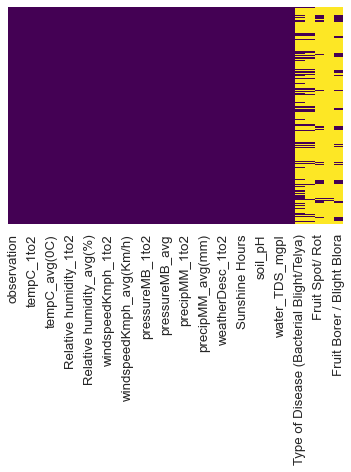

In [12]:
sns.heatmap(df.isnull(), yticklabels=False, cbar=False, cmap='viridis')

In [13]:
[feature for feature in df.columns if df[feature].isnull().sum()>1]

['Type of Disease (Bacterial Blight/Telya)',
 'Anthracnose',
 'Fruit Spot/ Rot',
 'Fusarium Wilt',
 'Fruit Borer / Blight Blora']

# Observation:

- ['Type of Disease (Bacterial Blight/Telya)', 'Anthracnose', 'Fruit Spot/ Rot', 'Fusarium Wilt', 'Fruit Borer / Blight Blora'] have null values.

- the columns / features all are dependent variable and null value is easily fill by 0.


# Convert or preprocess on the categorical variable (data type == object)

# Convert the following columns:
- weatherDesc_7to8, weatherDesc_1to2, weatherDesc_6to7
- priority: Heavy Rainfall (1), Moderate rainfall (2), less or irregular or patchy rainfall(3), cloudy weather (4) and sunny or clear weather (5-No disease)

- priority: ` Heavy Rainfall (1), Moderate rainfall (2), less or irregular or patchy rainfall(3), cloudy weather (4) and sunny or clear weather (5-No disease), 'Clear (5)', 'Cloudy(4) ', 'Fog (5)', 'Heavy rain (1)', 'Heavy rain at times (5)', 'Light drizzle (3)', 'Light rain(3)', 'Light rain shower(3)', 'Mist (3)', 'Moderate or heavy rain shower (1)', 'Moderate rain (2)', 'Moderate rain at times (2)', 'Overcast(3)', 'Partly cloudy(4)', 'Patchy light drizzle(3)', 'Patchy light rain(3)', 'Patchy light rain with thunder(3)', 'Patchy rain possible(3)', 'Sunny(5)', 'Thundery outbreaks possible(2)', 'Torrential rain shower (2)' `

- 'Clear', 'Cloudy', 'Fog', 'Heavy rain', 'Heavy rain at times', 'Light drizzle', 'Light rain', 'Light rain shower', 'Mist', 'Moderate or heavy rain shower', 'Moderate rain', 'Moderate rain at times', 'Overcast', 'Partly cloudy', 'Patchy light drizzle', 'Patchy light rain', 'Patchy light rain with thunder', 'Patchy rain possible', 'Sunny', 'Thundery outbreaks possible', 'Torrential rain shower'


In [16]:
df['weatherDesc_7to8'].unique(), len(df['weatherDesc_7to8'].unique())

(array(['Clear', 'Partly cloudy', 'Patchy light drizzle',
        'Patchy light rain with thunder', 'Patchy rain possible',
        'Light rain shower', 'Moderate or heavy rain shower', 'Cloudy',
        'Moderate rain', 'Light drizzle', 'Overcast', 'Light rain', 'Mist',
        'Torrential rain shower', 'Heavy rain', 'Patchy light rain',
        'Moderate rain at times', 'Heavy rain at times', 'Sunny',
        'Thundery outbreaks possible', 'Fog'], dtype=object),
 21)

In [17]:
df['weatherDesc_7to8'].value_counts()

Clear                             1895
Partly cloudy                      710
Sunny                              582
Light rain shower                  278
Cloudy                             228
Light drizzle                      139
Patchy rain possible               110
Light rain                          68
Overcast                            55
Moderate rain                       42
Patchy light drizzle                38
Moderate or heavy rain shower       28
Mist                                17
Moderate rain at times              10
Heavy rain                           9
Patchy light rain                    7
Fog                                  4
Patchy light rain with thunder       2
Torrential rain shower               2
Heavy rain at times                  2
Thundery outbreaks possible          1
Name: weatherDesc_7to8, dtype: int64

In [18]:
df['weatherDesc_1to2'].unique(), len(df['weatherDesc_1to2'].unique())

(array(['Sunny', 'Partly cloudy', 'Patchy rain possible',
        'Thundery outbreaks possible', 'Light rain shower',
        'Patchy light rain with thunder', 'Moderate or heavy rain shower',
        'Moderate rain', 'Moderate rain at times', 'Patchy light drizzle',
        'Heavy rain', 'Light drizzle', 'Light rain', 'Patchy light rain',
        'Torrential rain shower', 'Cloudy', 'Overcast',
        'Heavy rain at times'], dtype=object),
 18)

In [19]:
df['weatherDesc_1to2'].value_counts()

Sunny                             2215
Light rain shower                  620
Partly cloudy                      519
Patchy rain possible               417
Moderate or heavy rain shower      214
Light rain                          56
Moderate rain                       49
Cloudy                              20
Light drizzle                       20
Heavy rain                          17
Heavy rain at times                 13
Torrential rain shower              11
Patchy light drizzle                11
Patchy light rain                   10
Overcast                            10
Thundery outbreaks possible          9
Moderate rain at times               8
Patchy light rain with thunder       8
Name: weatherDesc_1to2, dtype: int64

In [20]:
df['weatherDesc_6to7'].unique(), len(df['weatherDesc_6to7'].unique())

(array(['Sunny', 'Partly cloudy', 'Patchy rain possible',
        'Patchy light rain with thunder', 'Overcast', 'Light rain',
        'Moderate rain', 'Heavy rain', 'Patchy light rain',
        'Light rain shower', 'Moderate rain at times', 'Cloudy',
        'Moderate or heavy rain shower', 'Patchy light drizzle', 'Mist',
        'Light drizzle', 'Fog', 'Torrential rain shower',
        'Heavy rain at times', 'Clear'], dtype=object),
 20)

In [21]:
df['weatherDesc_6to7'].value_counts()

Sunny                             1743
Clear                              552
Partly cloudy                      511
Light rain shower                  408
Patchy rain possible               335
Cloudy                             119
Light drizzle                      109
Moderate or heavy rain shower      104
Light rain                          89
Mist                                68
Moderate rain                       38
Overcast                            38
Patchy light drizzle                26
Heavy rain                          19
Torrential rain shower              18
Moderate rain at times              17
Patchy light rain                   11
Patchy light rain with thunder      11
Fog                                  6
Heavy rain at times                  5
Name: weatherDesc_6to7, dtype: int64

In [22]:
weatherDesc = list(set(list(df['weatherDesc_7to8'].unique()) + list(df['weatherDesc_1to2'].unique()) + list(df['weatherDesc_6to7'].unique())))
weatherDesc.sort()
print(weatherDesc, len(weatherDesc))

['Clear', 'Cloudy', 'Fog', 'Heavy rain', 'Heavy rain at times', 'Light drizzle', 'Light rain', 'Light rain shower', 'Mist', 'Moderate or heavy rain shower', 'Moderate rain', 'Moderate rain at times', 'Overcast', 'Partly cloudy', 'Patchy light drizzle', 'Patchy light rain', 'Patchy light rain with thunder', 'Patchy rain possible', 'Sunny', 'Thundery outbreaks possible', 'Torrential rain shower'] 21


# Observation : 

- As the values and prioritys are give, so Convert the categorical variable using `replacing values` method.

> df['col'].replace(['a', 'b'], [0, 1], inplace=True)

In [29]:
keys = ['Clear', 'Cloudy', 'Fog', 'Heavy rain', 'Heavy rain at times', 'Light drizzle', 'Light rain', 'Light rain shower', 
        'Mist', 'Moderate or heavy rain shower', 'Moderate rain', 'Moderate rain at times', 'Overcast', 'Partly cloudy', 
        'Patchy light drizzle', 'Patchy light rain', 'Patchy light rain with thunder', 'Patchy rain possible', 'Sunny', 
        'Thundery outbreaks possible', 'Torrential rain shower'] 
vals = [5,4,5,1,5,3,3,3,3,1,2,2,3,4,3,3,3,3,5,2,2]

df['weatherDesc_7to8'].replace(keys, vals, inplace=True)
df['weatherDesc_1to2'].replace(keys, vals, inplace=True)
df['weatherDesc_6to7'].replace(keys, vals, inplace=True)

In [59]:
priority_dict = {keys[i]:vals[i] for i in range(len(keys))}
priority_dict

{'Clear': 5,
 'Cloudy': 4,
 'Fog': 5,
 'Heavy rain': 1,
 'Heavy rain at times': 5,
 'Light drizzle': 3,
 'Light rain': 3,
 'Light rain shower': 3,
 'Mist': 3,
 'Moderate or heavy rain shower': 1,
 'Moderate rain': 2,
 'Moderate rain at times': 2,
 'Overcast': 3,
 'Partly cloudy': 4,
 'Patchy light drizzle': 3,
 'Patchy light rain': 3,
 'Patchy light rain with thunder': 3,
 'Patchy rain possible': 3,
 'Sunny': 5,
 'Thundery outbreaks possible': 2,
 'Torrential rain shower': 2}

In [38]:
df.iloc[:,21:24]

,weatherDesc_7to8,weatherDesc_1to2,weatherDesc_6to7
0,5,5,5
1,5,4,4
2,4,4,4
3,5,5,5
4,5,5,5
...,...,...,...
4222,5,5,5
4223,5,5,5
4224,5,5,5
4225,5,5,3


In [49]:
df['weatherDesc'] = [min(df['weatherDesc_7to8'][i],df['weatherDesc_1to2'][i],df['weatherDesc_6to7'][i]) for i in range(len(df))]

In [53]:
# Rearrange columns in any way you want.

columns = ['observation', 'tempC_7to8', 'tempC_1to2', 'tempC_6to7',
       'tempC_avg(0C)', 'Relative humidity_7to8', 'Relative humidity_1to2',
       'Relative humidity_6to7', 'Relative humidity_avg(%)',
       'windspeedKmph_7to8', 'windspeedKmph_1to2', 'windspeedKmph_6to7',
       'windspeedKmph_avg(Km/h)', 'pressureMB_7to8', 'pressureMB_1to2',
       'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8', 'precipMM_1to2',
       'precipMM_6to7', 'precipMM_avg(mm)', 'weatherDesc_7to8',
       'weatherDesc_1to2', 'weatherDesc_6to7', 'weatherDesc', 'Sunshine Hours',
       '%_soil_moisure', 'soil_pH', 'water_pH', 'water_TDS_mgpl',
       'Label (Disease Yes/No)', 'Type of Disease (Bacterial Blight/Telya)',
       'Anthracnose', 'Fruit Spot/ Rot', 'Fusarium Wilt',
       'Fruit Borer / Blight Blora']
df = df[columns]
df.iloc[:,21:]

,weatherDesc_7to8,weatherDesc_1to2,weatherDesc_6to7,weatherDesc,Sunshine Hours,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No),Type of Disease (Bacterial Blight/Telya),Anthracnose,Fruit Spot/ Rot,Fusarium Wilt,Fruit Borer / Blight Blora
0,5,5,5,5,9.8,45,6.91,7.18,1709.0,0,NaN,NaN,NaN,NaN,NaN
1,5,4,4,4,9.8,45,6.77,7.66,1707.0,1,Bacterial Blight,Anthracnose,NaN,NaN,NaN
2,4,4,4,4,9.8,41,6.76,7.44,1707.0,0,NaN,NaN,NaN,NaN,NaN
3,5,5,5,5,9.8,43,7.10,7.43,1708.0,0,NaN,NaN,NaN,NaN,NaN
4,5,5,5,5,9.8,44,6.53,8.05,1709.0,0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4222,5,5,5,5,9.7,41,7.17,7.69,1707.0,1,Bacterial Blight,NaN,NaN,NaN,NaN
4223,5,5,5,5,9.7,42,7.46,8.22,1709.0,1,Bacterial Blight,NaN,NaN,NaN,NaN
4224,5,5,5,5,9.7,44,7.38,7.92,1709.0,0,NaN,NaN,NaN,NaN,NaN
4225,5,5,3,3,9.6,41,7.01,7.16,1630.2,0,NaN,NaN,NaN,NaN,NaN


In [62]:
df['weatherDesc'].value_counts()

5    2029
3    1229
4     527
1     331
2     111
Name: weatherDesc, dtype: int64

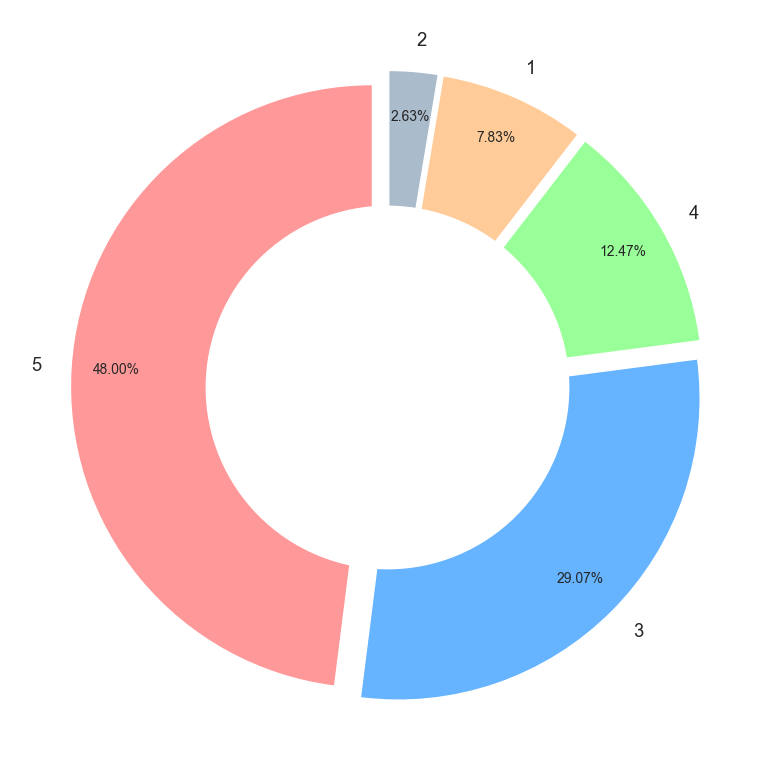

In [95]:
val = df['weatherDesc'].value_counts().values
ind_name = df['weatherDesc'].value_counts().index

# https://medium.com/@kvnamipara/a-better-visualisation-of-pie-charts-by-matplotlib-935b7667d77f
# https://www.geeksforgeeks.org/donut-chart-using-matplotlib-in-python/

# explosion
explode = (0.05, 0.05, 0.05, 0.05, 0.05)
#add colors
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99','#aabbcc']

plt.figure(figsize=(12, 10), dpi=100)
plt.pie(val, labels=ind_name, pctdistance=0.85, colors=colors,
        explode=explode, autopct='%1.2f%%', startangle=90) # , shadow=True

# draw circle
centre_circle = plt.Circle((0, 0), 0.60, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)

# Observation :

- `48%` time we have `Clear` weather.
- `29.07%` time we have `Light Rain` weather.
- `12.47%` time we have `Cloudy` weather.
- `7.83%` time we have `Heavy Rain` weather.
- `2.63%` time we have `Moderate Rain` weather.

In [96]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4227 entries, 0 to 4226
Data columns (total 36 columns):
 #   Column                                    Non-Null Count  Dtype         
---  ------                                    --------------  -----         
 0   observation                               4227 non-null   datetime64[ns]
 1   tempC_7to8                                4227 non-null   int64         
 2   tempC_1to2                                4227 non-null   int64         
 3   tempC_6to7                                4227 non-null   int64         
 4   tempC_avg(0C)                             4227 non-null   int64         
 5   Relative humidity_7to8                    4227 non-null   int64         
 6   Relative humidity_1to2                    4227 non-null   int64         
 7   Relative humidity_6to7                    4227 non-null   int64         
 8   Relative humidity_avg(%)                  4227 non-null   int64         
 9   windspeedKmph_7to8            

# Handle Missing Value's

In [101]:
df['Type of Disease (Bacterial Blight/Telya)'].fillna(0, inplace=True)
df['Anthracnose'].fillna(0, inplace=True)
df['Fruit Spot/ Rot'].fillna(0, inplace=True)
df['Fusarium Wilt'].fillna(0, inplace=True)
df['Fruit Borer / Blight Blora'].fillna(0, inplace=True)
df

,observation,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,Relative humidity_6to7,Relative humidity_avg(%),windspeedKmph_7to8,...,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No),Type of Disease (Bacterial Blight/Telya),Anthracnose,Fruit Spot/ Rot,Fusarium Wilt,Fruit Borer / Blight Blora
0,2010-01-01,20,30,20,23,42,33,59,44,9,...,45,6.91,7.18,1709.0,0,0,0,0,0,0
1,2010-01-02,23,29,23,25,49,40,62,50,9,...,45,6.77,7.66,1707.0,1,Bacterial Blight,Anthracnose,0,0,0
2,2010-01-03,24,27,21,24,61,50,78,63,4,...,41,6.76,7.44,1707.0,0,0,0,0,0,0
3,2010-01-04,23,29,20,24,57,30,52,46,5,...,43,7.10,7.43,1708.0,0,0,0,0,0,0
4,2010-01-05,22,30,21,24,48,34,54,45,6,...,44,6.53,8.05,1709.0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4222,2021-11-27,21,32,27,26,56,35,48,46,3,...,41,7.17,7.69,1707.0,1,Bacterial Blight,0,0,0,0
4223,2021-11-28,21,31,26,26,58,32,40,43,7,...,42,7.46,8.22,1709.0,1,Bacterial Blight,0,0,0,0
4224,2021-11-29,17,26,24,22,49,29,38,38,12,...,44,7.38,7.92,1709.0,0,0,0,0,0,0
4225,2021-11-30,17,27,22,22,52,41,64,52,14,...,41,7.01,7.16,1630.2,0,0,0,0,0,0


In [102]:
df['Type of Disease (Bacterial Blight/Telya)'].unique(), len(df['Type of Disease (Bacterial Blight/Telya)'].unique())

(array([0, 'Bacterial Blight', 'Bacterial Blight (Telya)'], dtype=object), 3)

In [103]:
df['Type of Disease (Bacterial Blight/Telya)'].value_counts()

0                           3053
Bacterial Blight             875
Bacterial Blight (Telya)     299
Name: Type of Disease (Bacterial Blight/Telya), dtype: int64

In [104]:
df['Type of Disease (Bacterial Blight/Telya)'] = np.where(df['Type of Disease (Bacterial Blight/Telya)'] == 0,0,1)

In [105]:
df['Anthracnose'].unique(), len(df['Anthracnose'].unique())

(array([0, 'Anthracnose', 'Anthrocnose', 'Anthocnose', 'Antrocnose'],
       dtype=object),
 5)

In [106]:
df['Anthracnose'].value_counts()

0              3551
Anthrocnose     438
Anthracnose     219
Anthocnose       17
Antrocnose        2
Name: Anthracnose, dtype: int64

In [107]:
df['Anthracnose'] = np.where(df['Anthracnose'] == 0,0,1)

In [109]:
df['Fruit Spot/ Rot'].unique(), len(df['Fruit Spot/ Rot'].unique())

(array([0, 'Fruit Spot/ Rot', 'Fruit Spot /Rot', 'Fruit Spot/Rot',
        'Fruit Spot / Rot', 'Fruit Spot/ rot'], dtype=object),
 6)

In [110]:
df['Fruit Spot/ Rot'].value_counts()

0                   3763
Fruit Spot/ Rot      327
Fruit Spot/ rot       46
Fruit Spot /Rot       40
Fruit Spot / Rot      39
Fruit Spot/Rot        12
Name: Fruit Spot/ Rot, dtype: int64

In [111]:
df['Fruit Spot/ Rot'] = np.where(df['Fruit Spot/ Rot'] == 0,0,1)

In [112]:
df['Fusarium Wilt'].unique(), len(df['Fusarium Wilt'].unique())

(array([0, 'Fusarium Wilt'], dtype=object), 2)

In [113]:
df['Fusarium Wilt'].value_counts()

0                4124
Fusarium Wilt     103
Name: Fusarium Wilt, dtype: int64

In [114]:
df['Fusarium Wilt'] = np.where(df['Fusarium Wilt'] == 0,0,1)

In [115]:
df['Fruit Borer / Blight Blora'].unique(), len(df['Fruit Borer / Blight Blora'].unique())

(array([0, 'Fruit Borer / Blight Blora', 'Blight Blora'], dtype=object), 3)

In [116]:
df['Fruit Borer / Blight Blora'].value_counts()

0                             3440
Fruit Borer / Blight Blora     784
Blight Blora                     3
Name: Fruit Borer / Blight Blora, dtype: int64

In [117]:
df['Fruit Borer / Blight Blora'] = np.where(df['Fruit Borer / Blight Blora'] == 0,0,1)

In [118]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4227 entries, 0 to 4226
Data columns (total 36 columns):
 #   Column                                    Non-Null Count  Dtype         
---  ------                                    --------------  -----         
 0   observation                               4227 non-null   datetime64[ns]
 1   tempC_7to8                                4227 non-null   int64         
 2   tempC_1to2                                4227 non-null   int64         
 3   tempC_6to7                                4227 non-null   int64         
 4   tempC_avg(0C)                             4227 non-null   int64         
 5   Relative humidity_7to8                    4227 non-null   int64         
 6   Relative humidity_1to2                    4227 non-null   int64         
 7   Relative humidity_6to7                    4227 non-null   int64         
 8   Relative humidity_avg(%)                  4227 non-null   int64         
 9   windspeedKmph_7to8            

# Consider the observation columns and convert it into  date, month, year

In [128]:
int(df['observation'].astype('str').str.split('-')[0][2]), int(df['observation'].astype('str').str.split('-')[0][1]), int(df['observation'].astype('str').str.split('-')[0][0])

(1, 1, 2010)

In [150]:
df['date'] = [int(str(df['observation'][i]).split(' ')[0].split('-')[2]) for i in range(len(df))]
df['month'] = [int(str(df['observation'][i]).split(' ')[0].split('-')[1]) for i in range(len(df))]
df['year'] = [int(str(df['observation'][i]).split(' ')[0].split('-')[0]) for i in range(len(df))]

In [151]:
df

,observation,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,Relative humidity_6to7,Relative humidity_avg(%),windspeedKmph_7to8,...,water_TDS_mgpl,Label (Disease Yes/No),Type of Disease (Bacterial Blight/Telya),Anthracnose,Fruit Spot/ Rot,Fusarium Wilt,Fruit Borer / Blight Blora,date,month,year
0,2010-01-01,20,30,20,23,42,33,59,44,9,...,1709.0,0,0,0,0,0,0,1,1,2010
1,2010-01-02,23,29,23,25,49,40,62,50,9,...,1707.0,1,1,1,0,0,0,2,1,2010
2,2010-01-03,24,27,21,24,61,50,78,63,4,...,1707.0,0,0,0,0,0,0,3,1,2010
3,2010-01-04,23,29,20,24,57,30,52,46,5,...,1708.0,0,0,0,0,0,0,4,1,2010
4,2010-01-05,22,30,21,24,48,34,54,45,6,...,1709.0,0,0,0,0,0,0,5,1,2010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4222,2021-11-27,21,32,27,26,56,35,48,46,3,...,1707.0,1,1,0,0,0,0,27,11,2021
4223,2021-11-28,21,31,26,26,58,32,40,43,7,...,1709.0,1,1,0,0,0,0,28,11,2021
4224,2021-11-29,17,26,24,22,49,29,38,38,12,...,1709.0,0,0,0,0,0,0,29,11,2021
4225,2021-11-30,17,27,22,22,52,41,64,52,14,...,1630.2,0,0,0,0,0,0,30,11,2021


In [152]:
df.columns

Index(['observation', 'tempC_7to8', 'tempC_1to2', 'tempC_6to7',
       'tempC_avg(0C)', 'Relative humidity_7to8', 'Relative humidity_1to2',
       'Relative humidity_6to7', 'Relative humidity_avg(%)',
       'windspeedKmph_7to8', 'windspeedKmph_1to2', 'windspeedKmph_6to7',
       'windspeedKmph_avg(Km/h)', 'pressureMB_7to8', 'pressureMB_1to2',
       'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8', 'precipMM_1to2',
       'precipMM_6to7', 'precipMM_avg(mm)', 'weatherDesc_7to8',
       'weatherDesc_1to2', 'weatherDesc_6to7', 'weatherDesc', 'Sunshine Hours',
       '%_soil_moisure', 'soil_pH', 'water_pH', 'water_TDS_mgpl',
       'Label (Disease Yes/No)', 'Type of Disease (Bacterial Blight/Telya)',
       'Anthracnose', 'Fruit Spot/ Rot', 'Fusarium Wilt',
       'Fruit Borer / Blight Blora', 'date', 'month', 'year'],
      dtype='object')

In [153]:
# Rearrange columns in any way you want.

columns = ['observation', 'date', 'month', 'year', 'tempC_7to8', 'tempC_1to2', 'tempC_6to7',
       'tempC_avg(0C)', 'Relative humidity_7to8', 'Relative humidity_1to2',
       'Relative humidity_6to7', 'Relative humidity_avg(%)',
       'windspeedKmph_7to8', 'windspeedKmph_1to2', 'windspeedKmph_6to7',
       'windspeedKmph_avg(Km/h)', 'pressureMB_7to8', 'pressureMB_1to2',
       'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8', 'precipMM_1to2',
       'precipMM_6to7', 'precipMM_avg(mm)', 'weatherDesc_7to8',
       'weatherDesc_1to2', 'weatherDesc_6to7', 'weatherDesc', 'Sunshine Hours',
       '%_soil_moisure', 'soil_pH', 'water_pH', 'water_TDS_mgpl',
       'Label (Disease Yes/No)', 'Type of Disease (Bacterial Blight/Telya)',
       'Anthracnose', 'Fruit Spot/ Rot', 'Fusarium Wilt',
       'Fruit Borer / Blight Blora']
df = df[columns]
df

,observation,date,month,year,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,...,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No),Type of Disease (Bacterial Blight/Telya),Anthracnose,Fruit Spot/ Rot,Fusarium Wilt,Fruit Borer / Blight Blora
0,2010-01-01,1,1,2010,20,30,20,23,42,33,...,45,6.91,7.18,1709.0,0,0,0,0,0,0
1,2010-01-02,2,1,2010,23,29,23,25,49,40,...,45,6.77,7.66,1707.0,1,1,1,0,0,0
2,2010-01-03,3,1,2010,24,27,21,24,61,50,...,41,6.76,7.44,1707.0,0,0,0,0,0,0
3,2010-01-04,4,1,2010,23,29,20,24,57,30,...,43,7.10,7.43,1708.0,0,0,0,0,0,0
4,2010-01-05,5,1,2010,22,30,21,24,48,34,...,44,6.53,8.05,1709.0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4222,2021-11-27,27,11,2021,21,32,27,26,56,35,...,41,7.17,7.69,1707.0,1,1,0,0,0,0
4223,2021-11-28,28,11,2021,21,31,26,26,58,32,...,42,7.46,8.22,1709.0,1,1,0,0,0,0
4224,2021-11-29,29,11,2021,17,26,24,22,49,29,...,44,7.38,7.92,1709.0,0,0,0,0,0,0
4225,2021-11-30,30,11,2021,17,27,22,22,52,41,...,41,7.01,7.16,1630.2,0,0,0,0,0,0


In [154]:
df.to_csv('part6\Historical Weather Data 2010-2021_preprocessed.csv', index=False)

# After Pre-processing

In [6]:
import numpy as np
import pandas as pd
import seaborn as sns
sns.set(font_scale=1.2)
import matplotlib
matplotlib.rcParams['figure.figsize'] = (12,8)
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = (12,8)
%matplotlib inline

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [7]:
df = pd.read_csv('part6\Historical Weather Data 2010-2021_preprocessed.csv')
df

,observation,date,month,year,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,...,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No),Type of Disease (Bacterial Blight/Telya),Anthracnose,Fruit Spot/ Rot,Fusarium Wilt,Fruit Borer / Blight Blora
0,2010-01-01,1,1,2010,20,30,20,23,42,33,...,45,6.91,7.18,1709.0,0,0,0,0,0,0
1,2010-01-02,2,1,2010,23,29,23,25,49,40,...,45,6.77,7.66,1707.0,1,1,1,0,0,0
2,2010-01-03,3,1,2010,24,27,21,24,61,50,...,41,6.76,7.44,1707.0,0,0,0,0,0,0
3,2010-01-04,4,1,2010,23,29,20,24,57,30,...,43,7.10,7.43,1708.0,0,0,0,0,0,0
4,2010-01-05,5,1,2010,22,30,21,24,48,34,...,44,6.53,8.05,1709.0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4222,2021-11-27,27,11,2021,21,32,27,26,56,35,...,41,7.17,7.69,1707.0,1,1,0,0,0,0
4223,2021-11-28,28,11,2021,21,31,26,26,58,32,...,42,7.46,8.22,1709.0,1,1,0,0,0,0
4224,2021-11-29,29,11,2021,17,26,24,22,49,29,...,44,7.38,7.92,1709.0,0,0,0,0,0,0
4225,2021-11-30,30,11,2021,17,27,22,22,52,41,...,41,7.01,7.16,1630.2,0,0,0,0,0,0


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4227 entries, 0 to 4226
Data columns (total 39 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   observation                               4227 non-null   object 
 1   date                                      4227 non-null   int64  
 2   month                                     4227 non-null   int64  
 3   year                                      4227 non-null   int64  
 4   tempC_7to8                                4227 non-null   int64  
 5   tempC_1to2                                4227 non-null   int64  
 6   tempC_6to7                                4227 non-null   int64  
 7   tempC_avg(0C)                             4227 non-null   int64  
 8   Relative humidity_7to8                    4227 non-null   int64  
 9   Relative humidity_1to2                    4227 non-null   int64  
 10  Relative humidity_6to7              

# Correlation between columns

In [5]:
corr_matrix = round(df.corr(),2)
corr_matrix

,date,month,year,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,Relative humidity_6to7,...,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No),Type of Disease (Bacterial Blight/Telya),Anthracnose,Fruit Spot/ Rot,Fusarium Wilt,Fruit Borer / Blight Blora
date,1.00,0.01,-0.00,0.00,0.01,0.01,0.01,-0.01,-0.00,-0.01,...,0.02,-0.01,0.01,-0.18,-0.00,-0.01,-0.01,0.04,-0.02,0.03
month,0.01,1.00,-0.02,-0.18,-0.41,-0.29,-0.33,0.41,0.44,0.45,...,0.41,-0.07,-0.01,-0.01,0.26,0.14,0.15,0.15,0.06,0.22
year,-0.00,-0.02,1.00,-0.26,-0.11,0.29,-0.03,0.11,0.03,-0.09,...,-0.01,0.08,-0.06,0.00,0.01,0.02,0.01,-0.01,0.06,-0.05
tempC_7to8,0.00,-0.18,-0.26,1.00,0.79,0.61,0.89,-0.37,-0.32,-0.25,...,-0.41,0.02,-0.03,0.00,-0.07,0.10,0.05,-0.16,-0.08,-0.21
tempC_1to2,0.01,-0.41,-0.11,0.79,1.00,0.68,0.93,-0.70,-0.75,-0.68,...,-0.75,0.04,0.01,0.01,-0.39,-0.06,-0.11,-0.41,-0.19,-0.51
tempC_6to7,0.01,-0.29,0.29,0.61,0.68,1.00,0.85,-0.23,-0.30,-0.35,...,-0.44,0.09,-0.03,-0.01,-0.01,0.14,0.04,-0.15,-0.05,-0.21
tempC_avg(0C),0.01,-0.33,-0.03,0.89,0.93,0.85,1.00,-0.50,-0.53,-0.49,...,-0.61,0.05,-0.02,0.00,-0.19,0.07,-0.01,-0.27,-0.12,-0.36
Relative humidity_7to8,-0.01,0.41,0.11,-0.37,-0.70,-0.23,-0.50,1.00,0.95,0.92,...,0.77,-0.04,-0.05,-0.00,0.70,0.34,0.33,0.49,0.23,0.63
Relative humidity_1to2,-0.00,0.44,0.03,-0.32,-0.75,-0.30,-0.53,0.95,1.00,0.95,...,0.85,-0.05,-0.05,-0.01,0.71,0.30,0.30,0.56,0.26,0.70
Relative humidity_6to7,-0.01,0.45,-0.09,-0.25,-0.68,-0.35,-0.49,0.92,0.95,1.00,...,0.81,-0.06,-0.04,-0.01,0.70,0.35,0.37,0.47,0.21,0.63


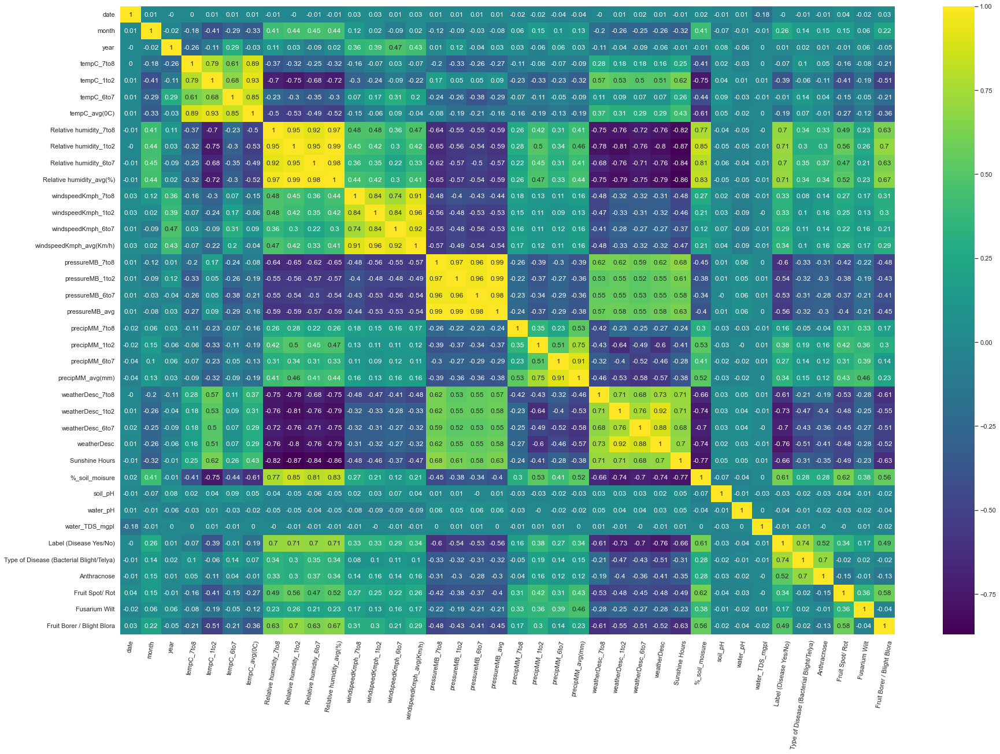

In [6]:
sns.set(rc={'figure.figsize':(30,20)})

# plotting the heatmap
hm = sns.heatmap(data = corr_matrix, annot=True, cmap="viridis" ,fmt='g')
hm.set_xticklabels(labels=list(corr_matrix.columns), rotation=80)

plt.savefig('heatmap_corr_matrix.png', dpi=200, pad_inches=0.15)

# displaying the plotted heatmap
plt.show()

# Pairplot w.r.t. Y

In [7]:
# sns.set(rc={'figure.figsize':(26,18)})

# sns.pairplot(df, hue='Label (Disease Yes/No)', height=1)

# plt.show()

In [8]:
# df1 = df.iloc[:,:5]

# sns.set(rc={'figure.figsize':(26,18)})

# sns.pairplot(df1, hue='month', height=1.5)

# plt.show()

# Find relation between features

# Feature Selection- Dropping constant features

> # a b c d 
> # 23 4 6 7
> # 12 3 6 7
> # 10 2 6 7 

In [9]:
col_list = list(df.select_dtypes(include=['int','float', 'category'])) # 'category',
col_list[:-6] # nat taking dependent variable

['date',
 'month',
 'year',
 'tempC_7to8',
 'tempC_1to2',
 'tempC_6to7',
 'tempC_avg(0C)',
 'Relative humidity_7to8',
 'Relative humidity_1to2',
 'Relative humidity_6to7',
 'Relative humidity_avg(%)',
 'windspeedKmph_7to8',
 'windspeedKmph_1to2',
 'windspeedKmph_6to7',
 'windspeedKmph_avg(Km/h)',
 'pressureMB_7to8',
 'pressureMB_1to2',
 'pressureMB_6to7',
 'pressureMB_avg',
 'precipMM_7to8',
 'precipMM_1to2',
 'precipMM_6to7',
 'precipMM_avg(mm)',
 'weatherDesc_7to8',
 'weatherDesc_1to2',
 'weatherDesc_6to7',
 'weatherDesc',
 'Sunshine Hours',
 '%_soil_moisure',
 'soil_pH',
 'water_pH',
 'water_TDS_mgpl']

In [9]:
df1 = df[col_list[:-6]]
df1

NameError: name 'col_list' is not defined

In [11]:
from sklearn.feature_selection import VarianceThreshold
var_thres=VarianceThreshold(threshold=(.8 * (1 - .8))) # It will zero variance features, 0.1
var_thres.fit(df1)

VarianceThreshold(threshold=0.15999999999999998)

In [12]:
var_thres.get_support()

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True, False, False,  True, False,  True,  True,  True,  True,
        True,  True, False,  True,  True])

In [13]:
### Finding non-constant features
sum(var_thres.get_support())

28

In [14]:
# Lets Find non-constant features 
len(df1.columns[var_thres.get_support()])

28

In [15]:
# Lets Find constant features 
constant_columns = [column for column in df1.columns if column not in df1.columns[var_thres.get_support()]]
print(len(constant_columns))

4


In [16]:
# Lets Find constant features 
for column in constant_columns:
    print(column)

precipMM_7to8
precipMM_1to2
precipMM_avg(mm)
soil_pH


Correlation between Label (Disease Yes/No) and precipMM_7to8 is : 0.1584285054900719


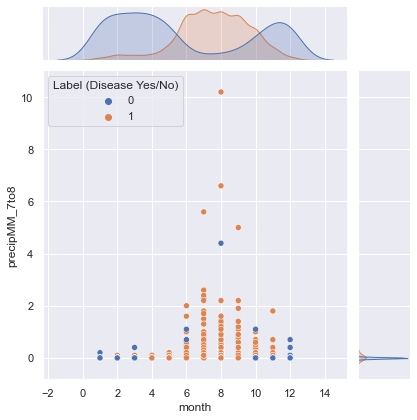

Correlation between Label (Disease Yes/No) and precipMM_1to2 is : 0.37915658987652084


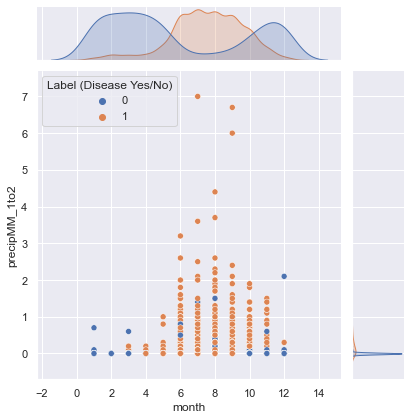

Correlation between Label (Disease Yes/No) and precipMM_avg(mm) is : 0.34403760546232753


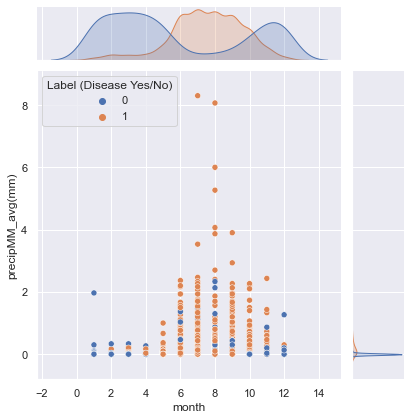

Correlation between Label (Disease Yes/No) and soil_pH is : -0.03214731357571692


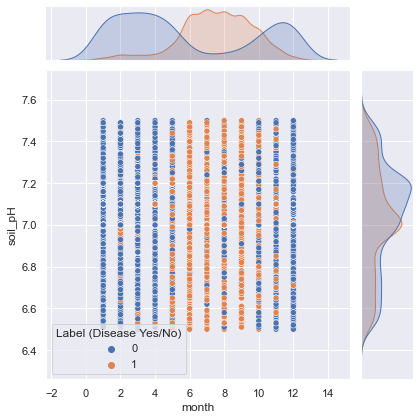

In [17]:
sns.set(rc={'figure.figsize':(30,20)})

for column in constant_columns:
    print(f'Correlation between Label (Disease Yes/No) and {column} is : {df["Label (Disease Yes/No)"].corr(df[column])}')
    sns.jointplot(x = df["month"], y = df[column], hue=df['Label (Disease Yes/No)'], kind='scatter')
    plt.show()


In [18]:
# sns.set(rc={'figure.figsize':(16,8)})

# # plotting both distibutions on the same figure
# fig = sns.kdeplot(df['soil_pH'], shade=True, color="r", legend=True)
# fig = sns.kdeplot(df['precipMM_7to8'], shade=True, color="b", legend=True)
# plt.show()

In [19]:
# # correlation between two columns
# df['soil_pH'].corr(df['precipMM_7to8'])

In [20]:
# # Basic correlogram
# sns.pairplot(df)
# sns.plt.show()

# Observation :

- Remove the constant features (precipMM_7to8, precipMM_1to2, precipMM_avg(mm), soil_pH), becouse they both are giving the almost sane info. 

# Feature Selection- With Correlation (pearson correlation)

In [10]:
df.columns

Index(['observation', 'date', 'month', 'year', 'tempC_7to8', 'tempC_1to2',
       'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8',
       'Relative humidity_1to2', 'Relative humidity_6to7',
       'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2',
       'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8',
       'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
       'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
       'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7',
       'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH',
       'water_pH', 'water_TDS_mgpl', 'Label (Disease Yes/No)',
       'Type of Disease (Bacterial Blight/Telya)', 'Anthracnose',
       'Fruit Spot/ Rot', 'Fusarium Wilt', 'Fruit Borer / Blight Blora'],
      dtype='object')

In [11]:
X = df[['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2',
       'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8',
       'Relative humidity_1to2', 'Relative humidity_6to7',
       'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2',
       'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8',
       'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
       'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
       'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7',
       'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH',
       'water_pH', 'water_TDS_mgpl']]
y = df['Label (Disease Yes/No)']

# To check the correlation between columns

- Make data unsupervised dataset (X).
- Check the correlation between each columns set.

In [23]:
X.to_csv('part6\X_data.csv', index=False)
y.to_csv('part6\y_data.csv', index=False)

In [12]:
df_X = pd.read_csv('part6\X_data.csv')
df_y = pd.read_csv('part6\y_data.csv')

In [13]:
df_X

,date,month,year,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,Relative humidity_6to7,...,precipMM_avg(mm),weatherDesc_7to8,weatherDesc_1to2,weatherDesc_6to7,weatherDesc,Sunshine Hours,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl
0,1,1,2010,20,30,20,23,42,33,59,...,0.000000,5,5,5,5,9.8,45,6.91,7.18,1709.0
1,2,1,2010,23,29,23,25,49,40,62,...,0.000000,5,4,4,4,9.8,45,6.77,7.66,1707.0
2,3,1,2010,24,27,21,24,61,50,78,...,0.000000,4,4,4,4,9.8,41,6.76,7.44,1707.0
3,4,1,2010,23,29,20,24,57,30,52,...,0.000000,5,5,5,5,9.8,43,7.10,7.43,1708.0
4,5,1,2010,22,30,21,24,48,34,54,...,0.000000,5,5,5,5,9.8,44,6.53,8.05,1709.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4222,27,11,2021,21,32,27,26,56,35,48,...,0.000000,5,5,5,5,9.7,41,7.17,7.69,1707.0
4223,28,11,2021,21,31,26,26,58,32,40,...,0.000000,5,5,5,5,9.7,42,7.46,8.22,1709.0
4224,29,11,2021,17,26,24,22,49,29,38,...,0.000000,5,5,5,5,9.7,44,7.38,7.92,1709.0
4225,30,11,2021,17,27,22,22,52,41,64,...,0.033333,5,5,3,3,9.6,41,7.01,7.16,1630.2


In [26]:
# df_y

# Unsupervised: Do not use the target variable (Correlation)

- Numerical Input, Numerical Output
    - Pearson’s correlation coefficient (linear)
    - Spearman’s rank coefficient (nonlinear)

- Numerical Input, Categorical Output
    - ANOVA correlation coefficient (linear)
    - Kendall’s rank coefficient (nonlinear)

# Check the correlation between columns.

- main columns : 'date', 'month', 'year', 'tempC', 'Relative humidity', 'windspeedKmph', 'pressureMB', 'precipMM', 'weatherDesc', 'Sunshine Hours','%_soil_moisure', 'soil_pH', 'water_pH', 'water_TDS_mgpl'

In [27]:
X = df[['tempC_avg(0C)', 'Relative humidity_avg(%)', 'windspeedKmph_avg(Km/h)', 
        'pressureMB_avg', 'precipMM_avg(mm)', 'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH', 
        'water_pH', 'water_TDS_mgpl']]
corr_matrix = round(X.corr(),2)
corr_matrix

,tempC_avg(0C),Relative humidity_avg(%),windspeedKmph_avg(Km/h),pressureMB_avg,precipMM_avg(mm),weatherDesc,Sunshine Hours,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl
tempC_avg(0C),1.00,-0.52,-0.04,-0.16,-0.19,0.29,0.43,-0.61,0.05,-0.02,0.00
Relative humidity_avg(%),-0.52,1.00,0.41,-0.59,0.44,-0.79,-0.86,0.83,-0.05,-0.05,-0.01
windspeedKmph_avg(Km/h),-0.04,0.41,1.00,-0.54,0.16,-0.32,-0.47,0.21,0.04,-0.09,-0.01
pressureMB_avg,-0.16,-0.59,-0.54,1.00,-0.38,0.58,0.63,-0.40,0.01,0.06,0.00
precipMM_avg(mm),-0.19,0.44,0.16,-0.38,1.00,-0.57,-0.38,0.52,-0.03,-0.02,0.00
weatherDesc,0.29,-0.79,-0.32,0.58,-0.57,1.00,0.70,-0.74,0.02,0.03,-0.01
Sunshine Hours,0.43,-0.86,-0.47,0.63,-0.38,0.70,1.00,-0.77,0.05,0.05,0.01
%_soil_moisure,-0.61,0.83,0.21,-0.40,0.52,-0.74,-0.77,1.00,-0.07,-0.04,0.00
soil_pH,0.05,-0.05,0.04,0.01,-0.03,0.02,0.05,-0.07,1.00,-0.01,-0.03
water_pH,-0.02,-0.05,-0.09,0.06,-0.02,0.03,0.05,-0.04,-0.01,1.00,0.00


### In statistics, positive correlation describes the relationship between two variables that change together, while an inverse correlation describes the relationship between two variables which change in opposing directions. Inverse correlation is sometimes described as negative correlation.

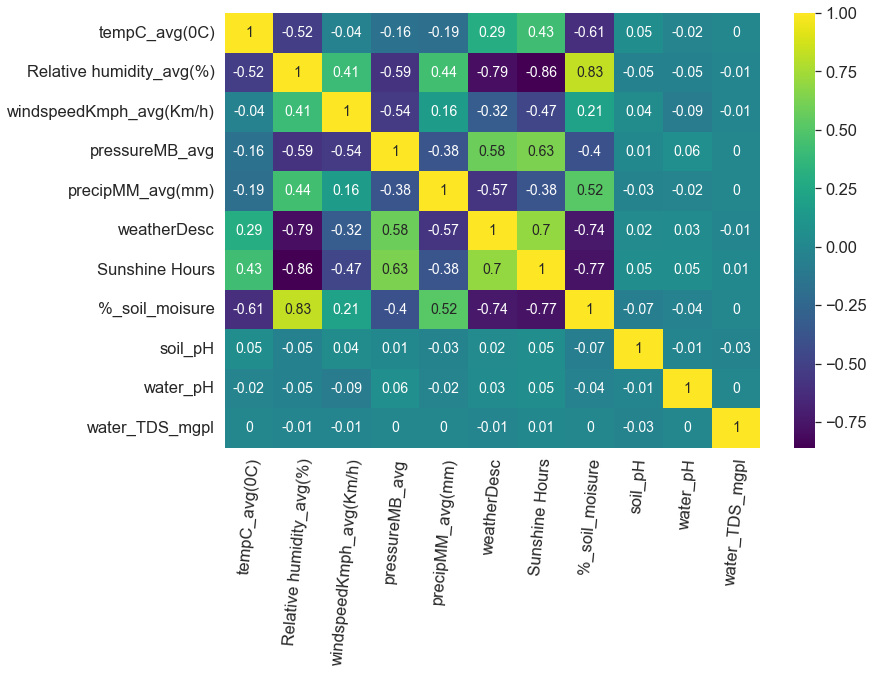

In [28]:
sns.set(rc={'figure.figsize':(12,8)})
sns.set(font_scale=1.5)

# plotting the heatmap
hm = sns.heatmap(data = corr_matrix, annot=True, cmap="viridis" ,fmt='g', annot_kws={"size": 14})
hm.set_xticklabels(labels=list(corr_matrix.columns), rotation=85)

plt.savefig('heatmap_corr_matrix_date_to_temp.png', dpi=200, pad_inches=0.15)

# displaying the plotted heatmap
plt.show()

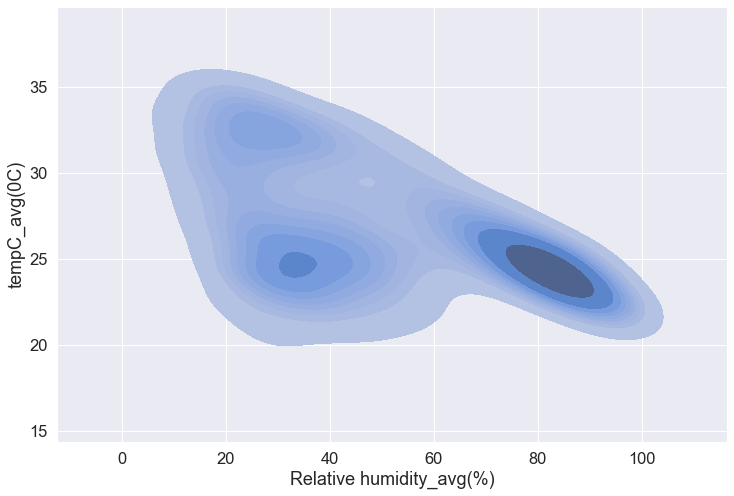

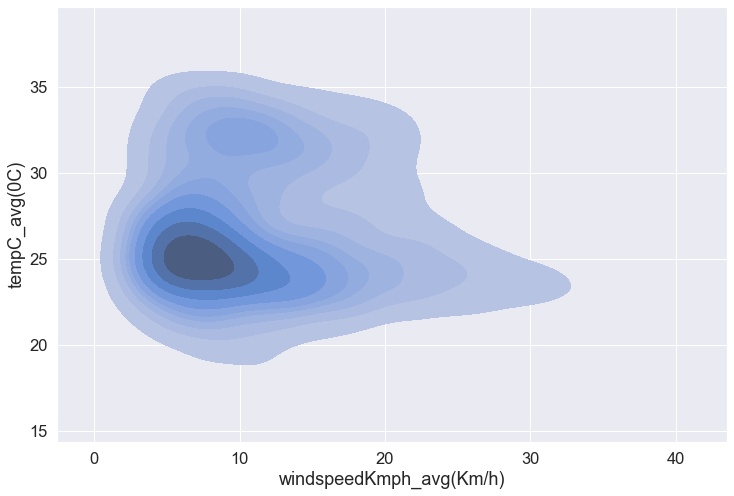

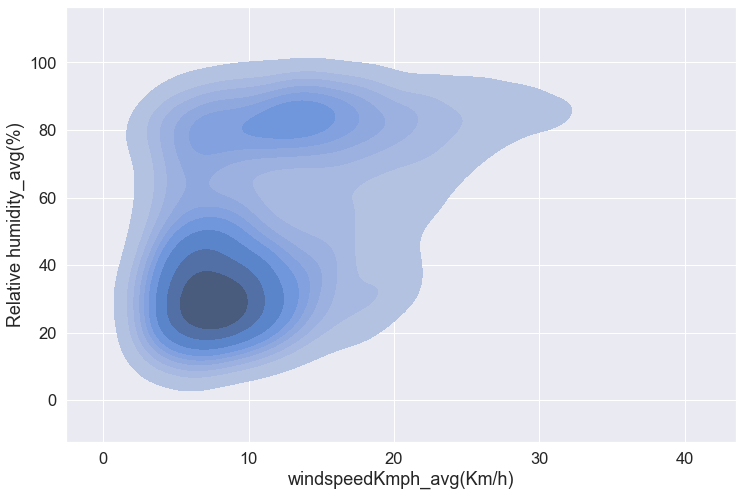

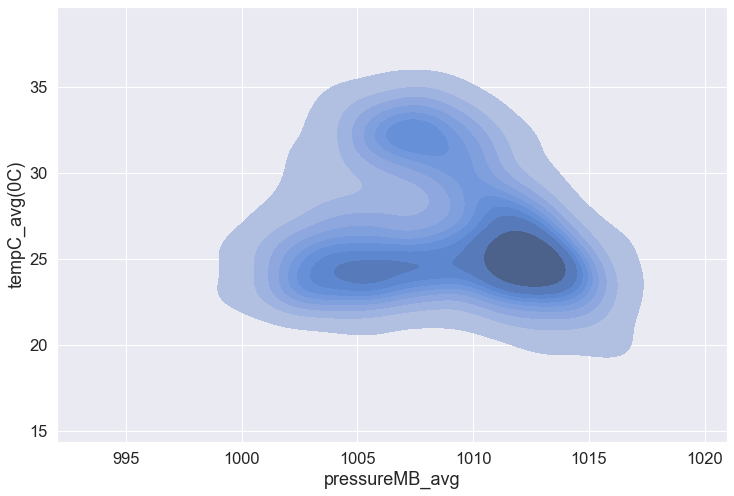

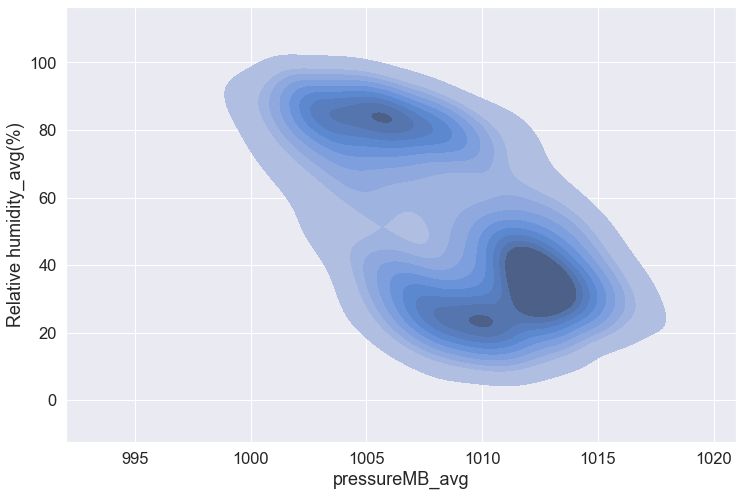

...

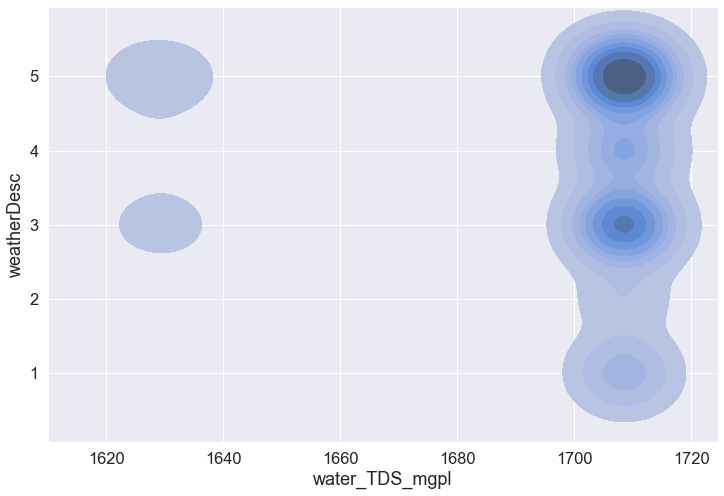

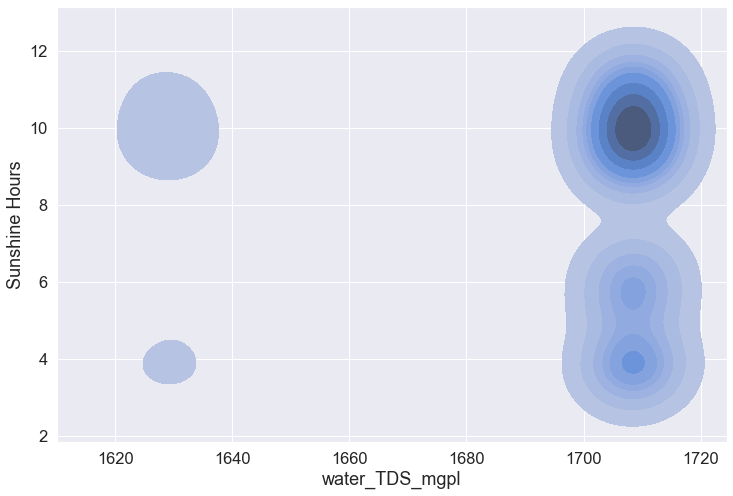

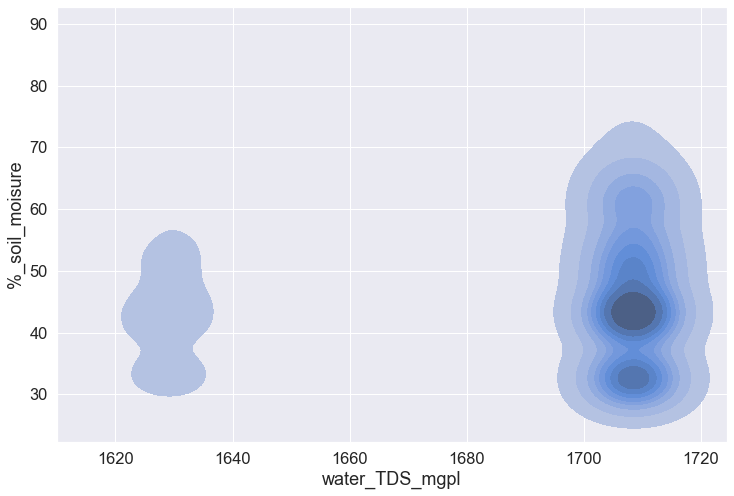

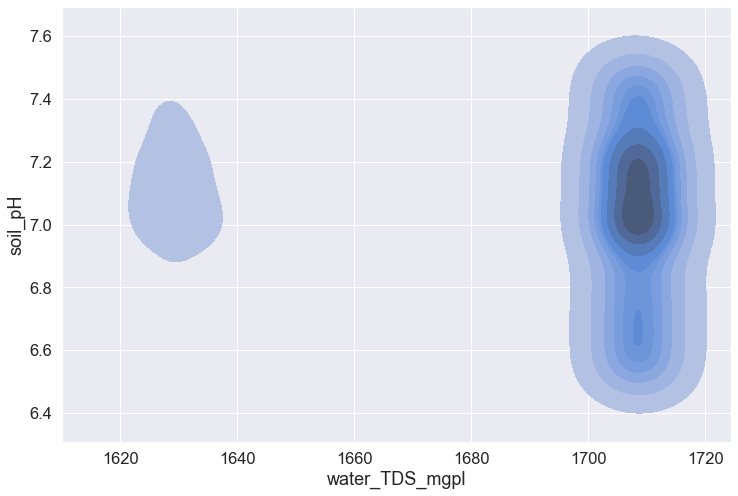

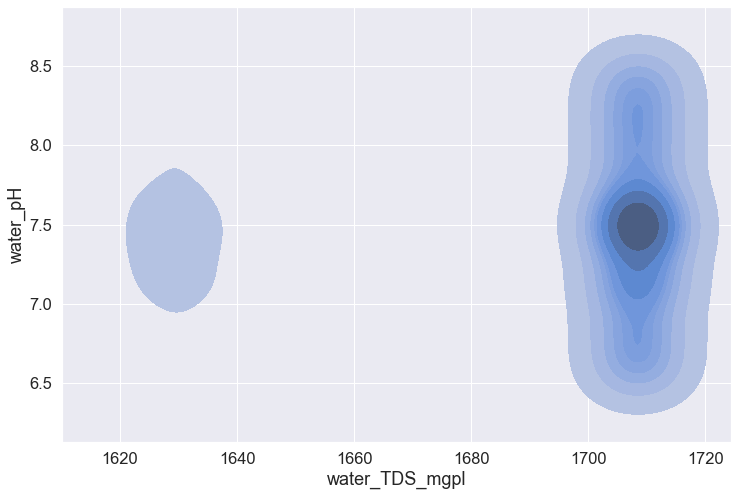

In [29]:
col1 = ['tempC_avg(0C)', 'Relative humidity_avg(%)', 'windspeedKmph_avg(Km/h)', 
        'pressureMB_avg', 'precipMM_avg(mm)', 'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH', 
        'water_pH', 'water_TDS_mgpl']

for i in range(len(col1)):
    for j in range(i):
        fig = sns.kdeplot(X[col1[i]], X[col1[j]], shade=True, color="b")
        plt.show()

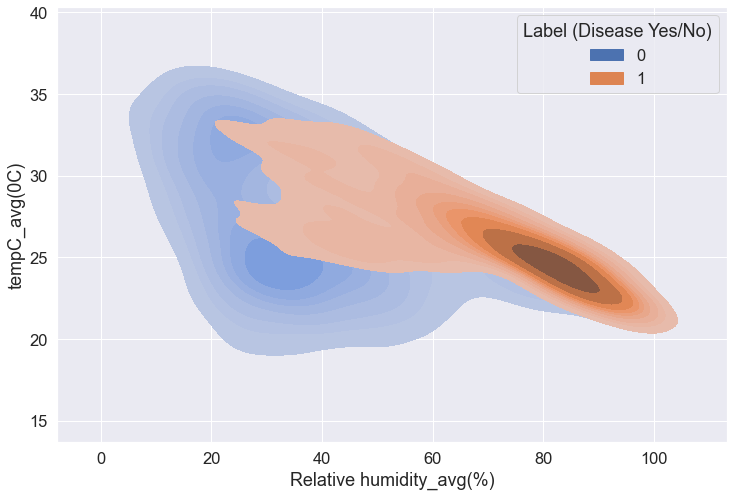

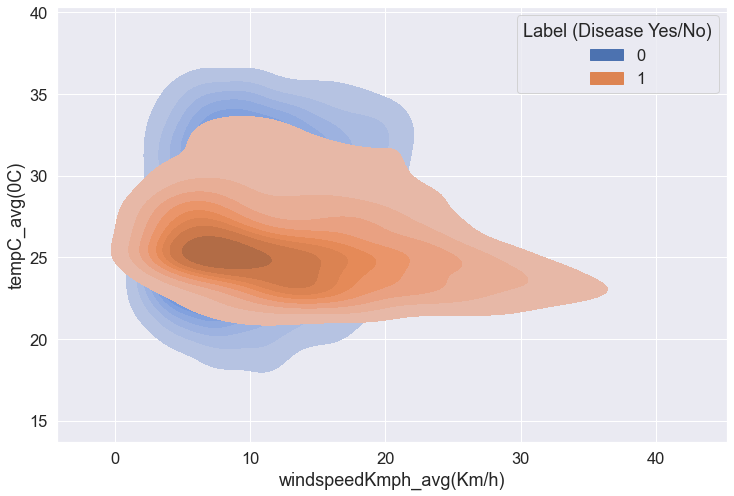

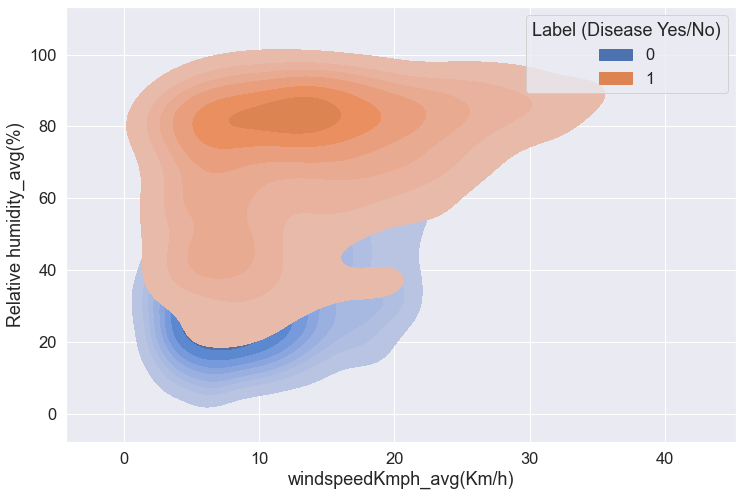

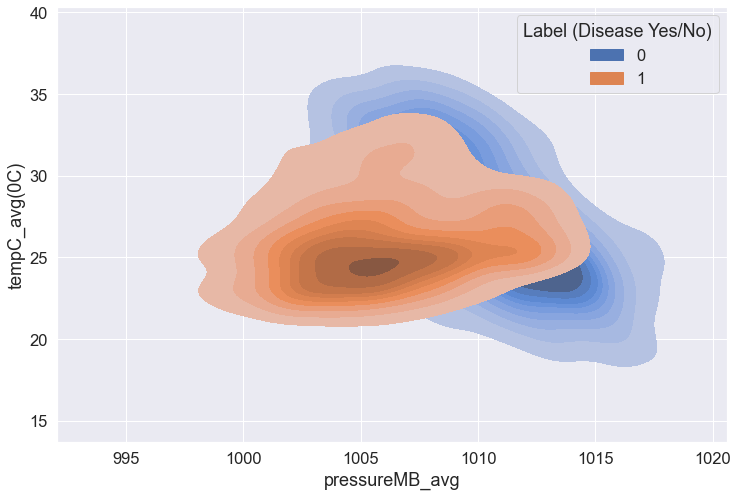

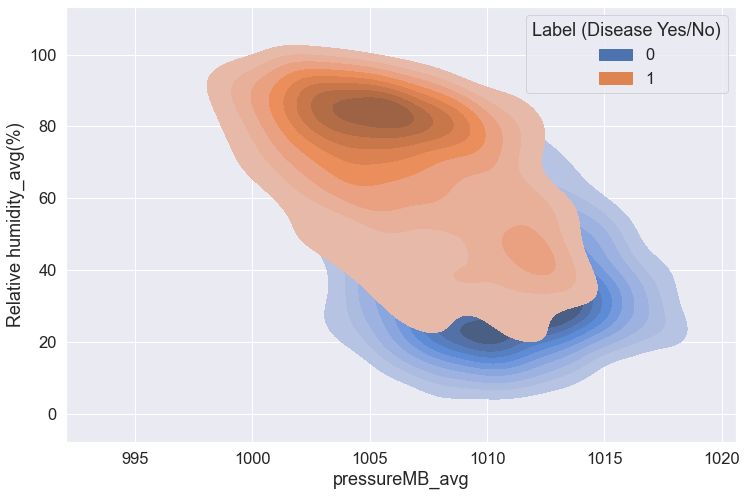

...

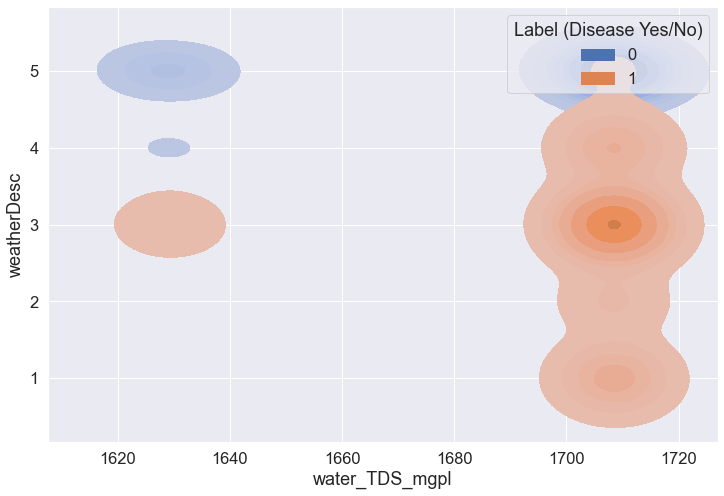

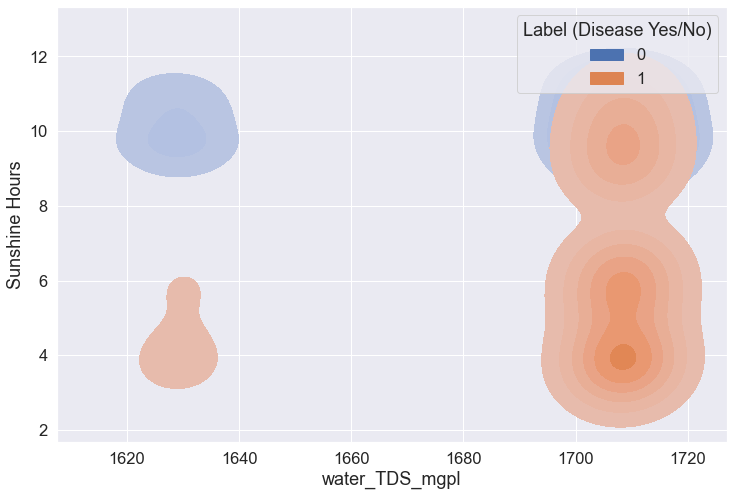

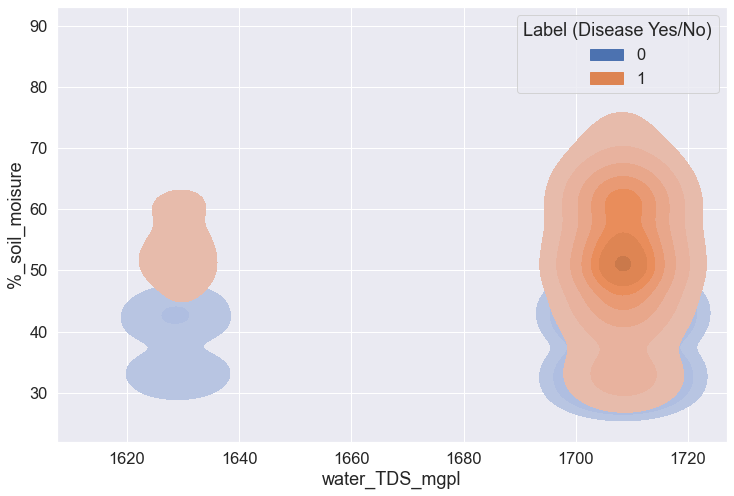

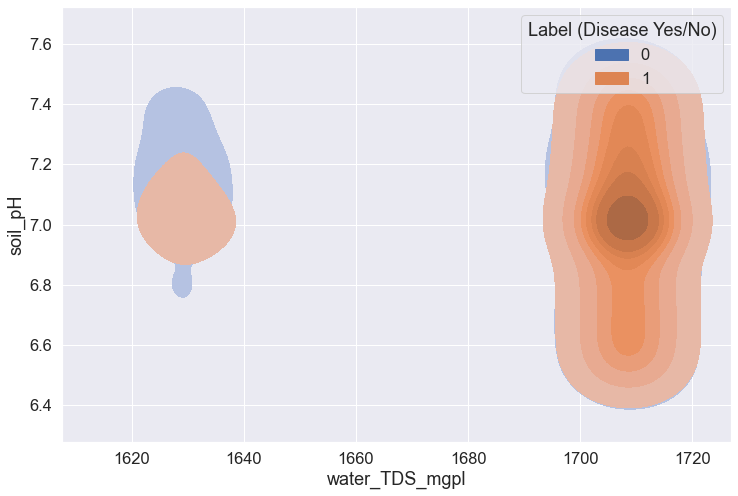

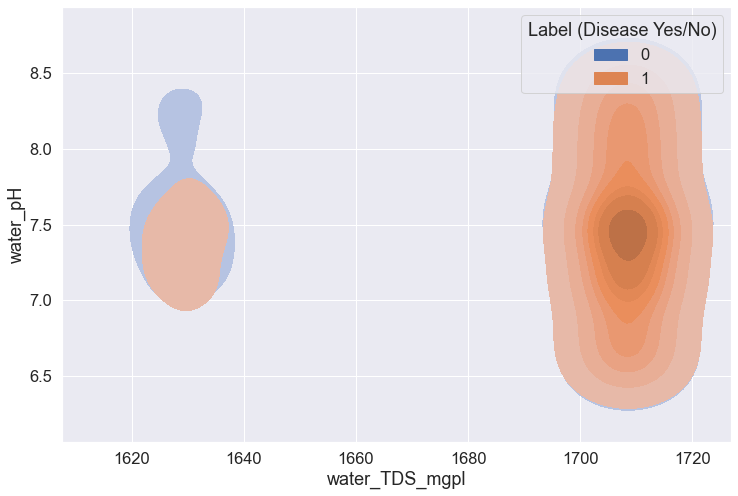

In [30]:

for i in range(len(col1)):
    for j in range(i):
        fig = sns.kdeplot(X[col1[i]], X[col1[j]], shade=True, hue= df['Label (Disease Yes/No)'], color="b")
        plt.show()

In [31]:
# # Basic correlogram
# sns.pairplot(X, kind="reg")
# plt.show()

In [14]:
df

,observation,date,month,year,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,...,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No),Type of Disease (Bacterial Blight/Telya),Anthracnose,Fruit Spot/ Rot,Fusarium Wilt,Fruit Borer / Blight Blora
0,2010-01-01,1,1,2010,20,30,20,23,42,33,...,45,6.91,7.18,1709.0,0,0,0,0,0,0
1,2010-01-02,2,1,2010,23,29,23,25,49,40,...,45,6.77,7.66,1707.0,1,1,1,0,0,0
2,2010-01-03,3,1,2010,24,27,21,24,61,50,...,41,6.76,7.44,1707.0,0,0,0,0,0,0
3,2010-01-04,4,1,2010,23,29,20,24,57,30,...,43,7.10,7.43,1708.0,0,0,0,0,0,0
4,2010-01-05,5,1,2010,22,30,21,24,48,34,...,44,6.53,8.05,1709.0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4222,2021-11-27,27,11,2021,21,32,27,26,56,35,...,41,7.17,7.69,1707.0,1,1,0,0,0,0
4223,2021-11-28,28,11,2021,21,31,26,26,58,32,...,42,7.46,8.22,1709.0,1,1,0,0,0,0
4224,2021-11-29,29,11,2021,17,26,24,22,49,29,...,44,7.38,7.92,1709.0,0,0,0,0,0,0
4225,2021-11-30,30,11,2021,17,27,22,22,52,41,...,41,7.01,7.16,1630.2,0,0,0,0,0,0


# Feature Selection

In [15]:
df1 = df[['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2',
       'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8',
       'Relative humidity_1to2', 'Relative humidity_6to7',
       'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2',
       'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8',
       'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
       'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
       'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7',
       'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH',
       'water_pH', 'water_TDS_mgpl', 'Label (Disease Yes/No)']]

x = df1[['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2',
       'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8',
       'Relative humidity_1to2', 'Relative humidity_6to7',
       'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2',
       'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8',
       'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
       'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
       'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7',
       'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH',
       'water_pH', 'water_TDS_mgpl']]
y = df1[['Label (Disease Yes/No)']]

# Classification Feature Selection

### (Numerical Input, Categorical Output)

In [18]:
!pip install scikit-learn==1.0.2 
from sklearn.feature_selection import SelectKBest, f_classif

ERROR: Could not find a version that satisfies the requirement scikit-learn==1.0.2 (from versions: 0.9, 0.10, 0.11, 0.12, 0.12.1, 0.13, 0.13.1, 0.14, 0.14.1, 0.15.0b1, 0.15.0b2, 0.15.0, 0.15.1, 0.15.2, 0.16b1, 0.16.0, 0.16.1, 0.17b1, 0.17, 0.17.1, 0.18, 0.18.1, 0.18.2, 0.19b2, 0.19.0, 0.19.1, 0.19.2, 0.20rc1, 0.20.0, 0.20.1, 0.20.2, 0.20.3, 0.20.4, 0.21rc2, 0.21.0, 0.21.1, 0.21.2, 0.21.3, 0.22rc2.post1, 0.22rc3, 0.22, 0.22.1, 0.22.2, 0.22.2.post1, 0.23.0rc1, 0.23.0, 0.23.1, 0.23.2, 0.24.dev0, 0.24.0rc1, 0.24.0, 0.24.1, 0.24.2)
ERROR: No matching distribution found for scikit-learn==1.0.2


In [17]:
# define feature selection
fs = SelectKBest(score_func=f_classif, k=10)
fs.fit_transform(x, y)
# print(fs.n_features_in_ , '\n', fs.feature_names_in_ , '\n', fs.scores_ , '\n', fs.pvalues_ )

# apply feature selection
# X_selected = fs.fit_transform(X, y)
# print(X_selected.shape)

c:\users\munge\appdata\local\programs\python\python36\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


AttributeError: 'SelectKBest' object has no attribute 'feature_names_in_'

In [36]:
fs_df = pd.DataFrame()
fs_df['feature_names'] = fs.feature_names_in_
fs_df['feature_scores'] = fs.scores_
fs_df['feature_pvalues'] = fs.pvalues_
fs_df.sort_values('feature_scores', ascending=False).reset_index(drop=True) # ['feature_names'][:11]

,feature_names,feature_scores,feature_pvalues
0,weatherDesc,5792.881468,0.000000e+00
1,weatherDesc_1to2,4725.994975,0.000000e+00
2,Relative humidity_avg(%),4417.289965,0.000000e+00
3,Relative humidity_1to2,4242.326853,0.000000e+00
4,weatherDesc_6to7,4090.705229,0.000000e+00
5,Relative humidity_7to8,4024.902739,0.000000e+00
6,Relative humidity_6to7,3958.603405,0.000000e+00
7,Sunshine Hours,3296.961404,0.000000e+00
8,%_soil_moisure,2454.288293,0.000000e+00
9,weatherDesc_7to8,2444.533860,0.000000e+00


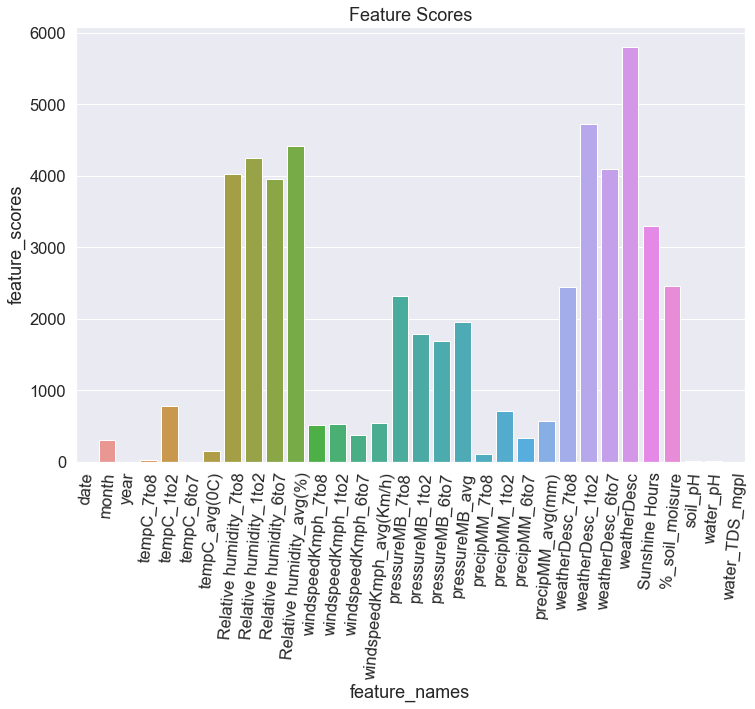

In [37]:
plt.title("Feature Scores")
bar_plot = sns.barplot('feature_names', 'feature_scores', data=fs_df)
bar_plot.set_xticklabels(labels=list(fs_df.feature_names), rotation=85)
plt.show()

In [38]:
fs_df.sort_values('feature_scores', ascending=False).reset_index(drop=True)['feature_names'][:11]

0                  weatherDesc
1             weatherDesc_1to2
2     Relative humidity_avg(%)
3       Relative humidity_1to2
4             weatherDesc_6to7
5       Relative humidity_7to8
6       Relative humidity_6to7
7               Sunshine Hours
8               %_soil_moisure
9             weatherDesc_7to8
10             pressureMB_7to8
Name: feature_names, dtype: object

# Observation :

- Top correlated feature names using  ANOVA F_measure :  `weatherDesc, weatherDesc_1to2, Relative humidity_avg(%), Relative humidity_1to2, weatherDesc_6to7, Relative humidity_7to8, Relative humidity_6to7, Sunshine Hours, %_soil_moisure, weatherDesc_7to8, pressureMB_7to8.` 

- But as per the graph and individual feature set : `month, tempC_1to2, Relative humidity_avg(%), windspeedKmph_avg(Km/h), pressureMB_1to2, precipMM_1to2, weatherDesc, Sunshine Hours, %_soil_moisure.`

# Feature Importance

###  ExtraTreesClassifier 

In [39]:
from sklearn.ensemble import ExtraTreesClassifier

In [40]:
# feature extraction
etc_model = ExtraTreesClassifier(n_estimators=10)
etc_model.fit(x, y)
print(len(etc_model.feature_importances_), '\n', list(fs_df.feature_names), '\n', etc_model.feature_importances_)

32 
 ['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2', 'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8', 'Relative humidity_1to2', 'Relative humidity_6to7', 'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2', 'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8', 'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8', 'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)', 'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7', 'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH', 'water_pH', 'water_TDS_mgpl'] 
 [0.0096289  0.01309537 0.01759035 0.01977645 0.01466331 0.01446517
 0.03124443 0.12969693 0.04556138 0.01379261 0.06192186 0.00930097
 0.00909362 0.00884552 0.00842149 0.02179422 0.01175688 0.01009162
 0.04148131 0.00225971 0.00484669 0.00805273 0.0067723  0.05803483
 0.13691443 0.04405252 0.15609167 0.0177991  0.05167836 0.00873456
 0.0071733  0.0053674 ]


C:\Users\Kiran\AppData\Local\Temp\ipykernel_13264\3035221895.py:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  etc_model.fit(x, y)


In [41]:
fi_df = pd.DataFrame()
fi_df['feature_names'] = list(fs_df.feature_names)
fi_df['feature_importances'] = etc_model.feature_importances_*100
fi_df.sort_values('feature_importances', ascending=False).reset_index(drop=True) # ['feature_names'][:11]

,feature_names,feature_importances
0,weatherDesc,15.609167
1,weatherDesc_1to2,13.691443
2,Relative humidity_7to8,12.969693
3,Relative humidity_avg(%),6.192186
4,weatherDesc_7to8,5.803483
5,%_soil_moisure,5.167836
6,Relative humidity_1to2,4.556138
7,weatherDesc_6to7,4.405252
8,pressureMB_avg,4.148131
9,tempC_avg(0C),3.124443


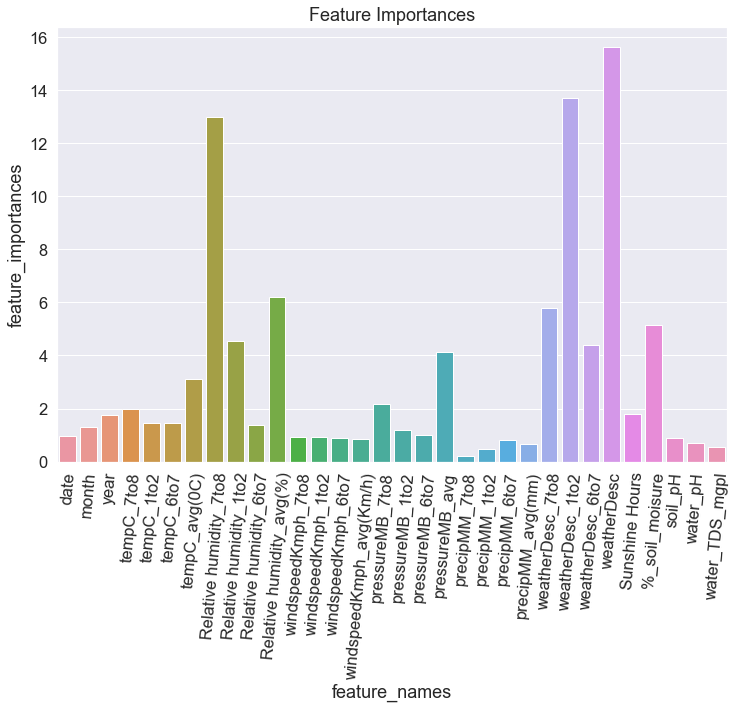

In [42]:
plt.title("Feature Importances")
bar_plot = sns.barplot('feature_names', 'feature_importances', data=fi_df)
bar_plot.set_xticklabels(labels=list(fi_df.feature_names), rotation=85)
plt.show()

In [43]:
fi_df.sort_values('feature_importances', ascending=False).reset_index(drop=True)['feature_names'][:11]

0                  weatherDesc
1             weatherDesc_1to2
2       Relative humidity_7to8
3     Relative humidity_avg(%)
4             weatherDesc_7to8
5               %_soil_moisure
6       Relative humidity_1to2
7             weatherDesc_6to7
8               pressureMB_avg
9                tempC_avg(0C)
10             pressureMB_7to8
Name: feature_names, dtype: object

# Observation :

- Top correlated feature names using  ANOVA F_measure :  `'weatherDesc', 'weatherDesc_1to2', 'weatherDesc_6to7', 'Relative humidity_1to2', 'weatherDesc_7to8', 'precipMM_1to2', 'Relative humidity_avg(%)', 'pressureMB_6to7', 'Sunshine Hours', 'tempC_avg(0C)', 'pressureMB_avg.` 

- But as per the graph and individual feature set : `year, tempC_avg(0C), Relative humidity_1to2, windspeedKmph_avg(Km/h), pressureMB_6to7, precipMM_1to2, weatherDesc, Sunshine Hours, %_soil_moisure, soil_pH, water_pH, water_TDS_mgpl.`

# Recursive Feature Elimination (RFE)


In [53]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier  
from sklearn.ensemble import RandomForestClassifier  

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [45]:
# feature extraction
model = LogisticRegression(solver='lbfgs')
rfe = RFE(estimator=model, n_features_to_select=10, step=1)
fit = rfe.fit(x, y)
print("Num Features: %d" % fit.n_features_)
print("Selected Features: %s" % fit.support_)
print("Feature Ranking: %s" % fit.ranking_)
fit.classes_, fit.n_features_, fit.support_, fit.ranking_, fit.estimator_, fit.feature_names_in_

c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a

c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a

c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status

Num Features: 10
Selected Features: [False False  True False False  True  True False False False  True False
 False False False False False False  True  True False False False  True
  True  True  True False False False False False]
Feature Ranking: [23  4  1  6 11  1  1  9 14  7  1 10 12 20 13  5 21  3  1  1 16 15 22  1
  1  1  1  8  2 19 18 17]


c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


(array([0, 1], dtype=int64),
 10,
 array([False, False,  True, False, False,  True,  True, False, False,
        False,  True, False, False, False, False, False, False, False,
         True,  True, False, False, False,  True,  True,  True,  True,
        False, False, False, False, False]),
 array([23,  4,  1,  6, 11,  1,  1,  9, 14,  7,  1, 10, 12, 20, 13,  5, 21,
         3,  1,  1, 16, 15, 22,  1,  1,  1,  1,  8,  2, 19, 18, 17]),
 LogisticRegression(),
 array(['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2', 'tempC_6to7',
        'tempC_avg(0C)', 'Relative humidity_7to8',
        'Relative humidity_1to2', 'Relative humidity_6to7',
        'Relative humidity_avg(%)', 'windspeedKmph_7to8',
        'windspeedKmph_1to2', 'windspeedKmph_6to7',
        'windspeedKmph_avg(Km/h)', 'pressureMB_7to8', 'pressureMB_1to2',
        'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
        'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
        'weatherDesc_7to8', 'weatherDesc_1to2'

In [46]:
rfe_df = pd.DataFrame()
rfe_df['feature_names'] = list(fs_df.feature_names)
rfe_df['feature_support'] = fit.support_
rfe_df['feature_ranking'] = fit.ranking_
rfe_df.sort_values('feature_ranking', ascending=True).reset_index(drop=True) # ['feature_names'][:11]

,feature_names,feature_support,feature_ranking
0,weatherDesc_1to2,True,1
1,year,True,1
2,weatherDesc_6to7,True,1
3,precipMM_7to8,True,1
4,tempC_6to7,True,1
5,tempC_avg(0C),True,1
6,pressureMB_avg,True,1
7,weatherDesc,True,1
8,Relative humidity_avg(%),True,1
9,weatherDesc_7to8,True,1


In [47]:
rfe_df.sort_values('feature_ranking', ascending=True).reset_index(drop=True)['feature_names'][:11]

0             weatherDesc_1to2
1                         year
2             weatherDesc_6to7
3                precipMM_7to8
4                   tempC_6to7
5                tempC_avg(0C)
6               pressureMB_avg
7                  weatherDesc
8     Relative humidity_avg(%)
9             weatherDesc_7to8
10              %_soil_moisure
Name: feature_names, dtype: object

In [50]:
# feature extraction
model = DecisionTreeClassifier(criterion='entropy', random_state=101)  
rfe = RFE(estimator=model, n_features_to_select=10, step=1)
fit = rfe.fit(x, y)
print("Num Features: %d" % fit.n_features_)
print("Selected Features: %s" % fit.support_)
print("Feature Ranking: %s" % fit.ranking_)
fit.classes_, fit.n_features_, fit.support_, fit.ranking_, fit.estimator_, fit.feature_names_in_

Num Features: 10
Selected Features: [ True False  True False False False  True False False  True  True  True
 False False False False False False False False False False False False
  True False  True  True  True False False False]
Feature Ranking: [ 1  8  1 16  7  9  1  5  3  1  1  1 11  4 20 23  6 15 17 18 14 12 22 19
  1  2  1  1  1 21 10 13]


(array([0, 1], dtype=int64),
 10,
 array([ True, False,  True, False, False, False,  True, False, False,
         True,  True,  True, False, False, False, False, False, False,
        False, False, False, False, False, False,  True, False,  True,
         True,  True, False, False, False]),
 array([ 1,  8,  1, 16,  7,  9,  1,  5,  3,  1,  1,  1, 11,  4, 20, 23,  6,
        15, 17, 18, 14, 12, 22, 19,  1,  2,  1,  1,  1, 21, 10, 13]),
 DecisionTreeClassifier(criterion='entropy', random_state=101),
 array(['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2', 'tempC_6to7',
        'tempC_avg(0C)', 'Relative humidity_7to8',
        'Relative humidity_1to2', 'Relative humidity_6to7',
        'Relative humidity_avg(%)', 'windspeedKmph_7to8',
        'windspeedKmph_1to2', 'windspeedKmph_6to7',
        'windspeedKmph_avg(Km/h)', 'pressureMB_7to8', 'pressureMB_1to2',
        'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
        'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
     

In [51]:
rfe_df = pd.DataFrame()
rfe_df['feature_names'] = list(fs_df.feature_names)
rfe_df['feature_support'] = fit.support_
rfe_df['feature_ranking'] = fit.ranking_
rfe_df.sort_values('feature_ranking', ascending=True).reset_index(drop=True) # ['feature_names'][:11]

,feature_names,feature_support,feature_ranking
0,date,True,1
1,weatherDesc,True,1
2,Sunshine Hours,True,1
3,windspeedKmph_7to8,True,1
4,weatherDesc_1to2,True,1
5,Relative humidity_6to7,True,1
6,Relative humidity_avg(%),True,1
7,%_soil_moisure,True,1
8,year,True,1
9,tempC_avg(0C),True,1


In [54]:
# feature extraction
model = RandomForestClassifier(n_estimators= 10, criterion="entropy")  
rfe = RFE(estimator=model, n_features_to_select=10, step=1)
fit = rfe.fit(x, y)
print("Num Features: %d" % fit.n_features_)
print("Selected Features: %s" % fit.support_)
print("Feature Ranking: %s" % fit.ranking_)
fit.classes_, fit.n_features_, fit.support_, fit.ranking_, fit.estimator_, fit.feature_names_in_

c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\feature_selection\_rfe.py:283: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\feature_selection\_rfe.py:283: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\feature_selection\_rfe.py:283: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
c:\users\kiran\appdata\local\programs\python\python38\l

Num Features: 10
Selected Features: [False False  True False  True False  True  True  True  True  True False
 False False False False False False False False False False False False
  True  True  True False False False False False]
Feature Ranking: [12 16  1  7  1  5  1  1  1  1  1 18 10 11  6 17  4 15  9 23 21 20  2 19
  1  1  1  3  8 14 13 22]


c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\feature_selection\_rfe.py:283: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\feature_selection\_rfe.py:283: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
c:\users\kiran\appdata\local\programs\python\python38\lib\site-packages\sklearn\feature_selection\_rfe.py:283: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
c:\users\kiran\appdata\local\programs\python\python38\l

(array([0, 1], dtype=int64),
 10,
 array([False, False,  True, False,  True, False,  True,  True,  True,
         True,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False,  True,  True,  True,
        False, False, False, False, False]),
 array([12, 16,  1,  7,  1,  5,  1,  1,  1,  1,  1, 18, 10, 11,  6, 17,  4,
        15,  9, 23, 21, 20,  2, 19,  1,  1,  1,  3,  8, 14, 13, 22]),
 RandomForestClassifier(criterion='entropy', n_estimators=10),
 array(['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2', 'tempC_6to7',
        'tempC_avg(0C)', 'Relative humidity_7to8',
        'Relative humidity_1to2', 'Relative humidity_6to7',
        'Relative humidity_avg(%)', 'windspeedKmph_7to8',
        'windspeedKmph_1to2', 'windspeedKmph_6to7',
        'windspeedKmph_avg(Km/h)', 'pressureMB_7to8', 'pressureMB_1to2',
        'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
        'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
      

In [55]:
rfe_df = pd.DataFrame()
rfe_df['feature_names'] = list(fs_df.feature_names)
rfe_df['feature_support'] = fit.support_
rfe_df['feature_ranking'] = fit.ranking_
rfe_df.sort_values('feature_ranking', ascending=True).reset_index(drop=True) # ['feature_names'][:11]

,feature_names,feature_support,feature_ranking
0,weatherDesc_1to2,True,1
1,weatherDesc_6to7,True,1
2,weatherDesc,True,1
3,Relative humidity_avg(%),True,1
4,Relative humidity_6to7,True,1
5,Relative humidity_7to8,True,1
6,Relative humidity_1to2,True,1
7,tempC_1to2,True,1
8,year,True,1
9,tempC_avg(0C),True,1


# Find correlation with train_test_split dataset

In [8]:
# separate dataset into train and test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y) # random_state=0,

X_train.shape, X_test.shape

((2958, 32), (1269, 32))

In [9]:
X_train.corr()

,date,month,year,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,Relative humidity_6to7,...,precipMM_avg(mm),weatherDesc_7to8,weatherDesc_1to2,weatherDesc_6to7,weatherDesc,Sunshine Hours,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl
date,1.000000,0.021222,0.004192,0.008017,0.008823,0.007667,0.010757,-0.006524,0.004519,-0.010227,...,-0.038255,-0.005822,-0.000876,0.020081,-0.002564,-0.008938,0.023036,-0.000209,0.006409,-0.189838
month,0.021222,1.000000,-0.023488,-0.164377,-0.409180,-0.270940,-0.321285,0.415304,0.456680,0.466137,...,0.134518,-0.210802,-0.266488,-0.265508,-0.278136,-0.330443,0.418197,-0.072107,-0.006279,-0.009800
year,0.004192,-0.023488,1.000000,-0.254172,-0.104279,0.298611,-0.021828,0.116265,0.038103,-0.082403,...,0.035493,-0.120258,-0.041401,-0.093096,-0.058900,-0.013684,-0.004390,0.088546,-0.055621,0.006927
tempC_7to8,0.008017,-0.164377,-0.254172,1.000000,0.795185,0.609056,0.890596,-0.356274,-0.317323,-0.244936,...,-0.090957,0.275256,0.165612,0.178021,0.152296,0.248185,-0.409010,0.008589,-0.030934,-0.019609
tempC_1to2,0.008823,-0.409180,-0.104279,0.795185,1.000000,0.683554,0.929390,-0.695549,-0.744536,-0.669964,...,-0.306103,0.568842,0.521008,0.497507,0.503869,0.620707,-0.743681,0.039201,0.000919,-0.015728
tempC_6to7,0.007667,-0.270940,0.298611,0.609056,0.683554,1.000000,0.850416,-0.217357,-0.291094,-0.347421,...,-0.084164,0.105878,0.087829,0.069040,0.065807,0.252685,-0.437968,0.088306,-0.030030,-0.023619
tempC_avg(0C),0.010757,-0.321285,-0.021828,0.890596,0.929390,0.850416,1.000000,-0.485579,-0.518556,-0.483564,...,-0.187032,0.365747,0.301351,0.288751,0.281967,0.429276,-0.602013,0.052169,-0.021311,-0.023374
Relative humidity_7to8,-0.006524,0.415304,0.116265,-0.356274,-0.695549,-0.217357,-0.485579,1.000000,0.948345,0.921885,...,0.400112,-0.752019,-0.760351,-0.723532,-0.760860,-0.825947,0.772046,-0.042338,-0.039325,0.016375
Relative humidity_1to2,0.004519,0.456680,0.038103,-0.317323,-0.744536,-0.291094,-0.518556,0.948345,1.000000,0.952083,...,0.451408,-0.777514,-0.806594,-0.762900,-0.799435,-0.870220,0.845706,-0.048345,-0.042906,0.006512
Relative humidity_6to7,-0.010227,0.466137,-0.082403,-0.244936,-0.669964,-0.347421,-0.483564,0.921885,0.952083,1.000000,...,0.400653,-0.679832,-0.756418,-0.714908,-0.758791,-0.836857,0.806435,-0.065967,-0.035312,0.009080


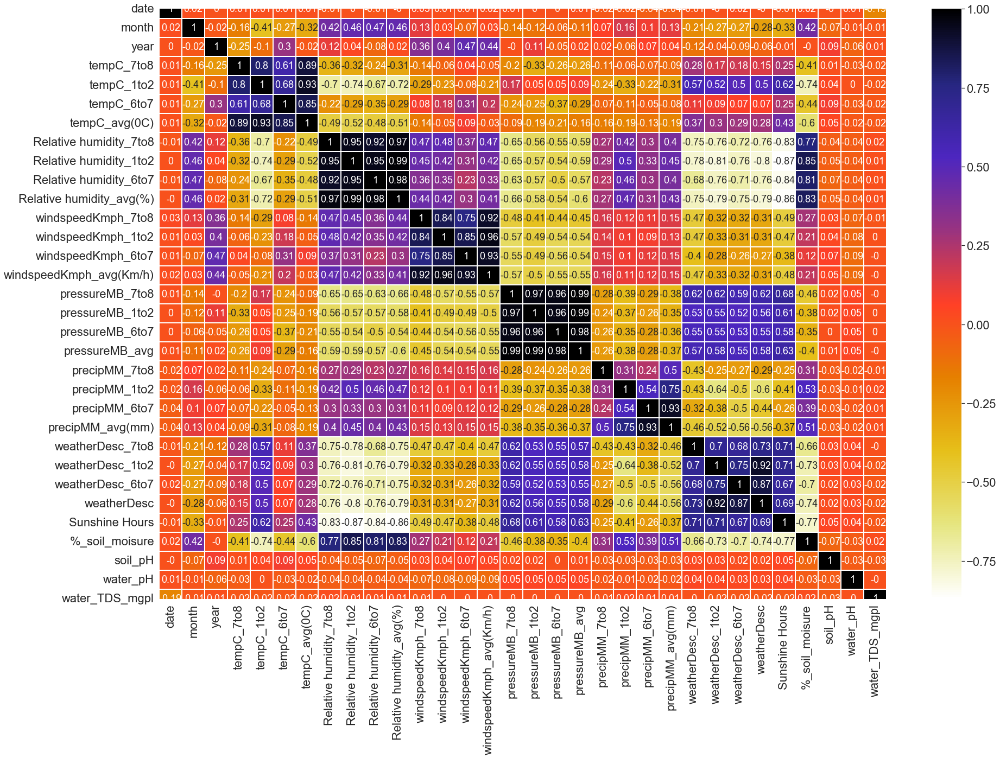

In [10]:
#Using Pearson Correlation
# plt.figure(figsize=(25,20))
sns.set(rc={'figure.figsize':(30,20)})
cor = round(X_train.corr(),2)
sns.set(font_scale=2)

sns.heatmap(cor, annot=True, cmap=plt.cm.CMRmap_r, linewidths=1, linecolor='white',annot_kws={"size": 18})
plt.savefig('heatmap_1.jpeg', dpi=500, bbox_inches='tight', facecolor='grey', edgecolor='blue',)
plt.show()

In [11]:
# with the following function we can select highly correlated features
# it will remove the first feature that is correlated with anything other feature

def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

In [12]:
corr_features = correlation(X_train, 0.85)
len(set(corr_features))

11

In [13]:
corr_features

{'Relative humidity_1to2',
 'Relative humidity_6to7',
 'Relative humidity_avg(%)',
 'Sunshine Hours',
 'precipMM_avg(mm)',
 'pressureMB_1to2',
 'pressureMB_6to7',
 'pressureMB_avg',
 'tempC_avg(0C)',
 'weatherDesc',
 'windspeedKmph_avg(Km/h)'}

# Observation :

- The features with correlation greater than 0.95 are : {'Relative humidity_1to2',
 'Relative humidity_6to7',
 'Relative humidity_avg(%)',
 'Sunshine Hours',
 'precipMM_avg(mm)',
 'pressureMB_1to2',
 'pressureMB_6to7',
 'pressureMB_avg',
 'tempC_avg(0C)',
 'weatherDesc',
 'windspeedKmph_avg(Km/h)'}

# Find correlation between two columns 

In [14]:
df.columns

Index(['observation', 'date', 'month', 'year', 'tempC_7to8', 'tempC_1to2',
       'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8',
       'Relative humidity_1to2', 'Relative humidity_6to7',
       'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2',
       'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8',
       'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
       'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
       'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7',
       'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH',
       'water_pH', 'water_TDS_mgpl', 'Label (Disease Yes/No)',
       'Type of Disease (Bacterial Blight/Telya)', 'Anthracnose',
       'Fruit Spot/ Rot', 'Fusarium Wilt', 'Fruit Borer / Blight Blora'],
      dtype='object')

Correlation between tempC_avg(0C) & tempC_7to8 is : 0.89 % 


Correlation between tempC_avg(0C) & tempC_1to2 is : 0.93 % 


Correlation between Relative humidity_1to2 & Relative humidity_7to8 is : 0.95 % 


Correlation between Relative humidity_6to7 & Relative humidity_7to8 is : 0.92 % 


Correlation between Relative humidity_6to7 & Relative humidity_1to2 is : 0.95 % 


Correlation between Relative humidity_avg(%) & Relative humidity_7to8 is : 0.97 % 


Correlation between Relative humidity_avg(%) & Relative humidity_1to2 is : 0.99 % 


Correlation between Relative humidity_avg(%) & Relative humidity_6to7 is : 0.98 % 


Correlation between windspeedKmph_avg(Km/h) & windspeedKmph_7to8 is : 0.91 % 


Correlation between windspeedKmph_avg(Km/h) & windspeedKmph_1to2 is : 0.96 % 


Correlation between windspeedKmph_avg(Km/h) & windspeedKmph_6to7 is : 0.92 % 


Correlation between pressureMB_1to2 & pressureMB_7to8 is : 0.97 % 


Correlation between pressureMB_6to7 & pressureMB_7to8 is : 0.96

c:\users\munge\appdata\local\programs\python\python36\lib\site-packages\seaborn\axisgrid.py:1670: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))




Correlation between Sunshine Hours & Relative humidity_avg(%) is : -0.86 % 


c:\users\munge\appdata\local\programs\python\python36\lib\site-packages\seaborn\axisgrid.py:1670: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))


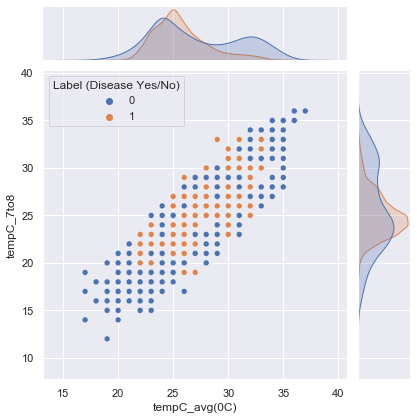

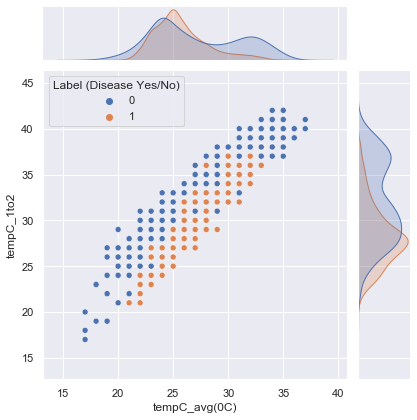

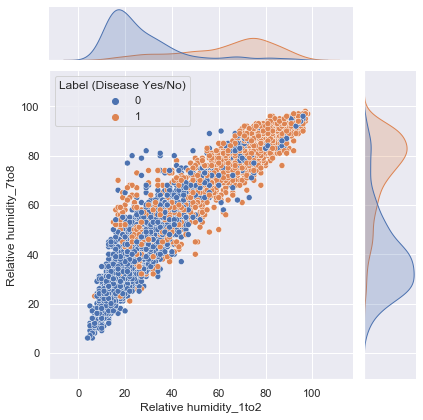

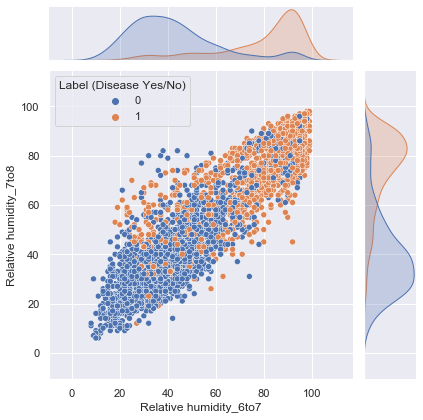

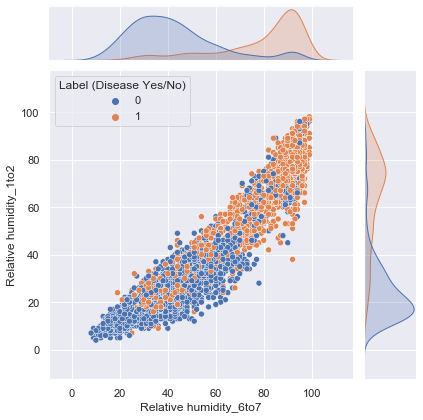

...

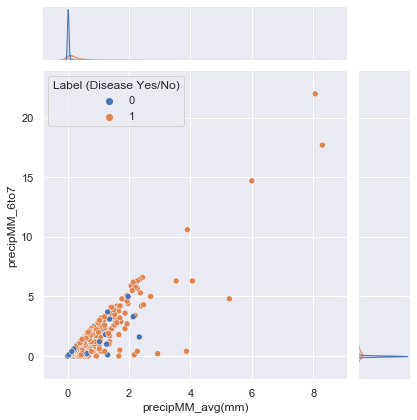

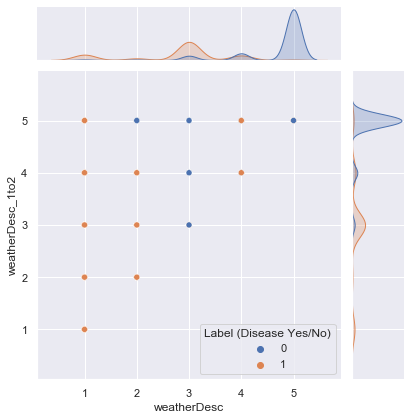

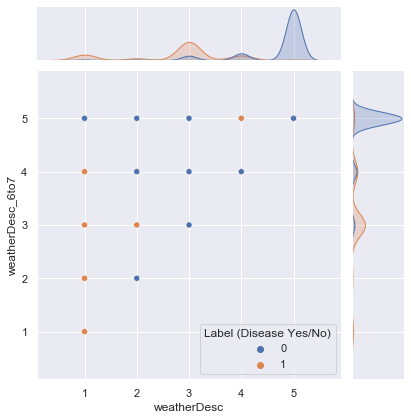

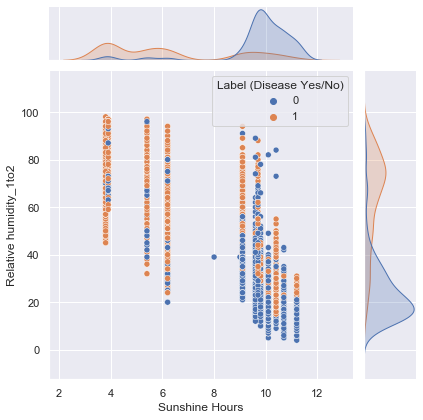

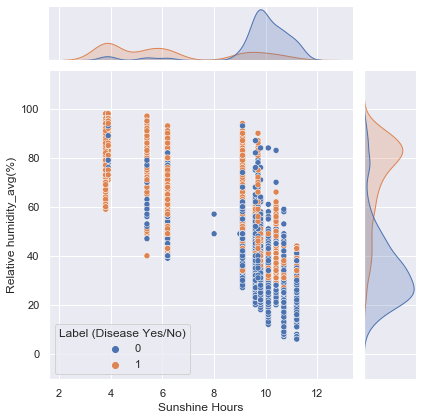

In [49]:
cols = ['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2',
       'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8',
       'Relative humidity_1to2', 'Relative humidity_6to7',
       'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2',
       'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8',
       'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
       'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
       'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7',
       'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH',
       'water_pH', 'water_TDS_mgpl']

for i in range(len(cols)):
    for j in range(i):
        if abs(round(df[cols[i]].corr(df[cols[j]]),2)) > 0.85:
            print(f'Correlation between {cols[i]} & {cols[j]} is : {round(df[cols[i]].corr(df[cols[j]])*100,2)} % ' )
            
            sns.set(rc={'figure.figsize':(30,20)})
            sns.jointplot(x = df[cols[i]], y = df[cols[j]], hue=df['Label (Disease Yes/No)'], kind = 'scatter')
            print('\n')

<Figure size 2160x1440 with 0 Axes>

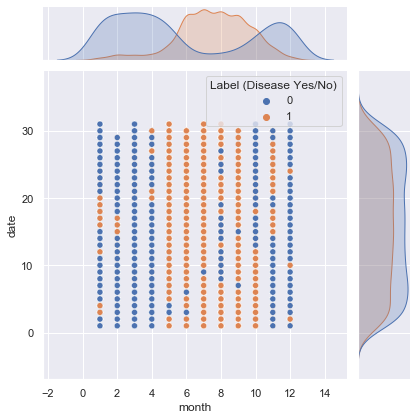

<Figure size 2160x1440 with 0 Axes>

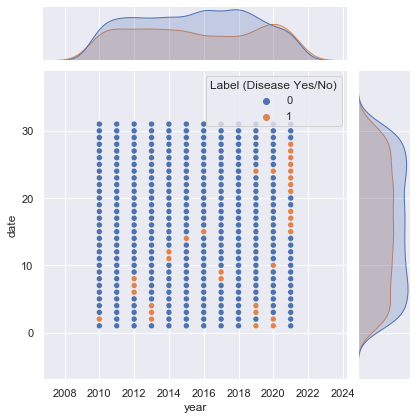

<Figure size 2160x1440 with 0 Axes>

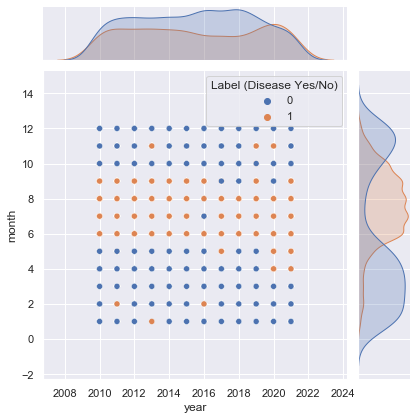

<Figure size 2160x1440 with 0 Axes>

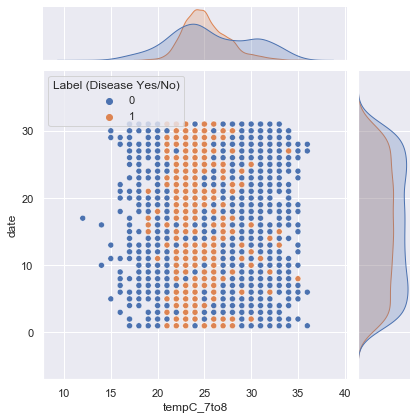

<Figure size 2160x1440 with 0 Axes>

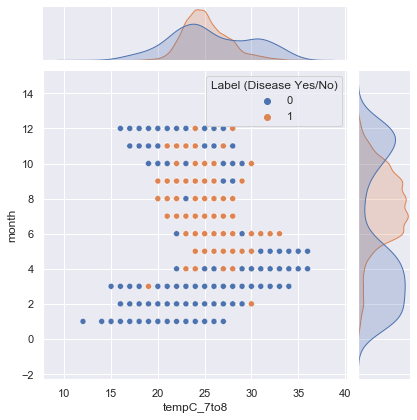

<Figure size 2160x1440 with 0 Axes>

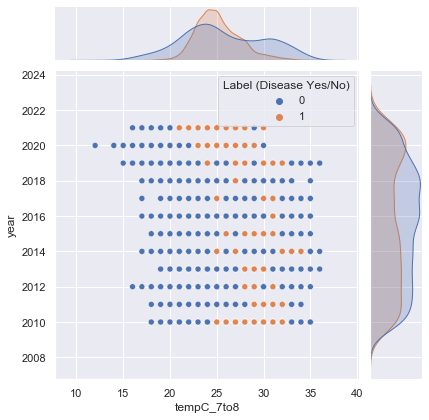

<Figure size 2160x1440 with 0 Axes>

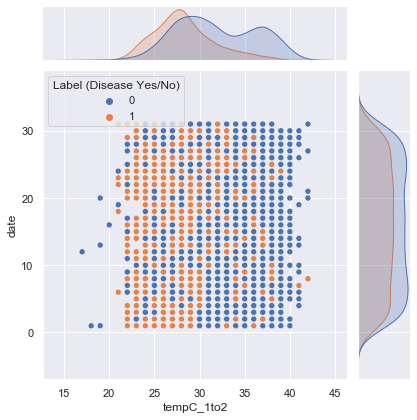

<Figure size 2160x1440 with 0 Axes>

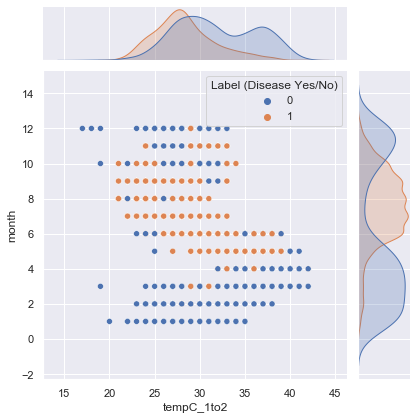

<Figure size 2160x1440 with 0 Axes>

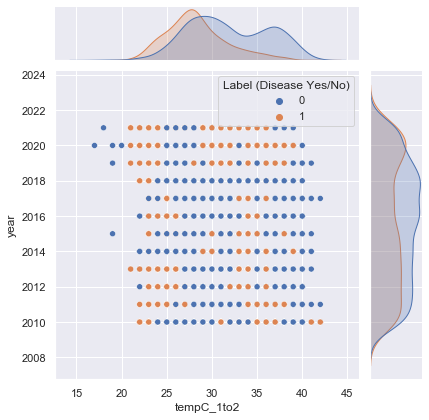

<Figure size 2160x1440 with 0 Axes>

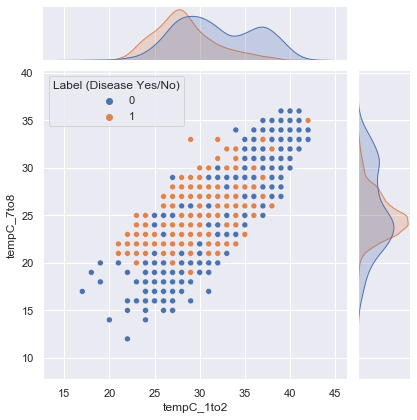

<Figure size 2160x1440 with 0 Axes>

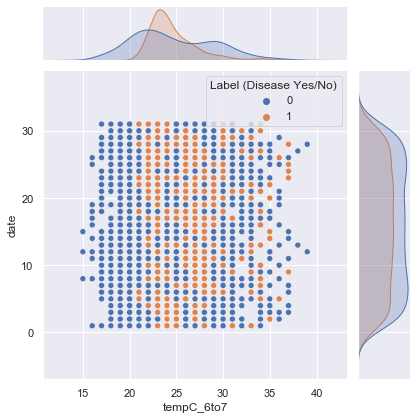

<Figure size 2160x1440 with 0 Axes>

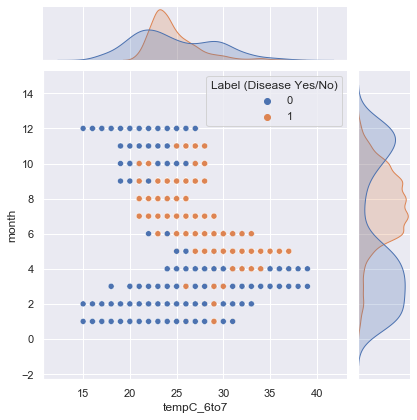

<Figure size 2160x1440 with 0 Axes>

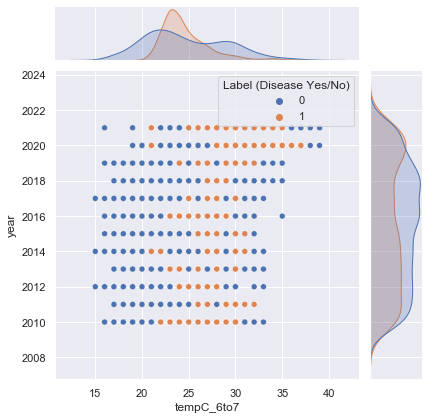

<Figure size 2160x1440 with 0 Axes>

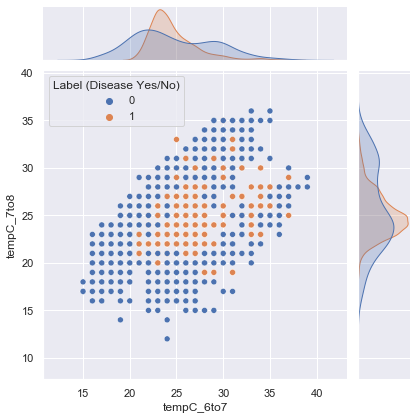

<Figure size 2160x1440 with 0 Axes>

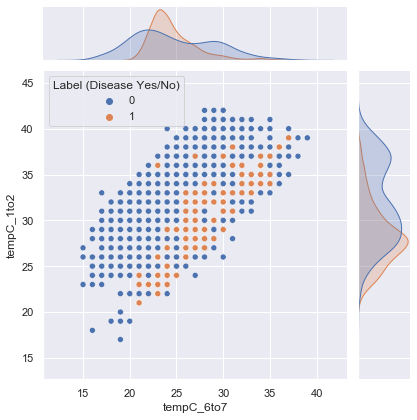

<Figure size 2160x1440 with 0 Axes>

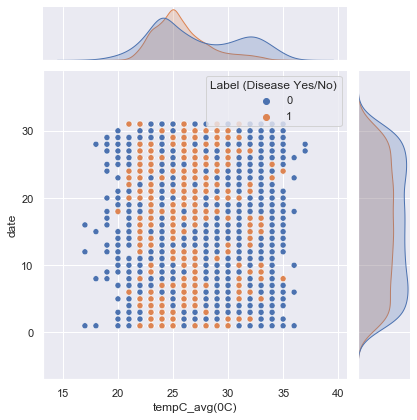

<Figure size 2160x1440 with 0 Axes>

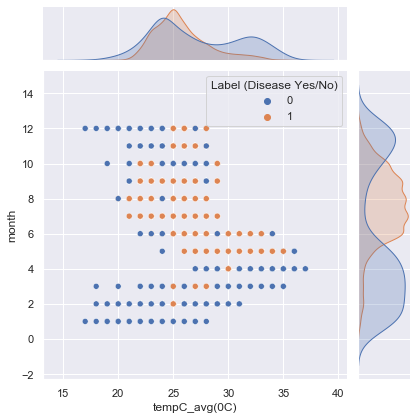

<Figure size 2160x1440 with 0 Axes>

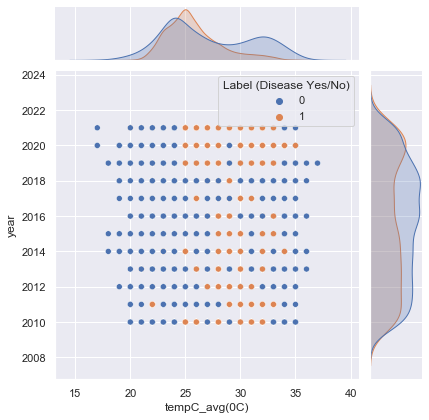

<Figure size 2160x1440 with 0 Axes>

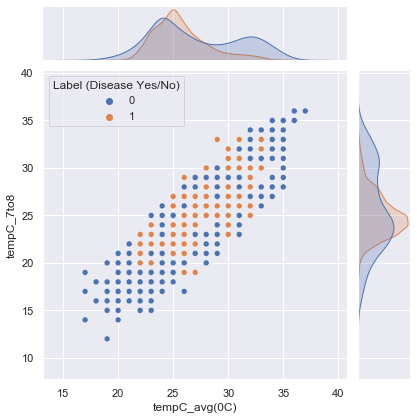

<Figure size 2160x1440 with 0 Axes>

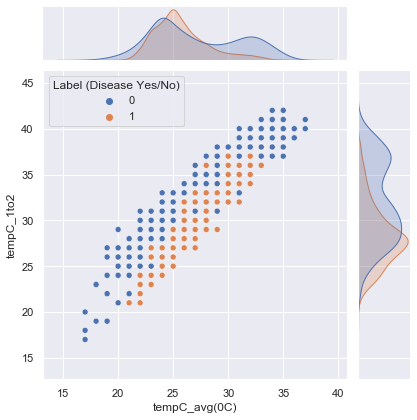

<Figure size 2160x1440 with 0 Axes>

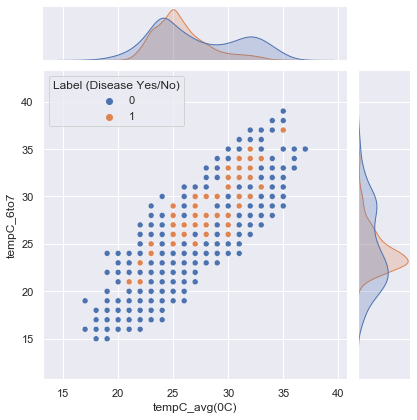

<Figure size 2160x1440 with 0 Axes>

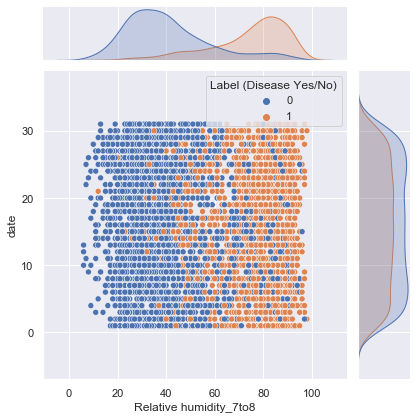

<Figure size 2160x1440 with 0 Axes>

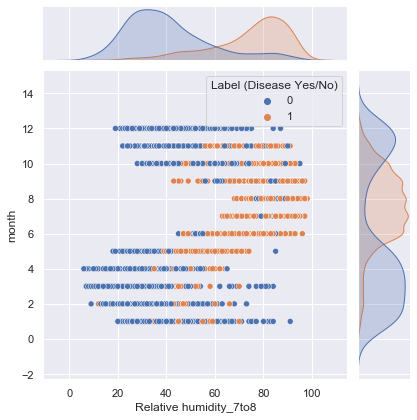

<Figure size 2160x1440 with 0 Axes>

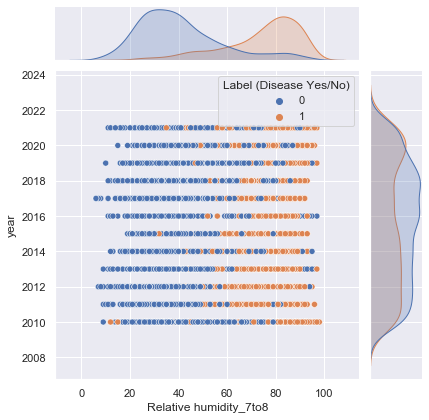

<Figure size 2160x1440 with 0 Axes>

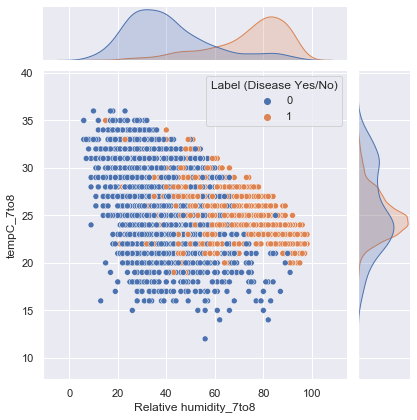

<Figure size 2160x1440 with 0 Axes>

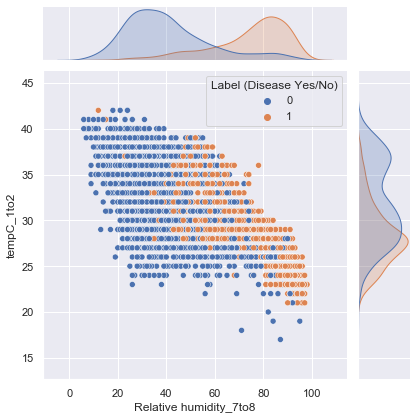

<Figure size 2160x1440 with 0 Axes>

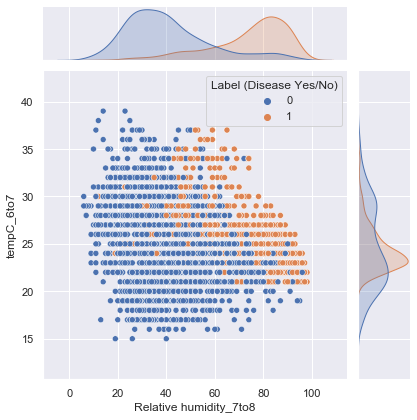

<Figure size 2160x1440 with 0 Axes>

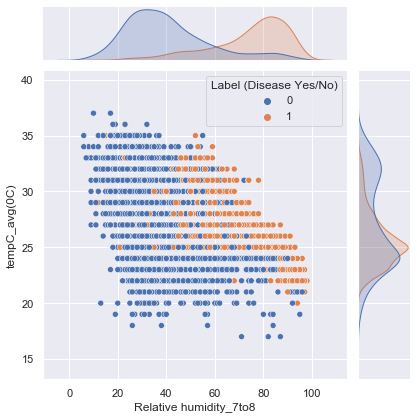

<Figure size 2160x1440 with 0 Axes>

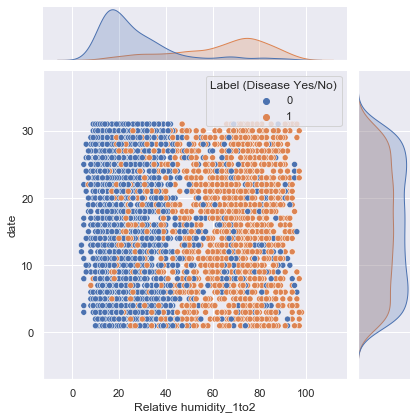

<Figure size 2160x1440 with 0 Axes>

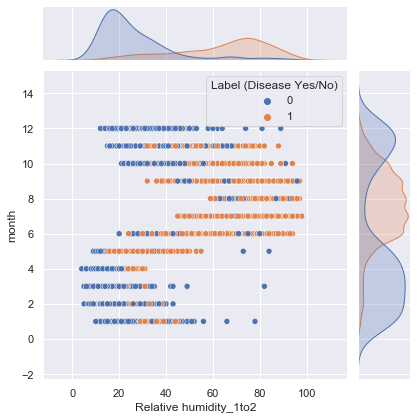

<Figure size 2160x1440 with 0 Axes>

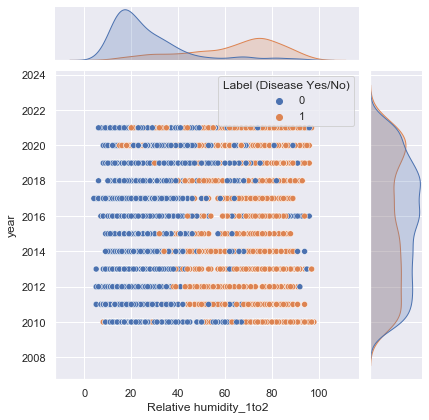

<Figure size 2160x1440 with 0 Axes>

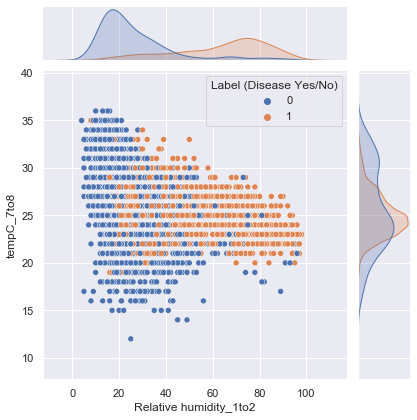

<Figure size 2160x1440 with 0 Axes>

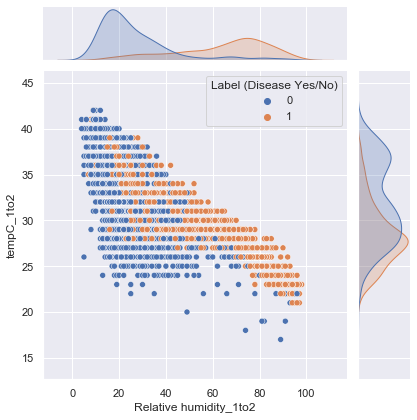

<Figure size 2160x1440 with 0 Axes>

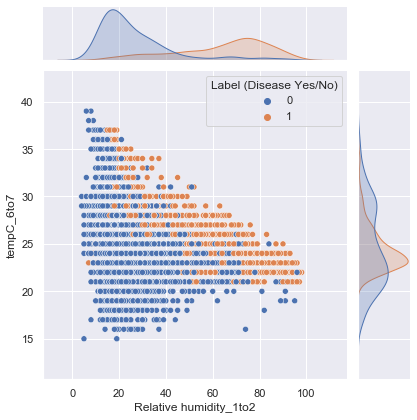

<Figure size 2160x1440 with 0 Axes>

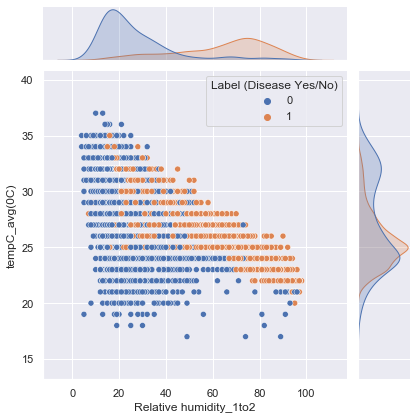

<Figure size 2160x1440 with 0 Axes>

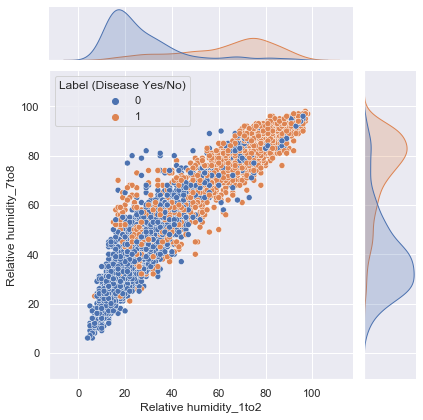

<Figure size 2160x1440 with 0 Axes>

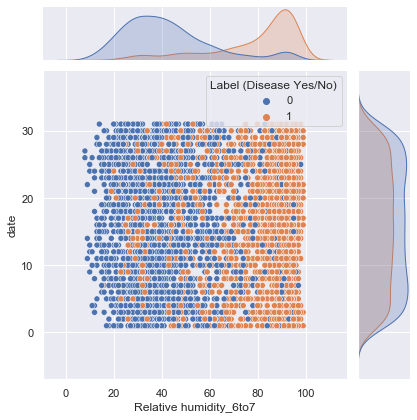

<Figure size 2160x1440 with 0 Axes>

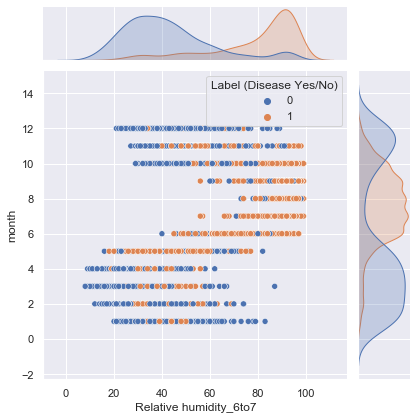

<Figure size 2160x1440 with 0 Axes>

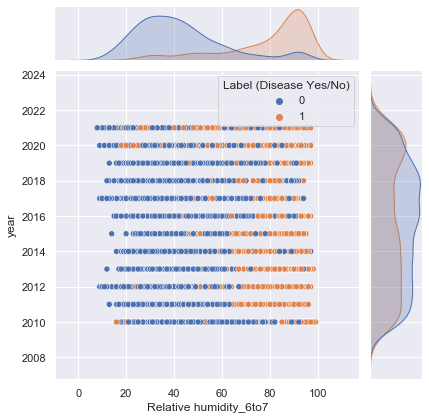

<Figure size 2160x1440 with 0 Axes>

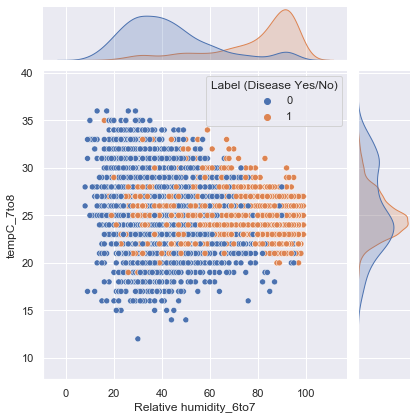

<Figure size 2160x1440 with 0 Axes>

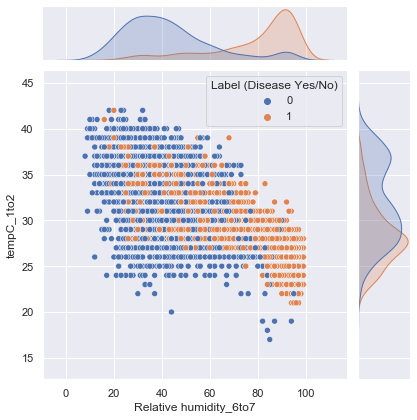

<Figure size 2160x1440 with 0 Axes>

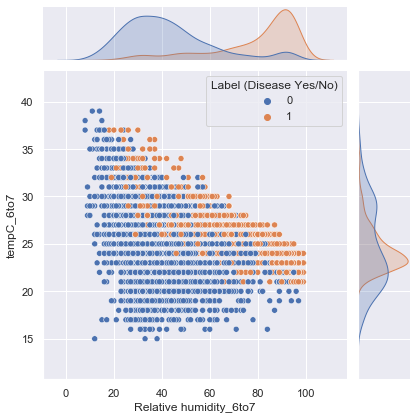

<Figure size 2160x1440 with 0 Axes>

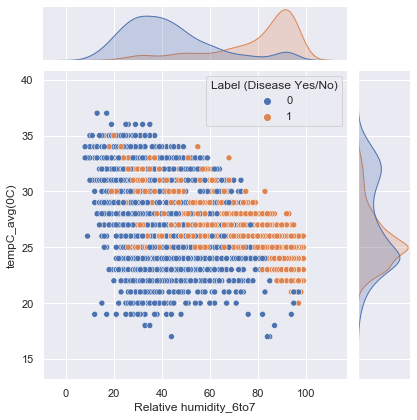

<Figure size 2160x1440 with 0 Axes>

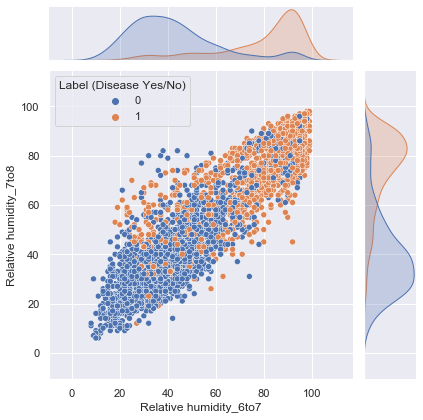

<Figure size 2160x1440 with 0 Axes>

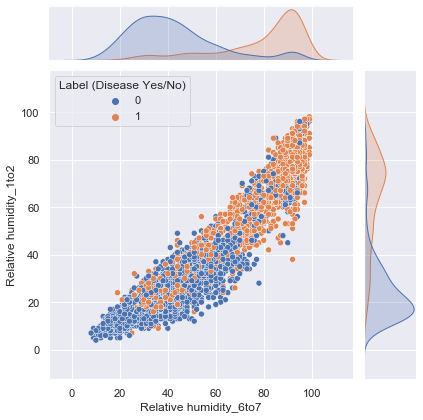

<Figure size 2160x1440 with 0 Axes>

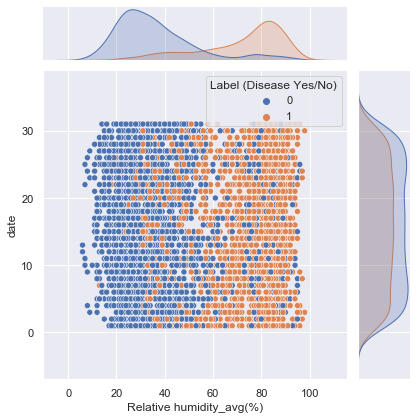

<Figure size 2160x1440 with 0 Axes>

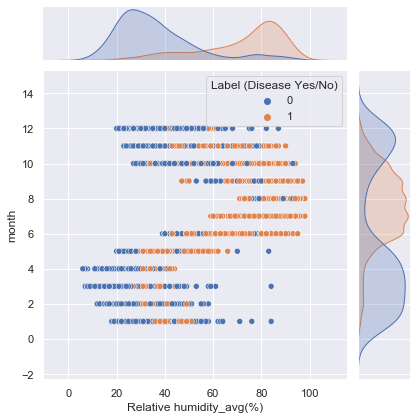

<Figure size 2160x1440 with 0 Axes>

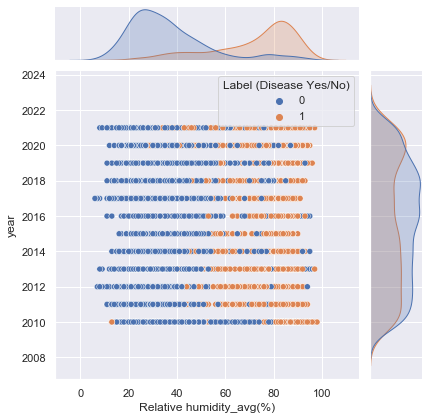

<Figure size 2160x1440 with 0 Axes>

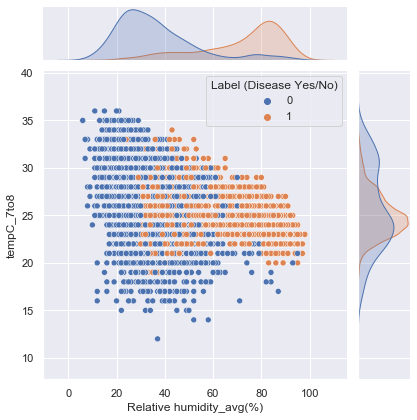

<Figure size 2160x1440 with 0 Axes>

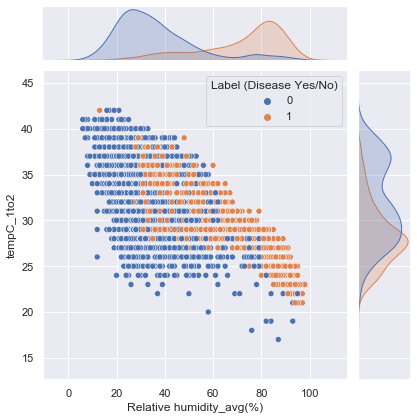

<Figure size 2160x1440 with 0 Axes>

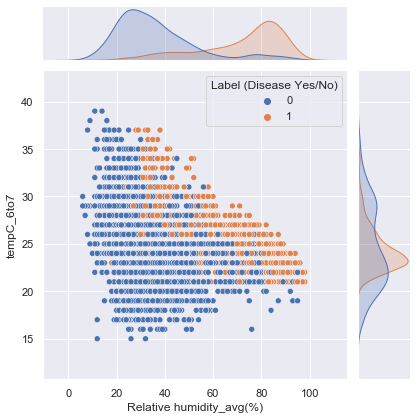

<Figure size 2160x1440 with 0 Axes>

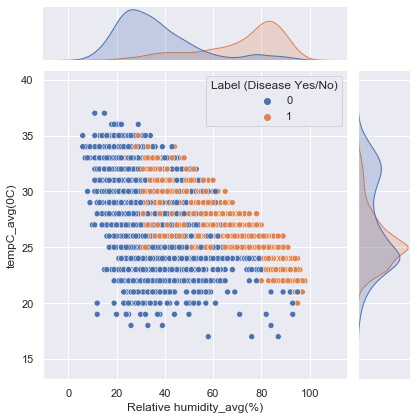

<Figure size 2160x1440 with 0 Axes>

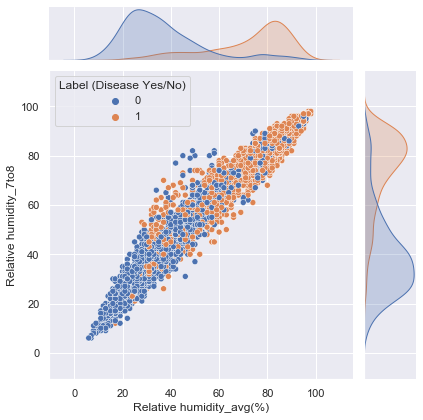

<Figure size 2160x1440 with 0 Axes>

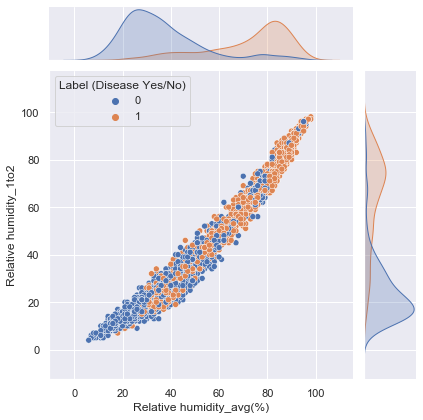

<Figure size 2160x1440 with 0 Axes>

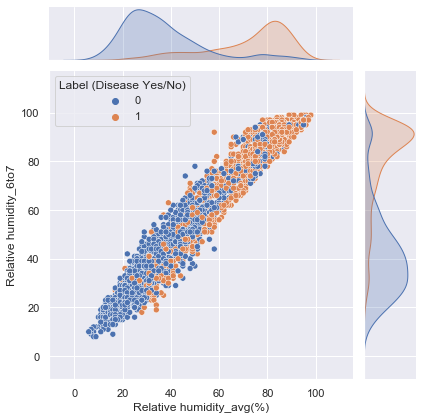

<Figure size 2160x1440 with 0 Axes>

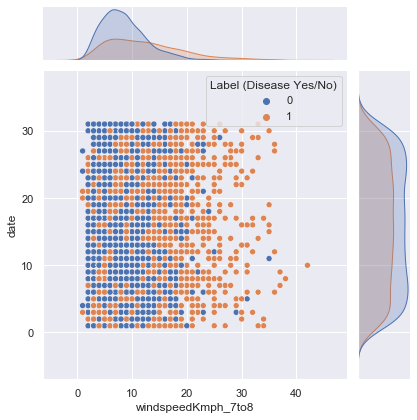

<Figure size 2160x1440 with 0 Axes>

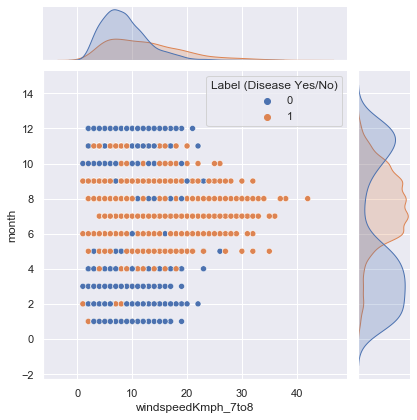

<Figure size 2160x1440 with 0 Axes>

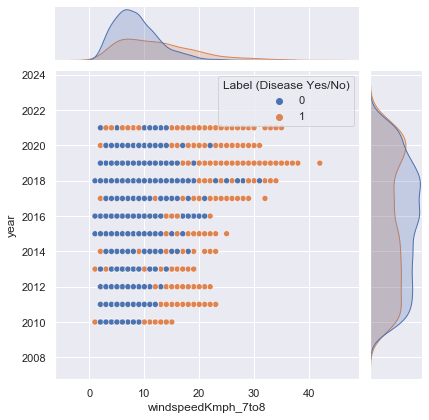

<Figure size 2160x1440 with 0 Axes>

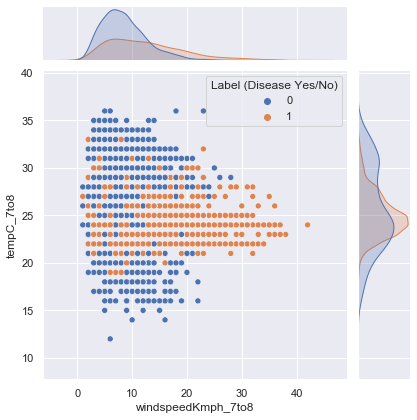

<Figure size 2160x1440 with 0 Axes>

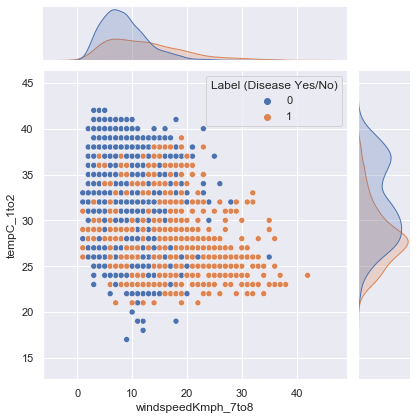

<Figure size 2160x1440 with 0 Axes>

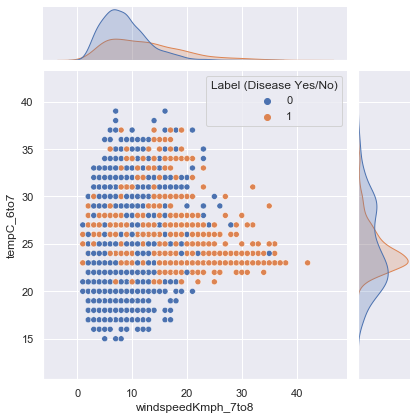

<Figure size 2160x1440 with 0 Axes>

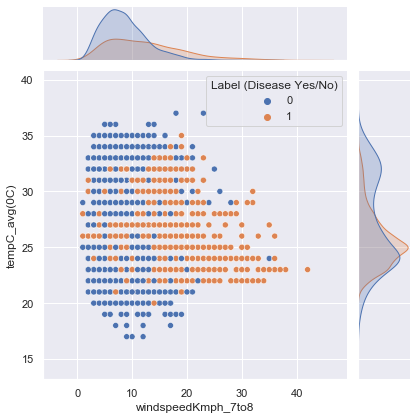

<Figure size 2160x1440 with 0 Axes>

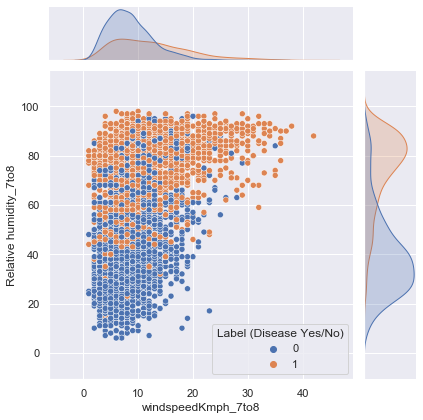

<Figure size 2160x1440 with 0 Axes>

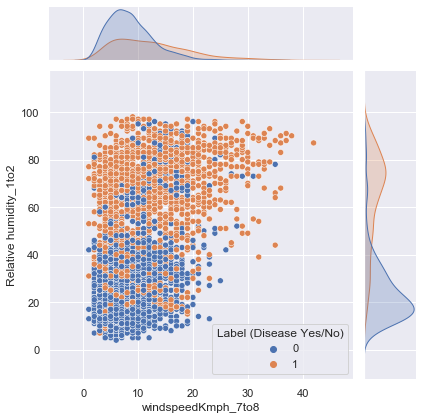

<Figure size 2160x1440 with 0 Axes>

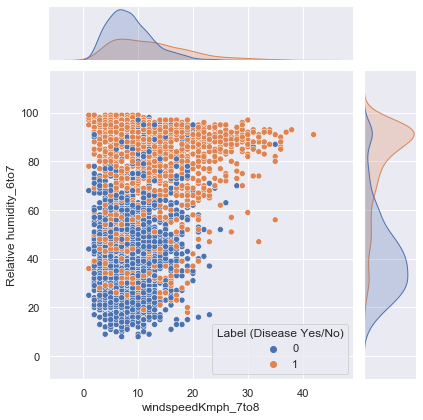

<Figure size 2160x1440 with 0 Axes>

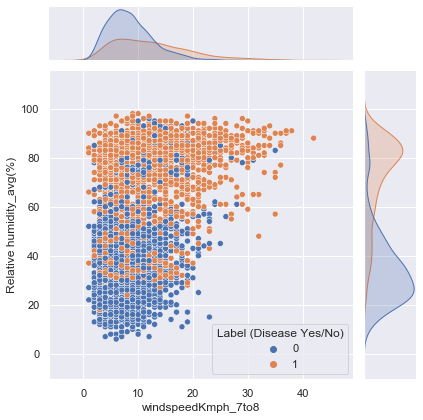

<Figure size 2160x1440 with 0 Axes>

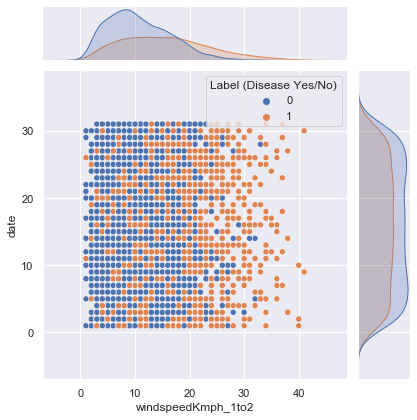

<Figure size 2160x1440 with 0 Axes>

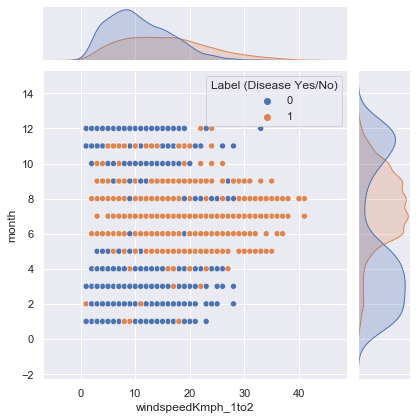

<Figure size 2160x1440 with 0 Axes>

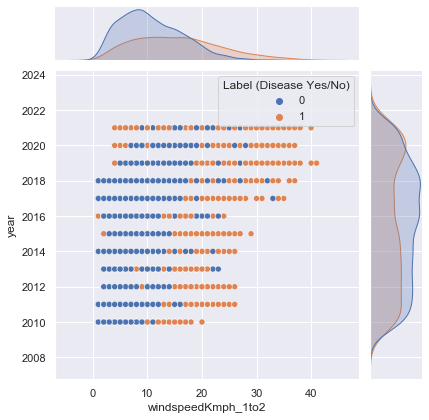

<Figure size 2160x1440 with 0 Axes>

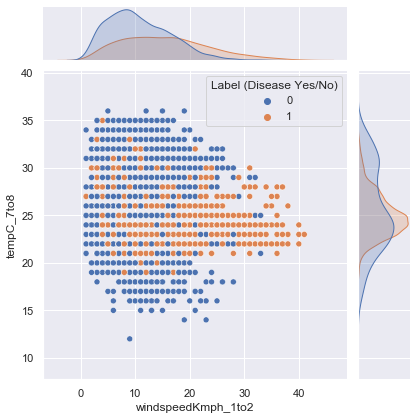

<Figure size 2160x1440 with 0 Axes>

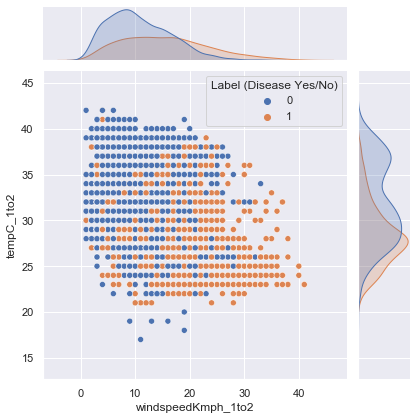

<Figure size 2160x1440 with 0 Axes>

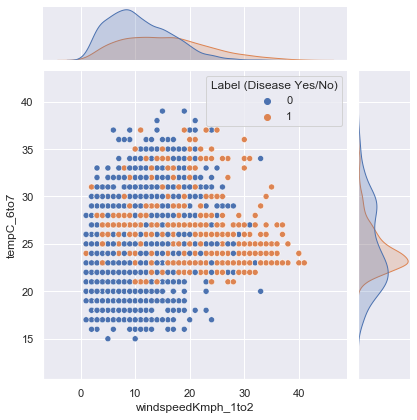

<Figure size 2160x1440 with 0 Axes>

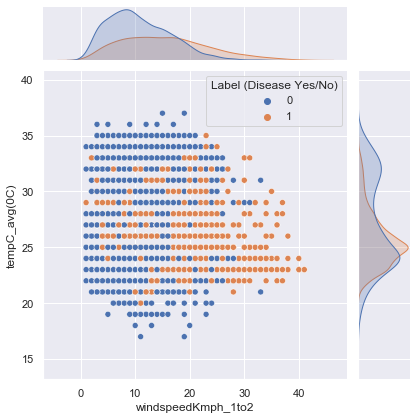

<Figure size 2160x1440 with 0 Axes>

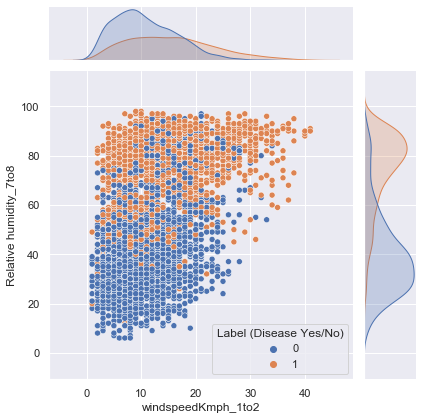

<Figure size 2160x1440 with 0 Axes>

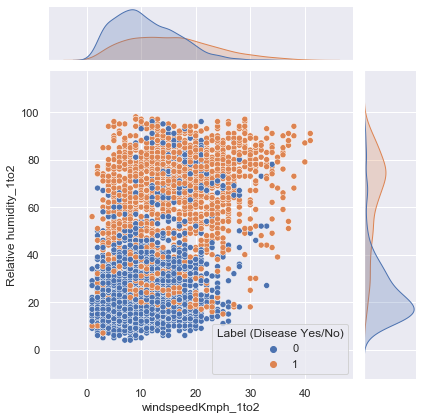

<Figure size 2160x1440 with 0 Axes>

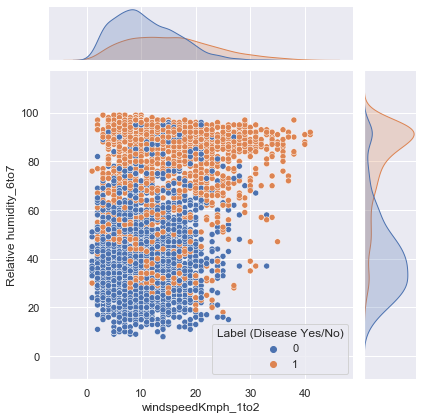

<Figure size 2160x1440 with 0 Axes>

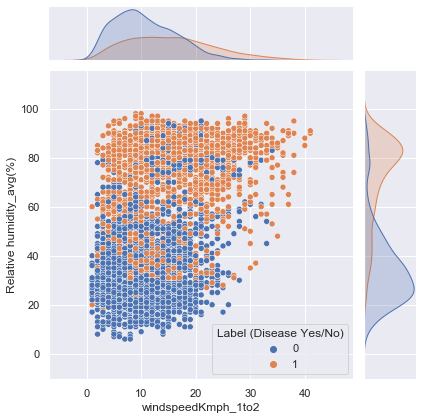

<Figure size 2160x1440 with 0 Axes>

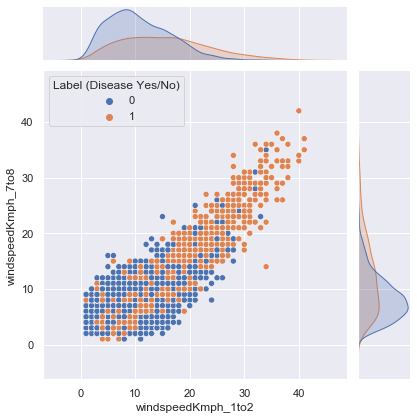

<Figure size 2160x1440 with 0 Axes>

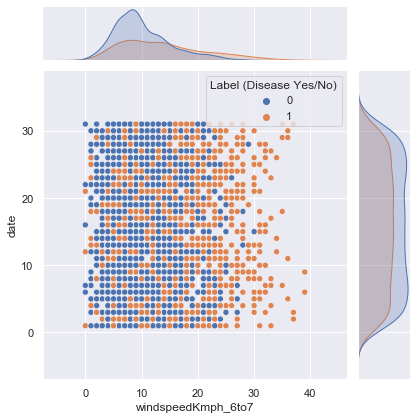

<Figure size 2160x1440 with 0 Axes>

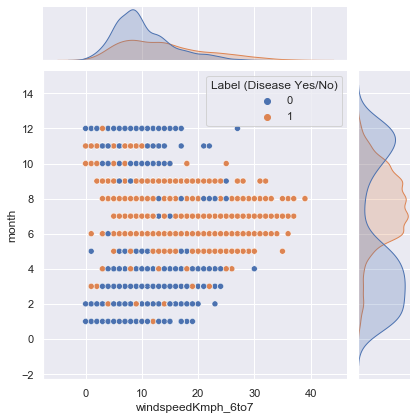

<Figure size 2160x1440 with 0 Axes>

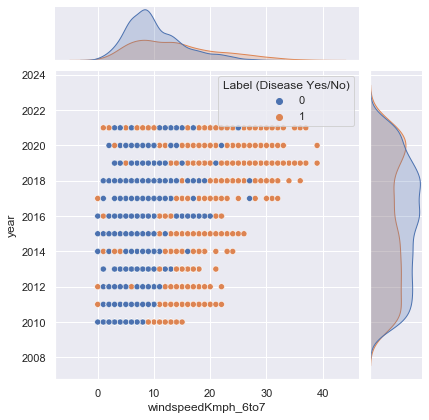

<Figure size 2160x1440 with 0 Axes>

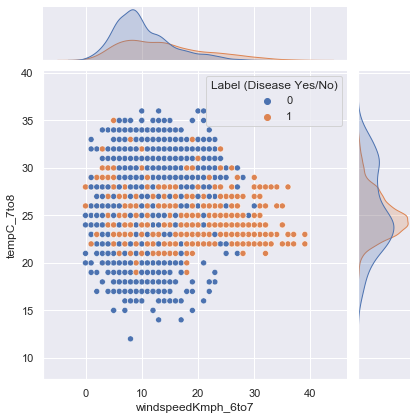

<Figure size 2160x1440 with 0 Axes>

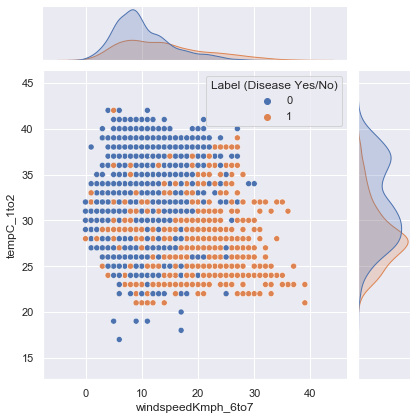

<Figure size 2160x1440 with 0 Axes>

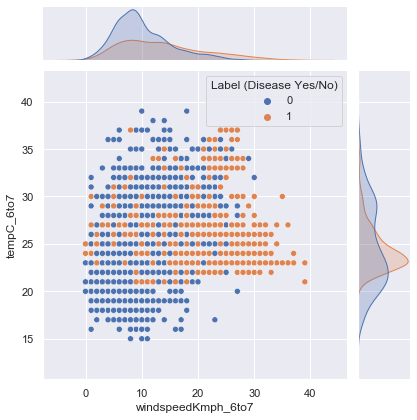

<Figure size 2160x1440 with 0 Axes>

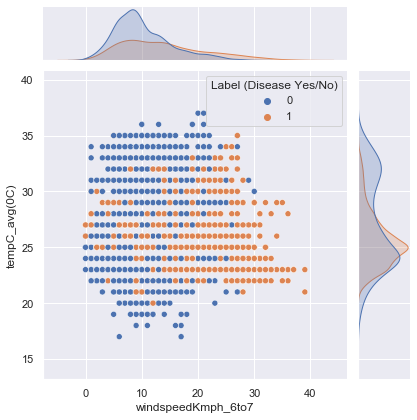

<Figure size 2160x1440 with 0 Axes>

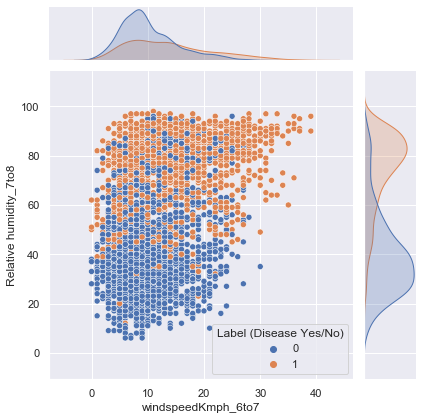

<Figure size 2160x1440 with 0 Axes>

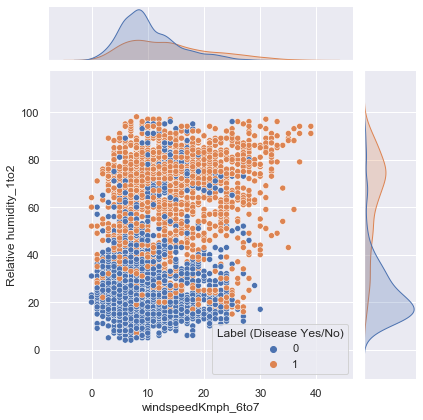

<Figure size 2160x1440 with 0 Axes>

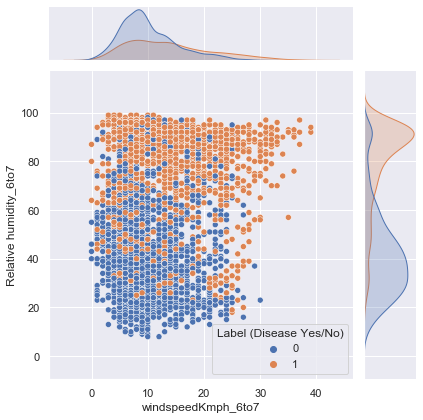

<Figure size 2160x1440 with 0 Axes>

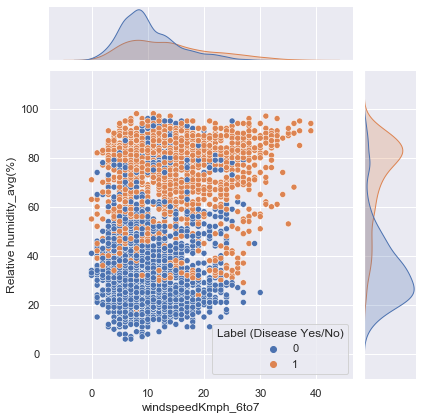

<Figure size 2160x1440 with 0 Axes>

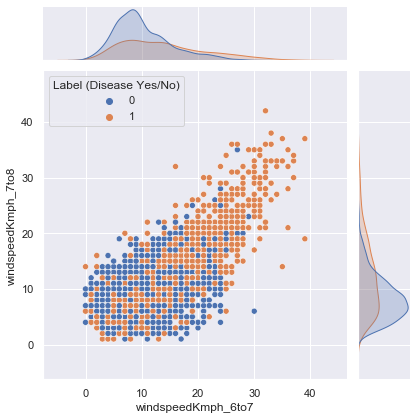

<Figure size 2160x1440 with 0 Axes>

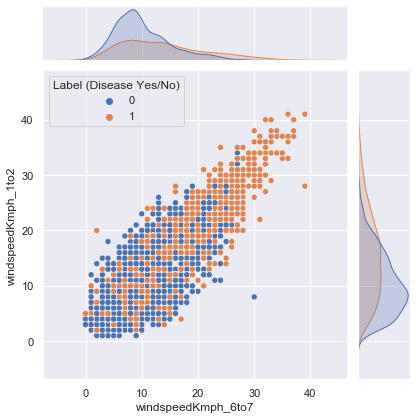

<Figure size 2160x1440 with 0 Axes>

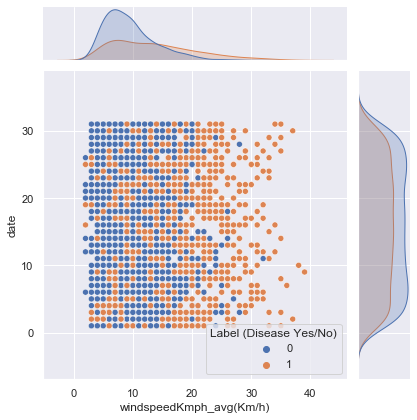

<Figure size 2160x1440 with 0 Axes>

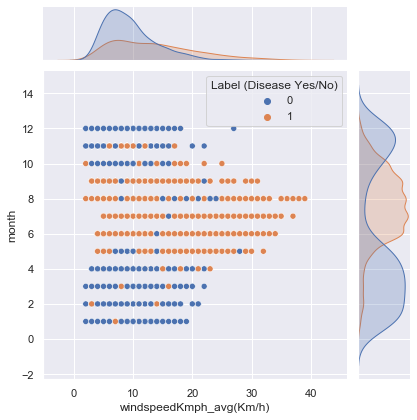

<Figure size 2160x1440 with 0 Axes>

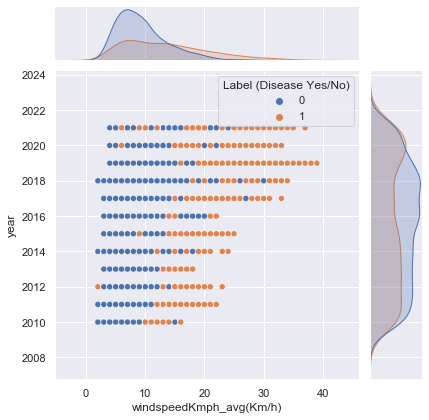

<Figure size 2160x1440 with 0 Axes>

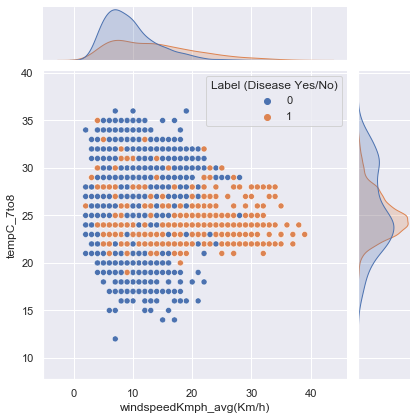

<Figure size 2160x1440 with 0 Axes>

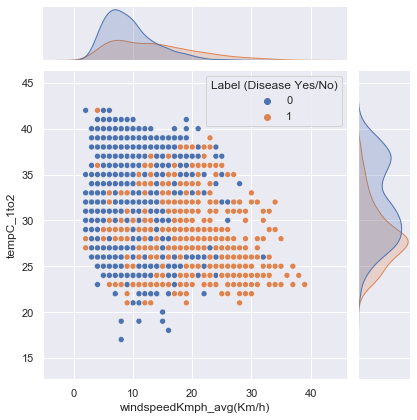

<Figure size 2160x1440 with 0 Axes>

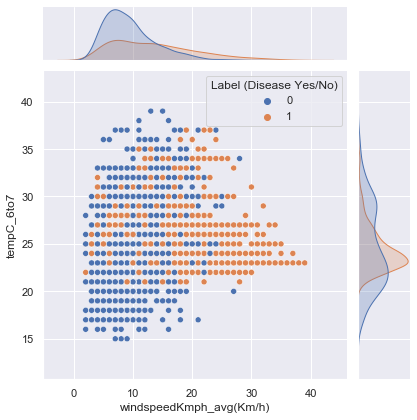

<Figure size 2160x1440 with 0 Axes>

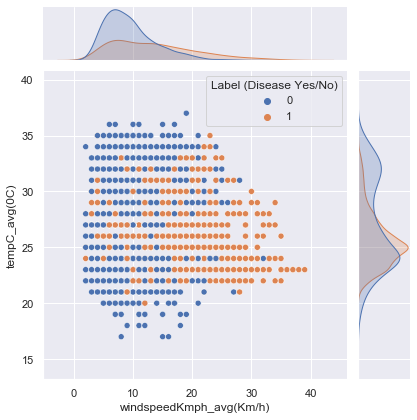

<Figure size 2160x1440 with 0 Axes>

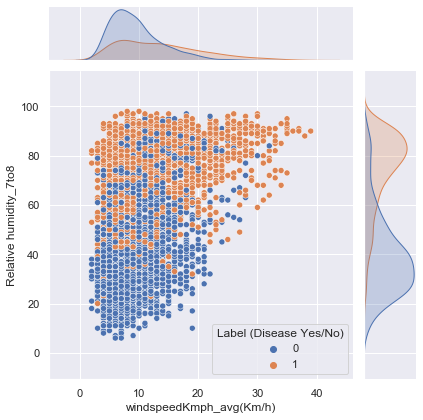

<Figure size 2160x1440 with 0 Axes>

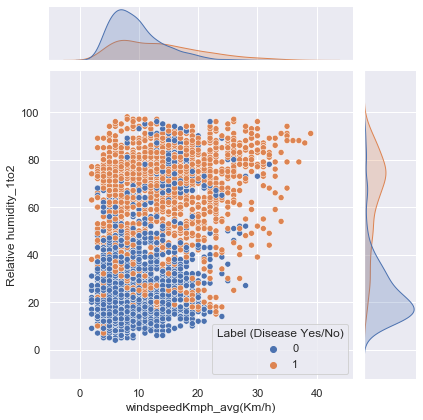

<Figure size 2160x1440 with 0 Axes>

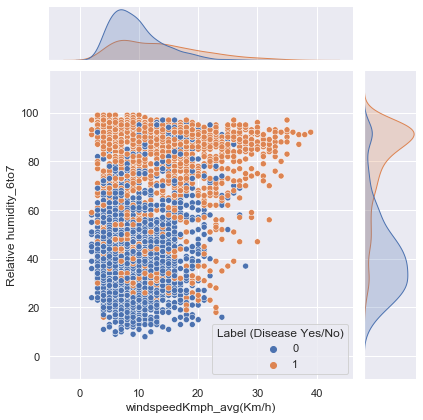

<Figure size 2160x1440 with 0 Axes>

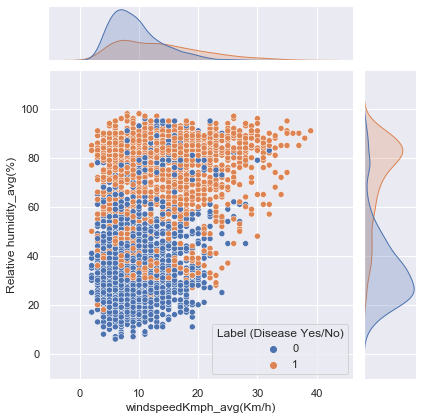

<Figure size 2160x1440 with 0 Axes>

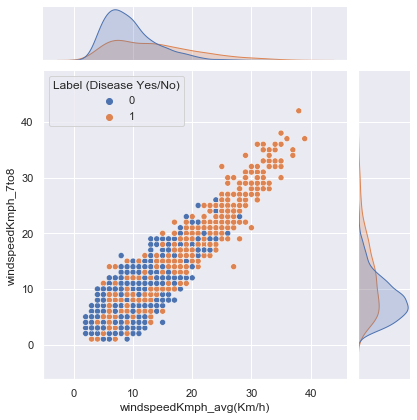

<Figure size 2160x1440 with 0 Axes>

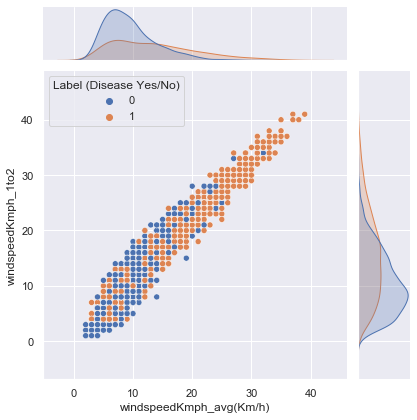

<Figure size 2160x1440 with 0 Axes>

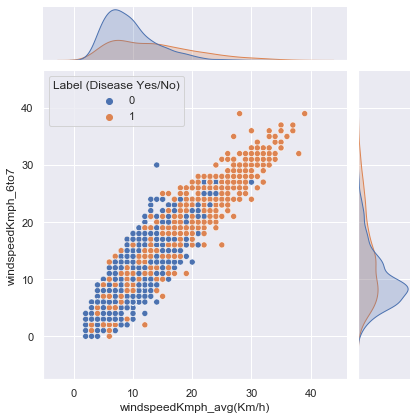

<Figure size 2160x1440 with 0 Axes>

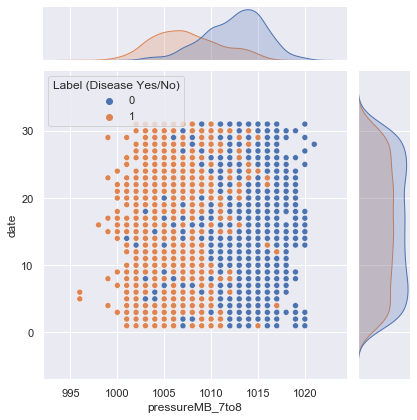

<Figure size 2160x1440 with 0 Axes>

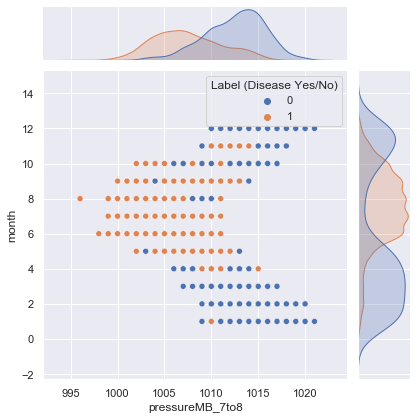

<Figure size 2160x1440 with 0 Axes>

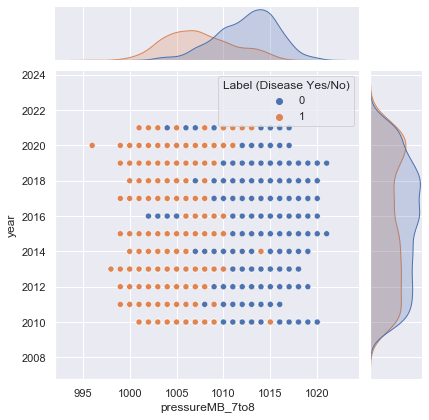

<Figure size 2160x1440 with 0 Axes>

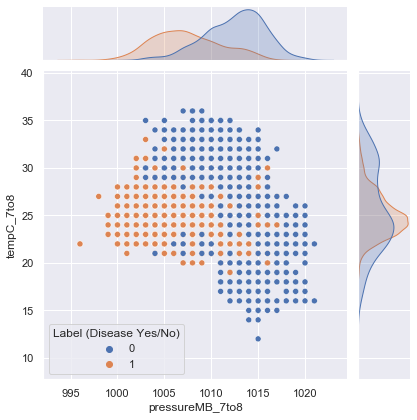

<Figure size 2160x1440 with 0 Axes>

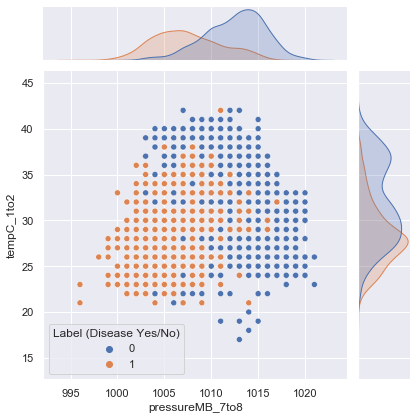

<Figure size 2160x1440 with 0 Axes>

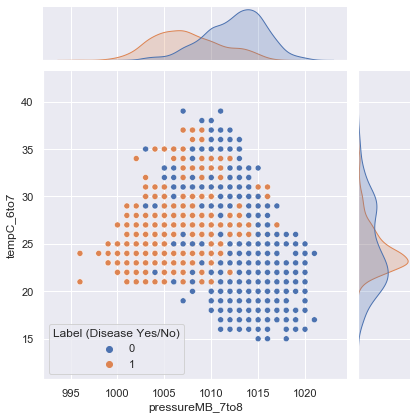

<Figure size 2160x1440 with 0 Axes>

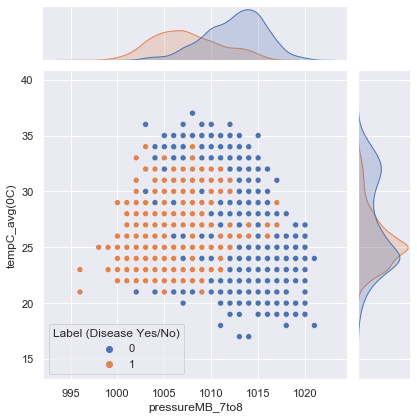

<Figure size 2160x1440 with 0 Axes>

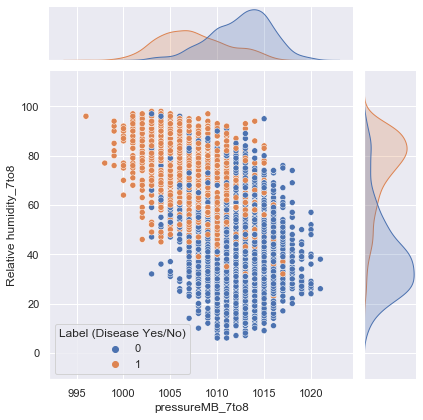

<Figure size 2160x1440 with 0 Axes>

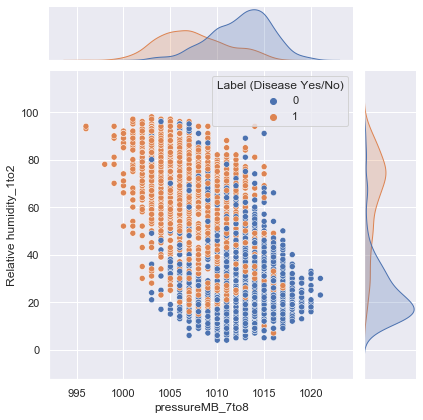

<Figure size 2160x1440 with 0 Axes>

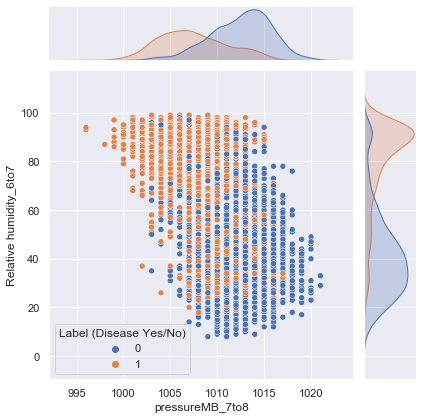

<Figure size 2160x1440 with 0 Axes>

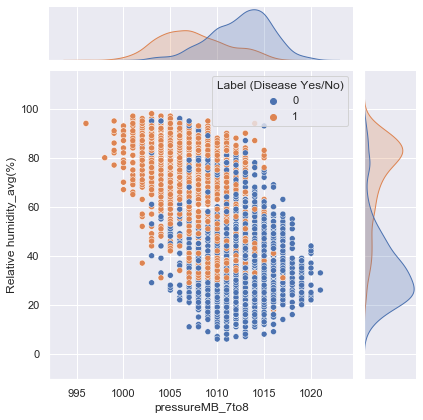

<Figure size 2160x1440 with 0 Axes>

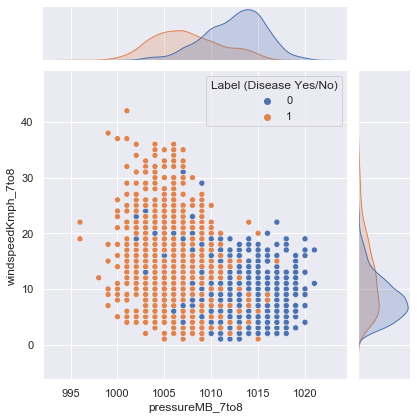

<Figure size 2160x1440 with 0 Axes>

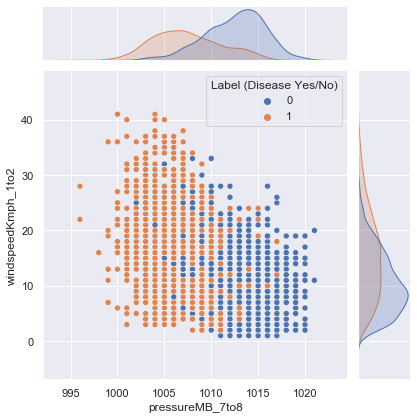

<Figure size 2160x1440 with 0 Axes>

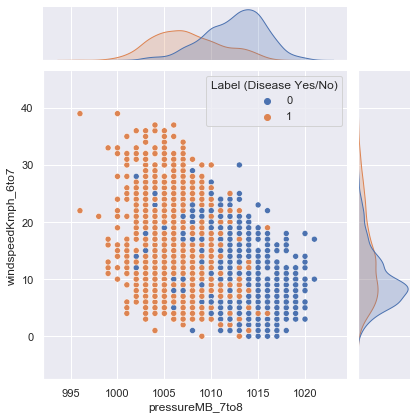

<Figure size 2160x1440 with 0 Axes>

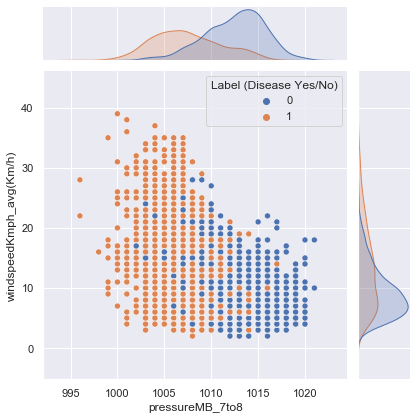

<Figure size 2160x1440 with 0 Axes>

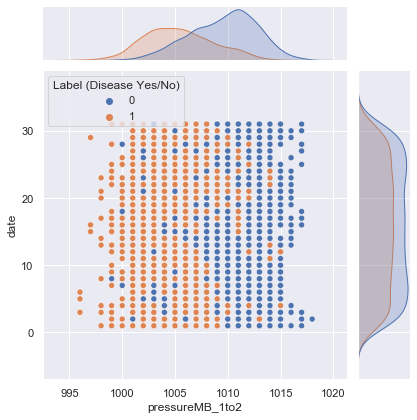

<Figure size 2160x1440 with 0 Axes>

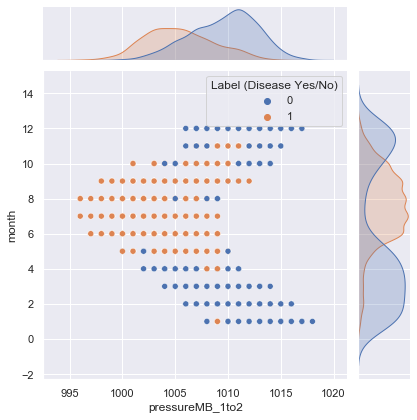

<Figure size 2160x1440 with 0 Axes>

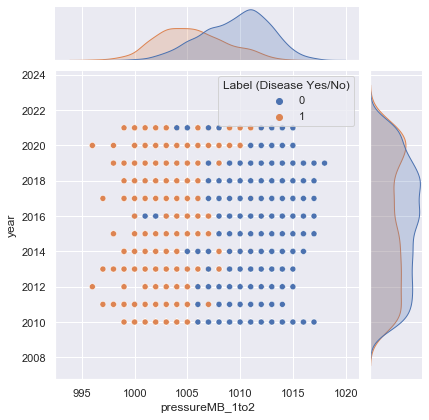

<Figure size 2160x1440 with 0 Axes>

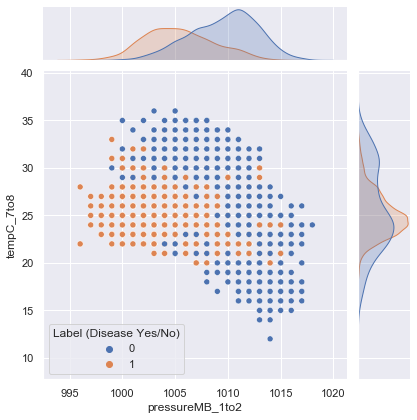

<Figure size 2160x1440 with 0 Axes>

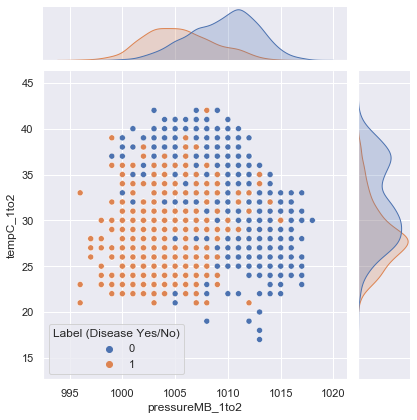

<Figure size 2160x1440 with 0 Axes>

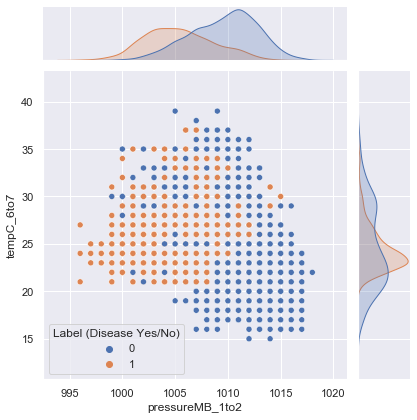

<Figure size 2160x1440 with 0 Axes>

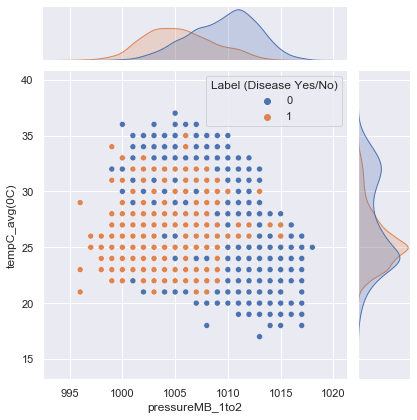

<Figure size 2160x1440 with 0 Axes>

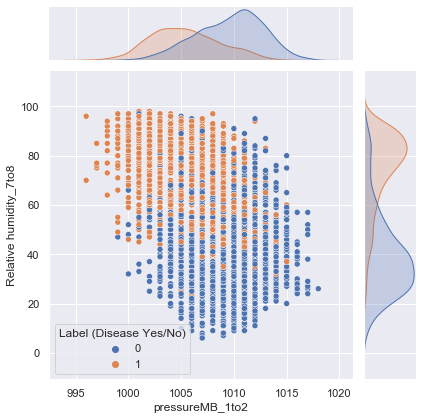

<Figure size 2160x1440 with 0 Axes>

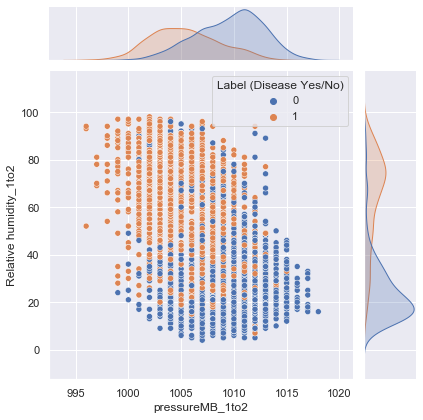

<Figure size 2160x1440 with 0 Axes>

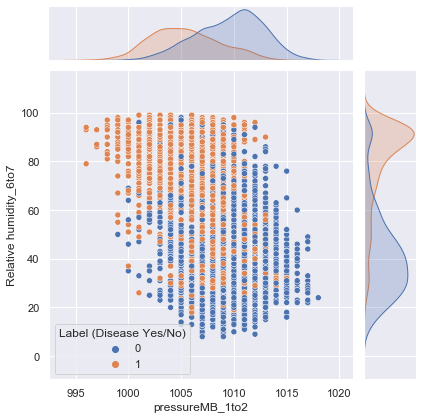

<Figure size 2160x1440 with 0 Axes>

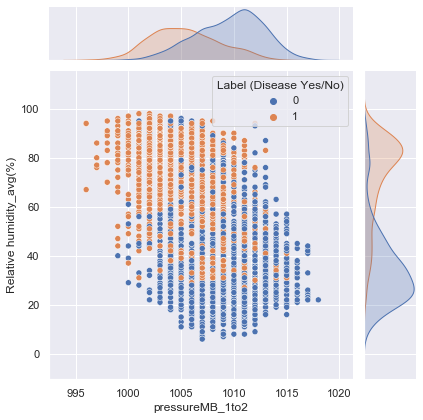

<Figure size 2160x1440 with 0 Axes>

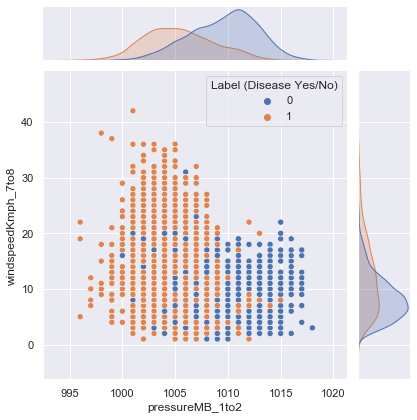

<Figure size 2160x1440 with 0 Axes>

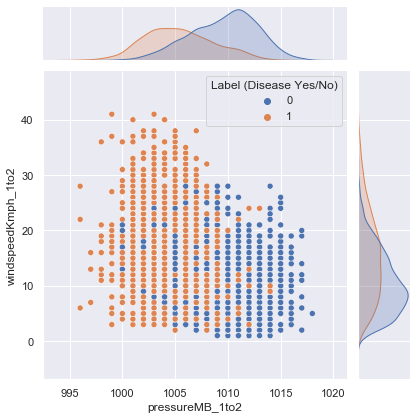

<Figure size 2160x1440 with 0 Axes>

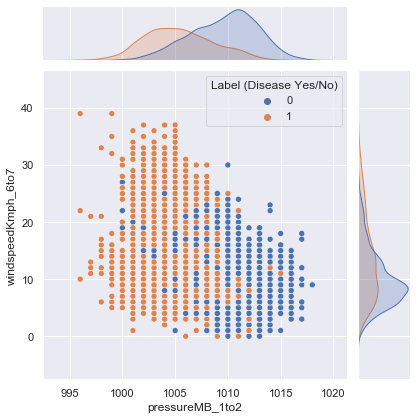

<Figure size 2160x1440 with 0 Axes>

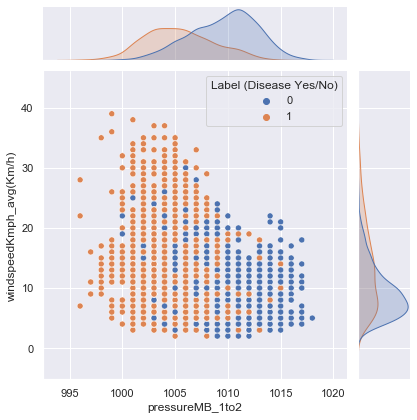

<Figure size 2160x1440 with 0 Axes>

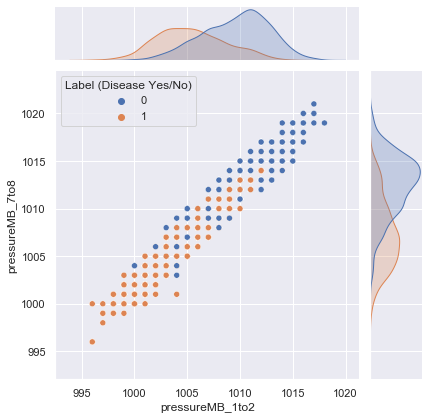

<Figure size 2160x1440 with 0 Axes>

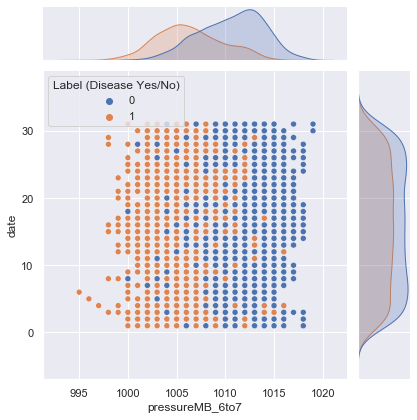

<Figure size 2160x1440 with 0 Axes>

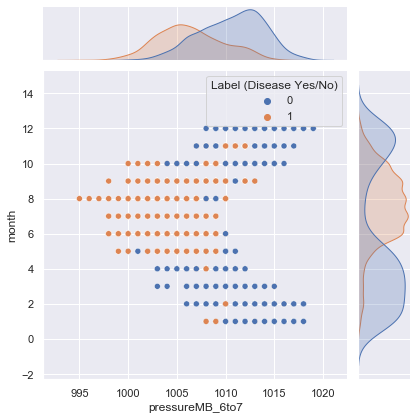

<Figure size 2160x1440 with 0 Axes>

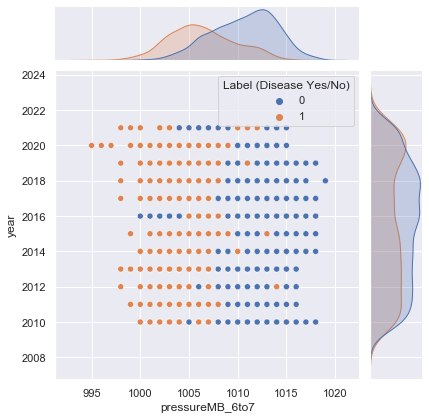

<Figure size 2160x1440 with 0 Axes>

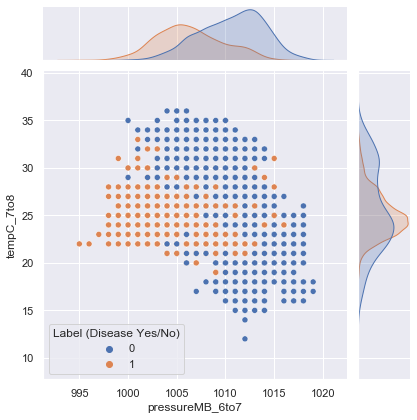

<Figure size 2160x1440 with 0 Axes>

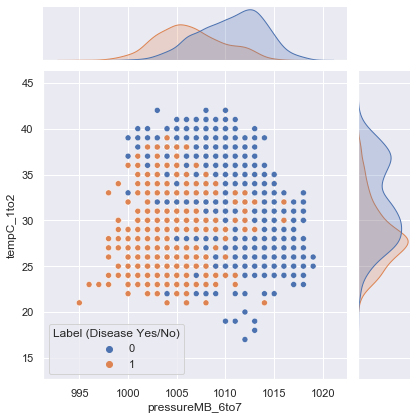

<Figure size 2160x1440 with 0 Axes>

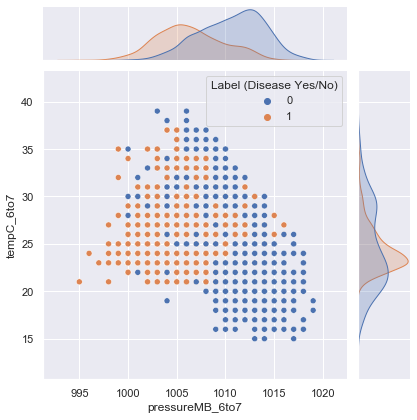

<Figure size 2160x1440 with 0 Axes>

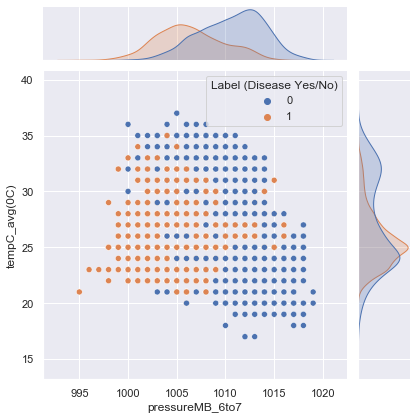

<Figure size 2160x1440 with 0 Axes>

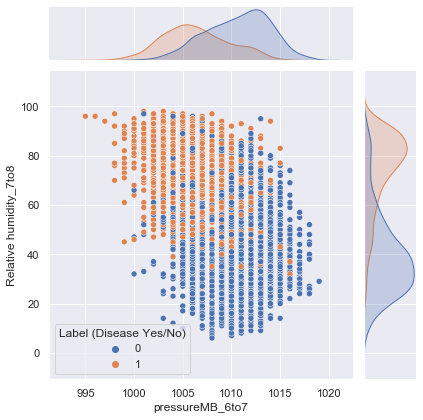

<Figure size 2160x1440 with 0 Axes>

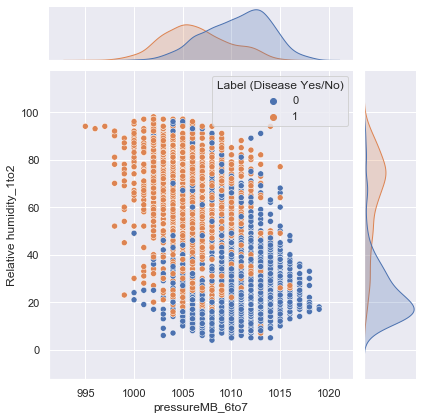

<Figure size 2160x1440 with 0 Axes>

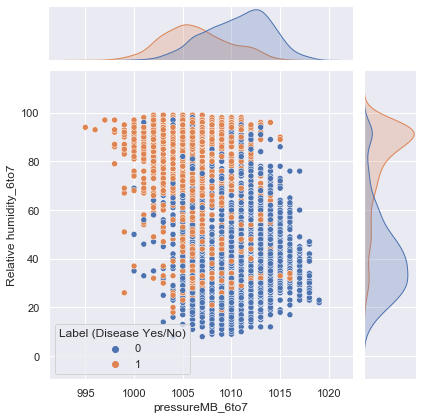

<Figure size 2160x1440 with 0 Axes>

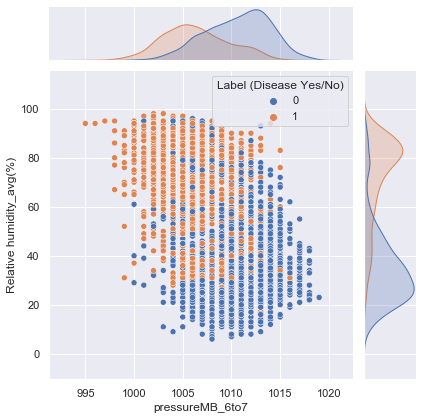

<Figure size 2160x1440 with 0 Axes>

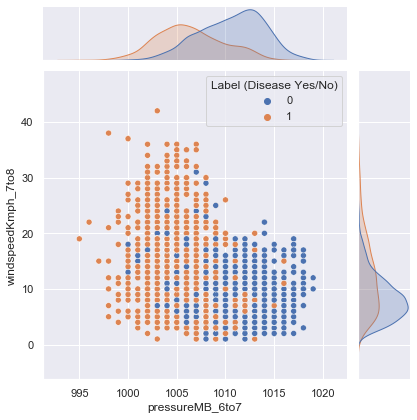

<Figure size 2160x1440 with 0 Axes>

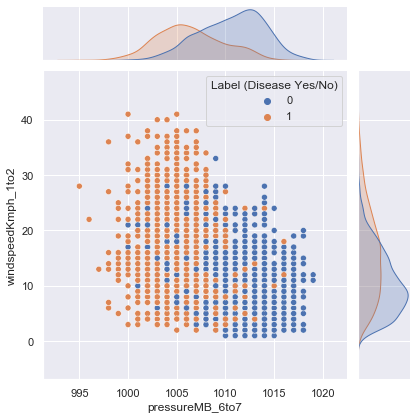

<Figure size 2160x1440 with 0 Axes>

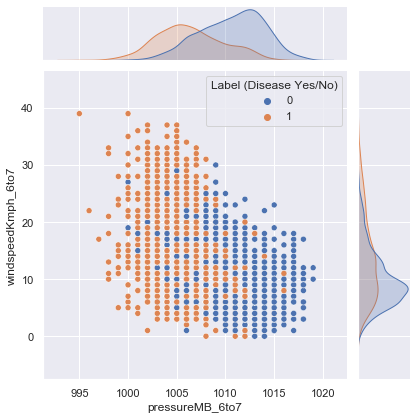

<Figure size 2160x1440 with 0 Axes>

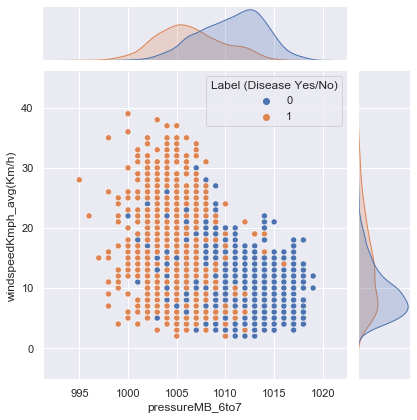

<Figure size 2160x1440 with 0 Axes>

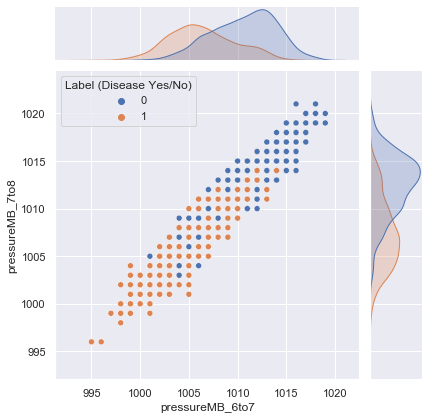

<Figure size 2160x1440 with 0 Axes>

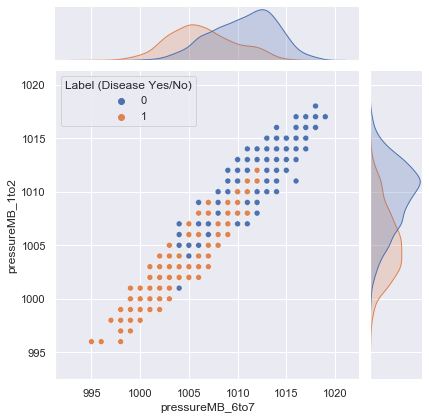

<Figure size 2160x1440 with 0 Axes>

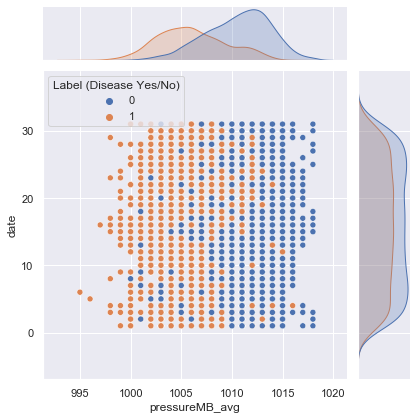

<Figure size 2160x1440 with 0 Axes>

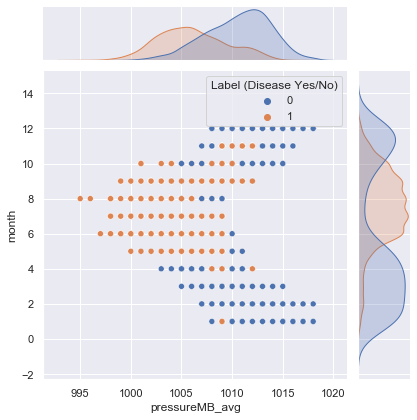

<Figure size 2160x1440 with 0 Axes>

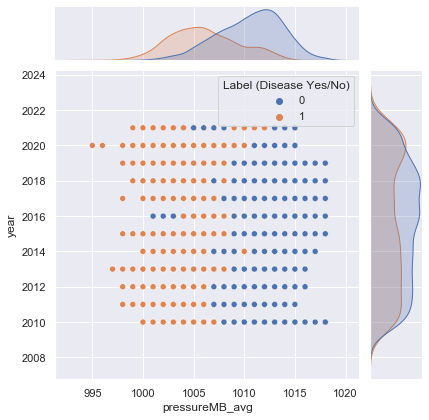

<Figure size 2160x1440 with 0 Axes>

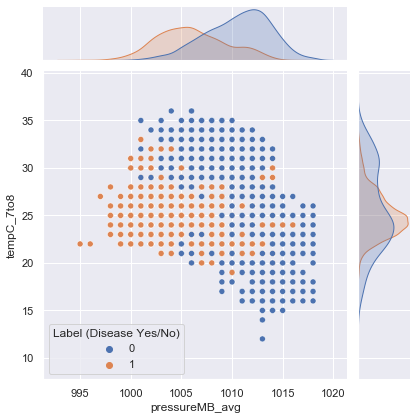

<Figure size 2160x1440 with 0 Axes>

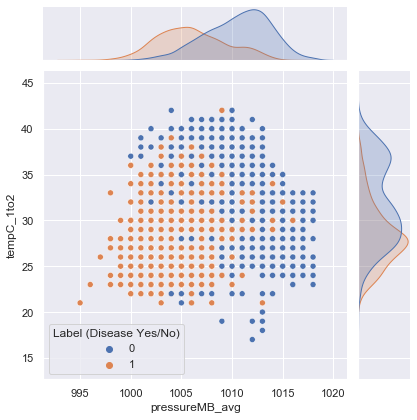

<Figure size 2160x1440 with 0 Axes>

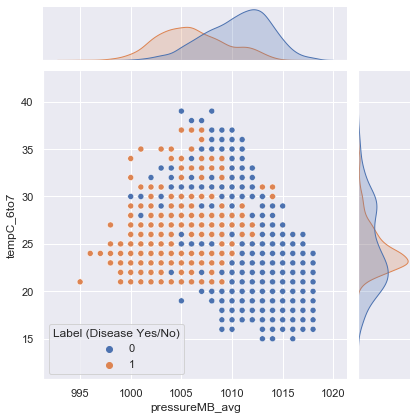

<Figure size 2160x1440 with 0 Axes>

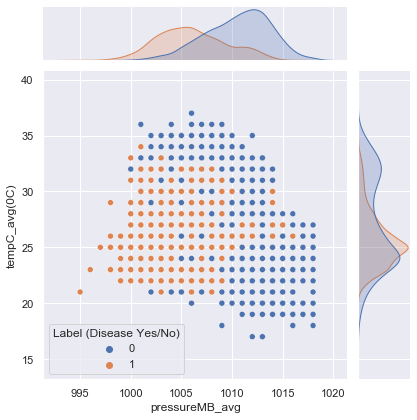

<Figure size 2160x1440 with 0 Axes>

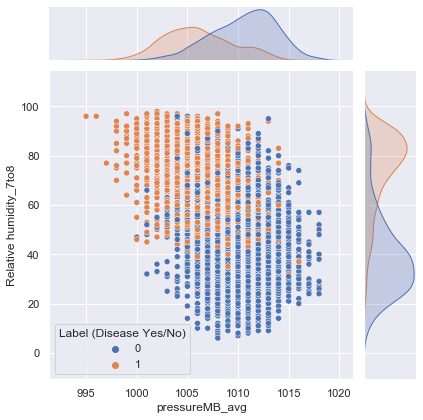

<Figure size 2160x1440 with 0 Axes>

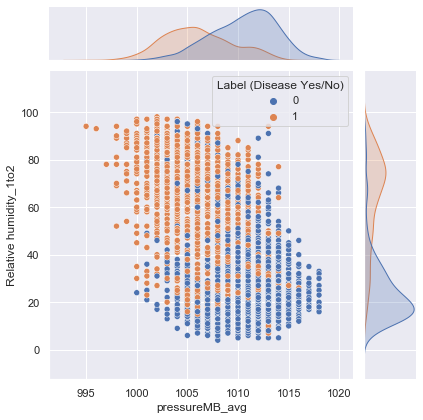

<Figure size 2160x1440 with 0 Axes>

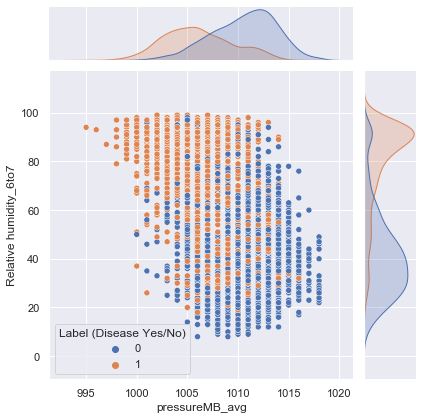

<Figure size 2160x1440 with 0 Axes>

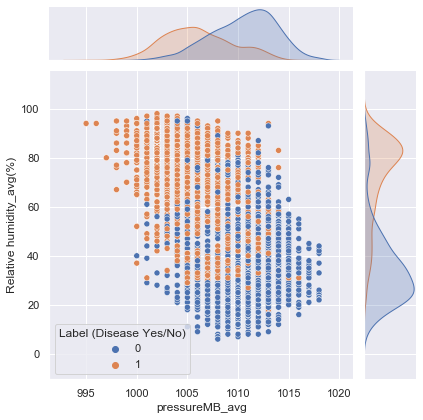

<Figure size 2160x1440 with 0 Axes>

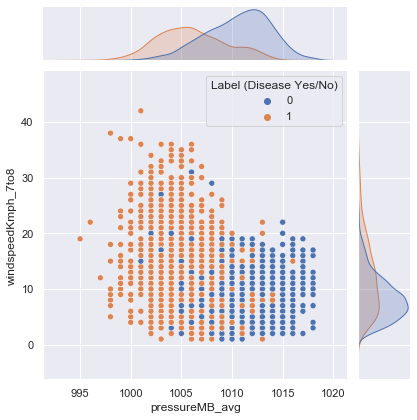

<Figure size 2160x1440 with 0 Axes>

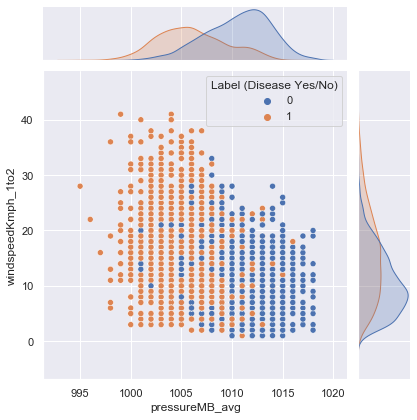

<Figure size 2160x1440 with 0 Axes>

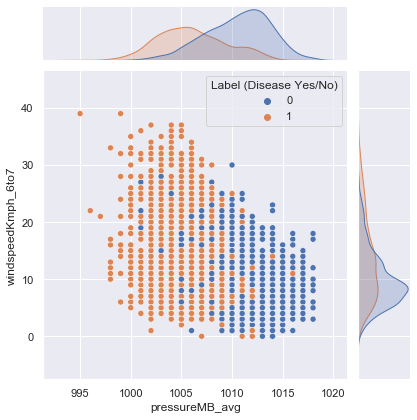

<Figure size 2160x1440 with 0 Axes>

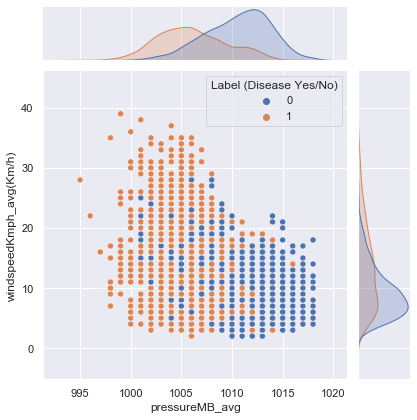

<Figure size 2160x1440 with 0 Axes>

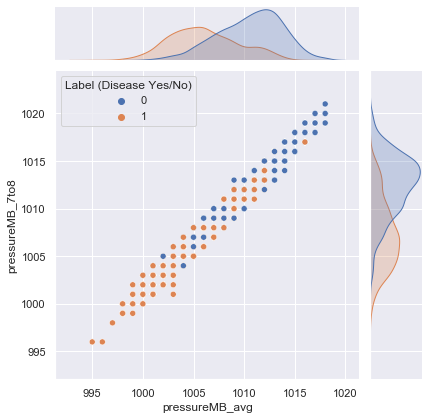

<Figure size 2160x1440 with 0 Axes>

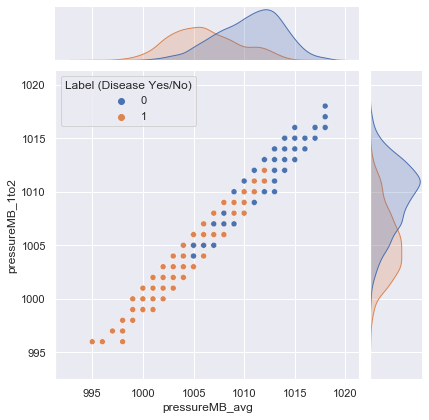

<Figure size 2160x1440 with 0 Axes>

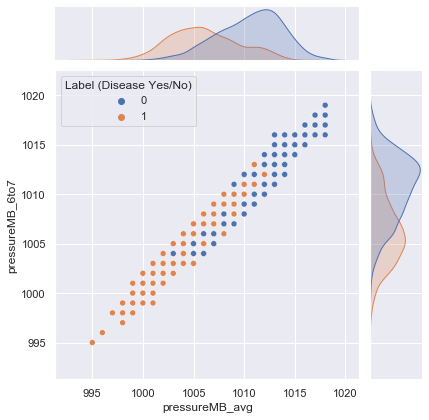

<Figure size 2160x1440 with 0 Axes>

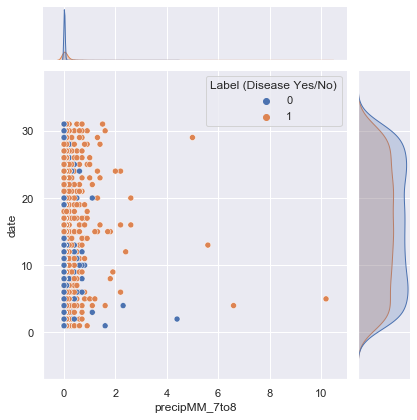

<Figure size 2160x1440 with 0 Axes>

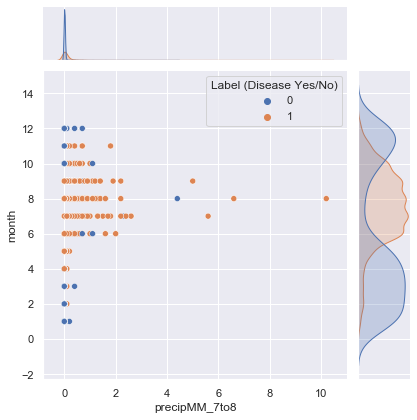

<Figure size 2160x1440 with 0 Axes>

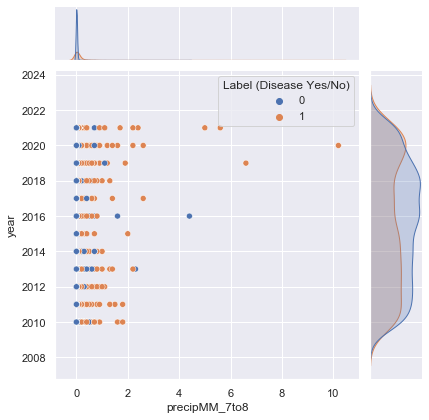

<Figure size 2160x1440 with 0 Axes>

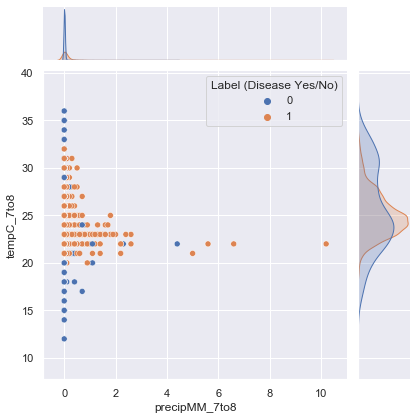

<Figure size 2160x1440 with 0 Axes>

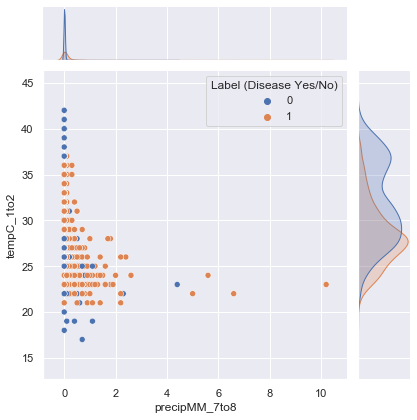

<Figure size 2160x1440 with 0 Axes>

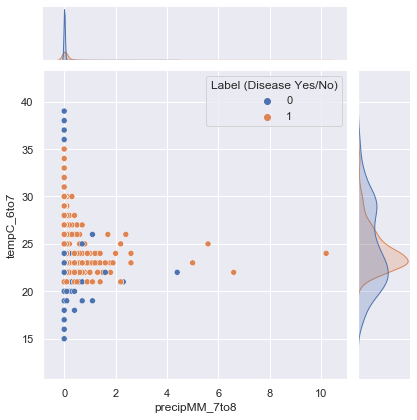

<Figure size 2160x1440 with 0 Axes>

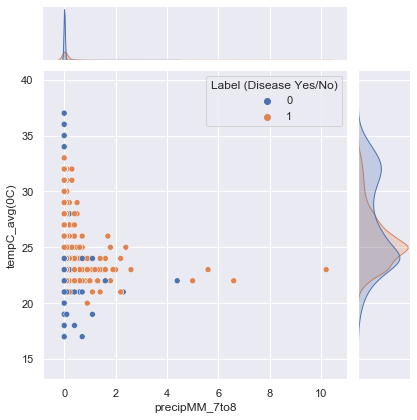

<Figure size 2160x1440 with 0 Axes>

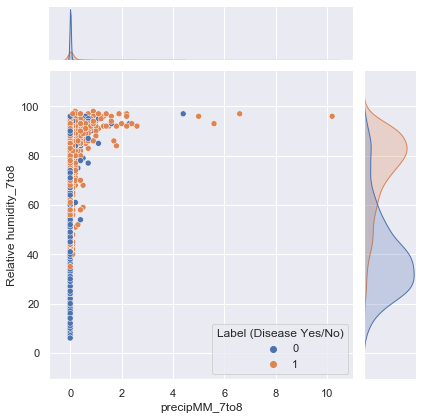

<Figure size 2160x1440 with 0 Axes>

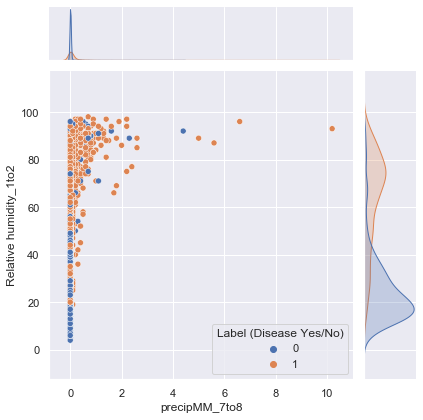

<Figure size 2160x1440 with 0 Axes>

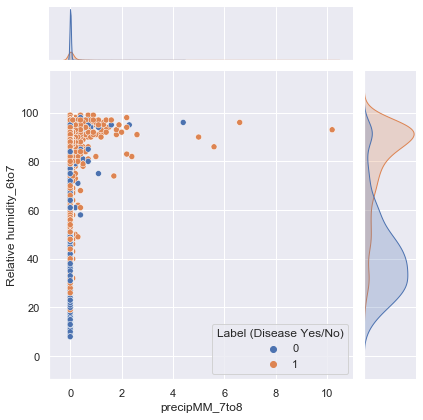

<Figure size 2160x1440 with 0 Axes>

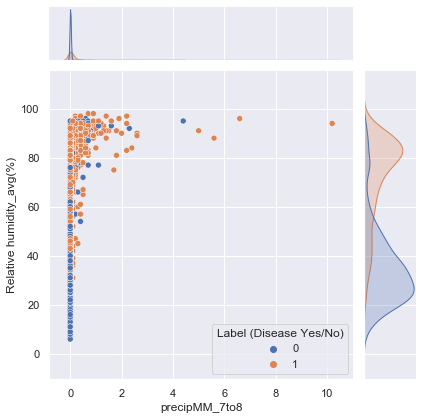

<Figure size 2160x1440 with 0 Axes>

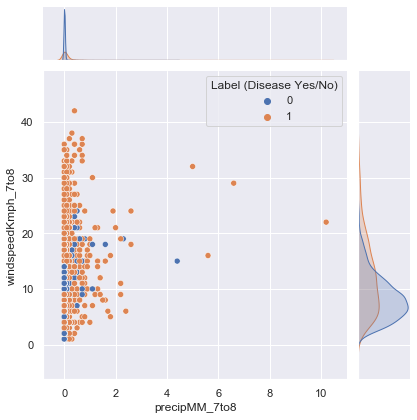

<Figure size 2160x1440 with 0 Axes>

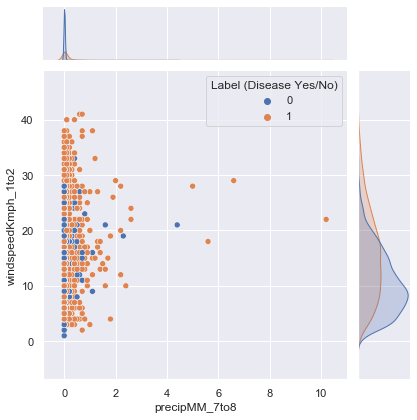

<Figure size 2160x1440 with 0 Axes>

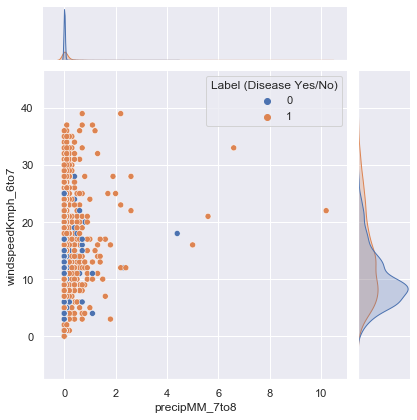

<Figure size 2160x1440 with 0 Axes>

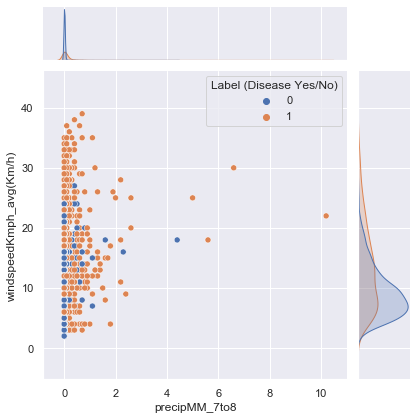

<Figure size 2160x1440 with 0 Axes>

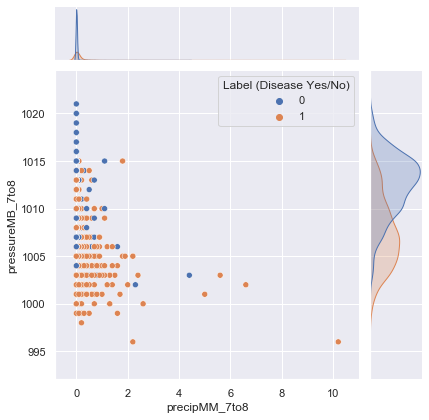

<Figure size 2160x1440 with 0 Axes>

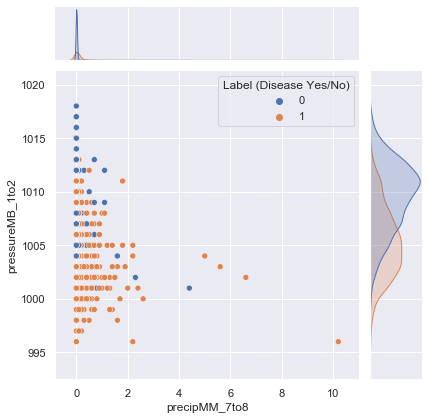

<Figure size 2160x1440 with 0 Axes>

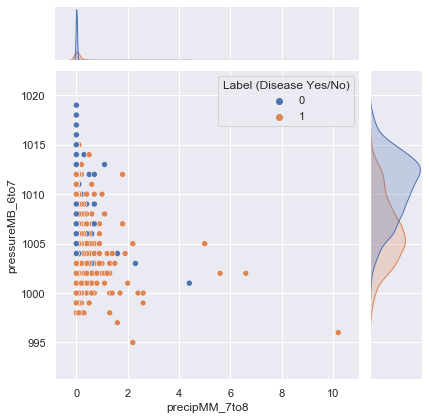

<Figure size 2160x1440 with 0 Axes>

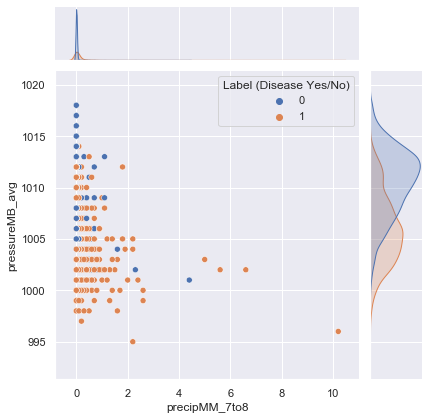

<Figure size 2160x1440 with 0 Axes>

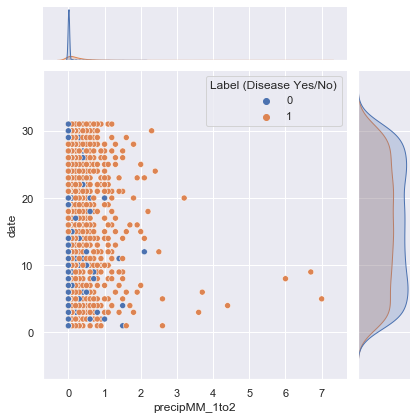

<Figure size 2160x1440 with 0 Axes>

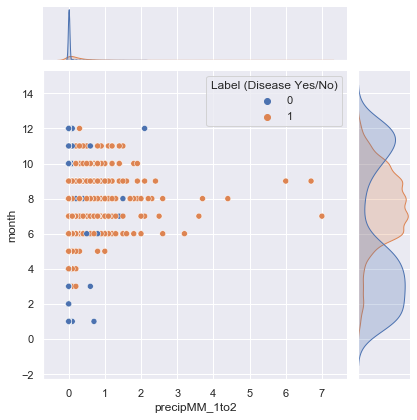

<Figure size 2160x1440 with 0 Axes>

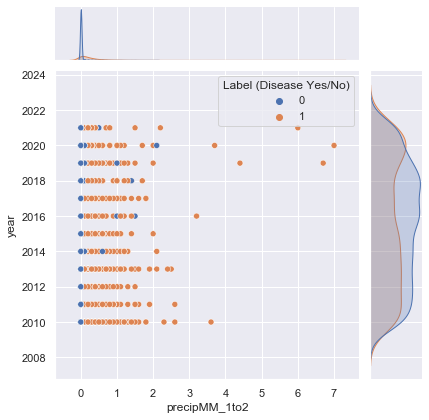

<Figure size 2160x1440 with 0 Axes>

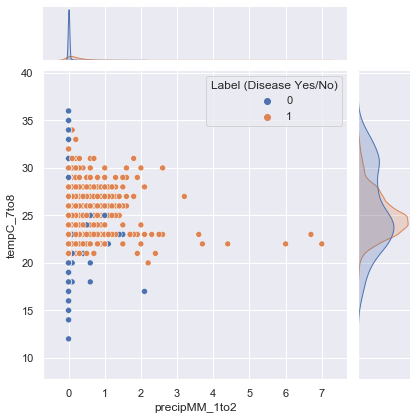

<Figure size 2160x1440 with 0 Axes>

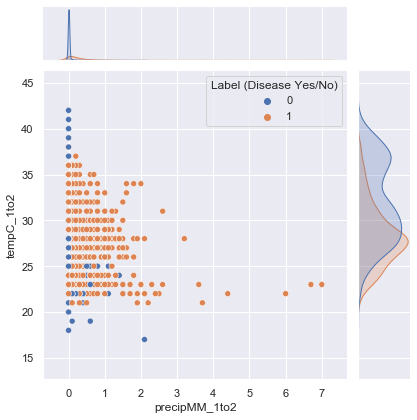

<Figure size 2160x1440 with 0 Axes>

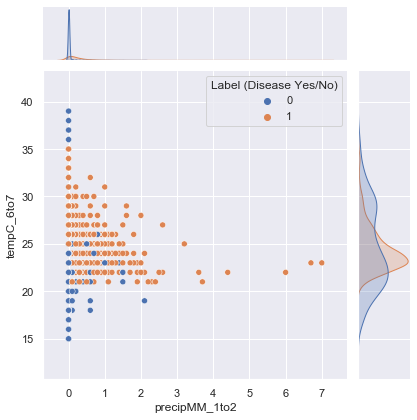

<Figure size 2160x1440 with 0 Axes>

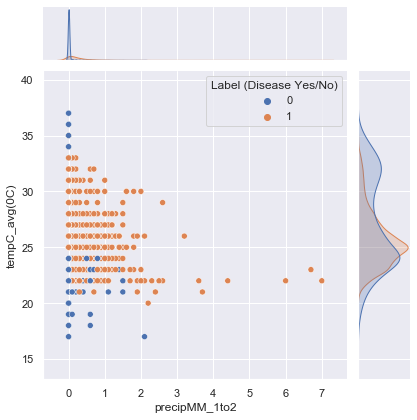

<Figure size 2160x1440 with 0 Axes>

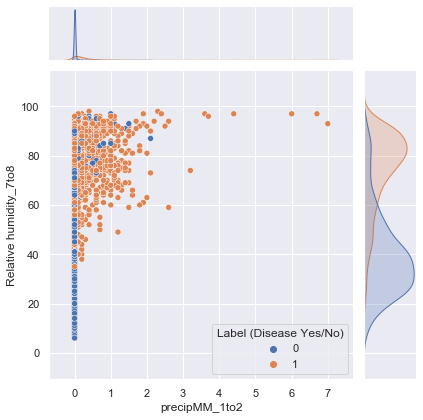

<Figure size 2160x1440 with 0 Axes>

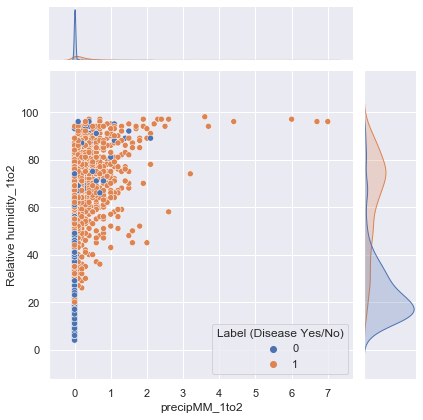

<Figure size 2160x1440 with 0 Axes>

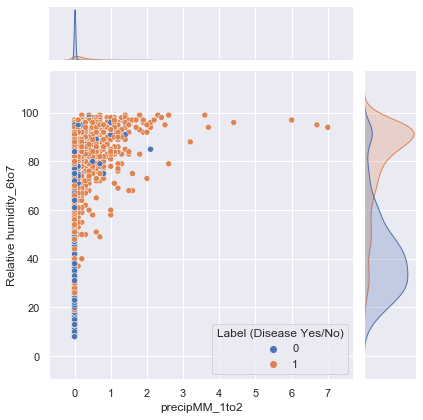

<Figure size 2160x1440 with 0 Axes>

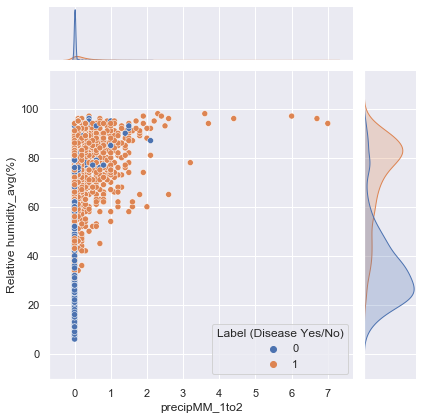

<Figure size 2160x1440 with 0 Axes>

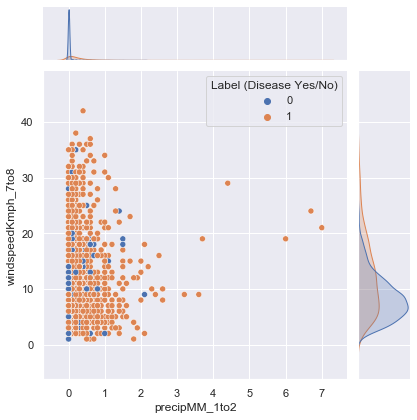

<Figure size 2160x1440 with 0 Axes>

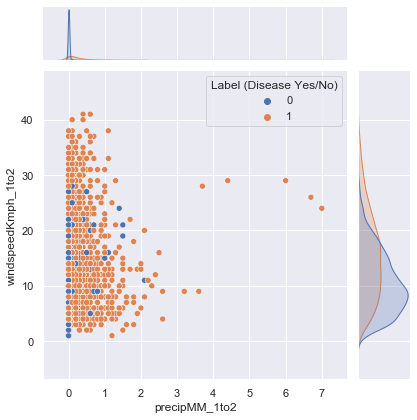

<Figure size 2160x1440 with 0 Axes>

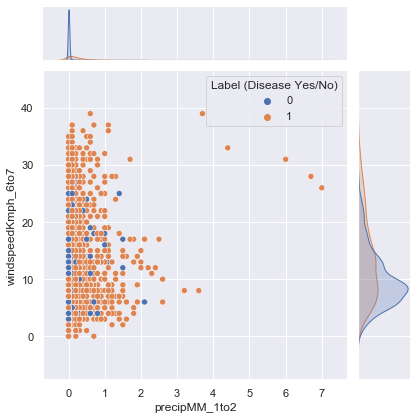

<Figure size 2160x1440 with 0 Axes>

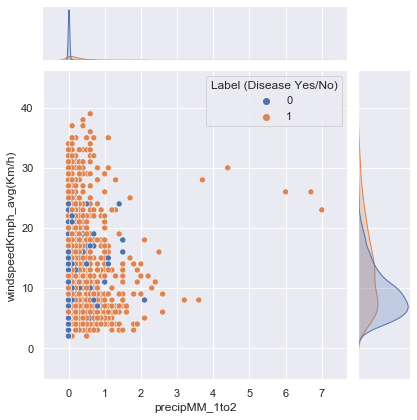

<Figure size 2160x1440 with 0 Axes>

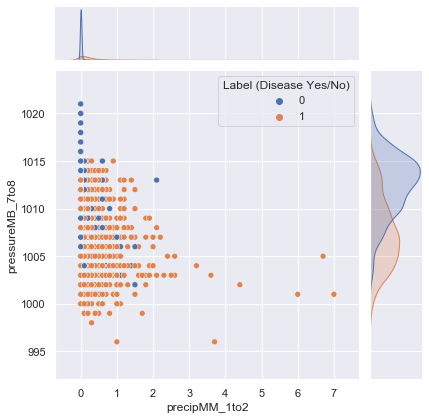

<Figure size 2160x1440 with 0 Axes>

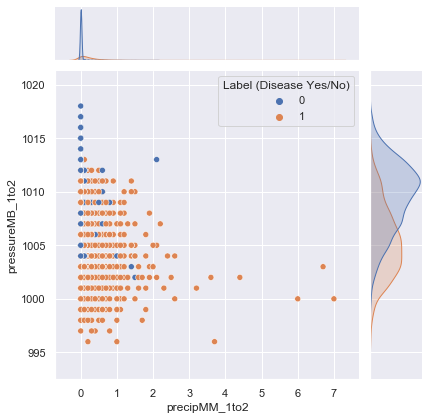

<Figure size 2160x1440 with 0 Axes>

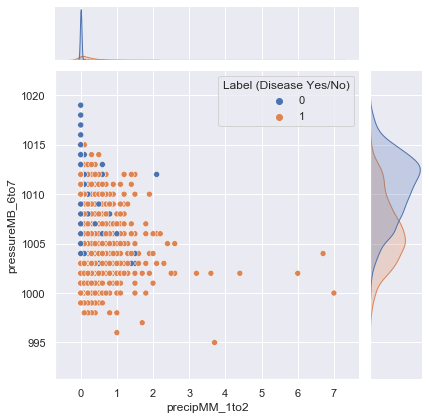

<Figure size 2160x1440 with 0 Axes>

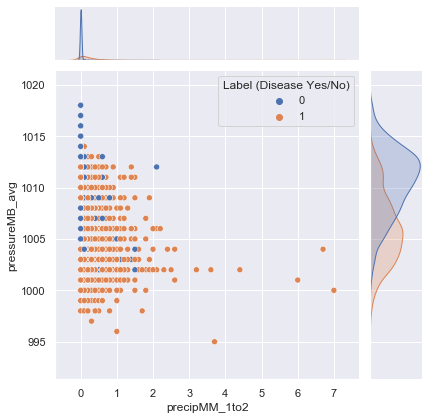

<Figure size 2160x1440 with 0 Axes>

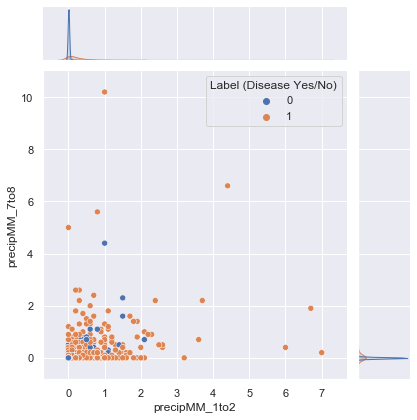

<Figure size 2160x1440 with 0 Axes>

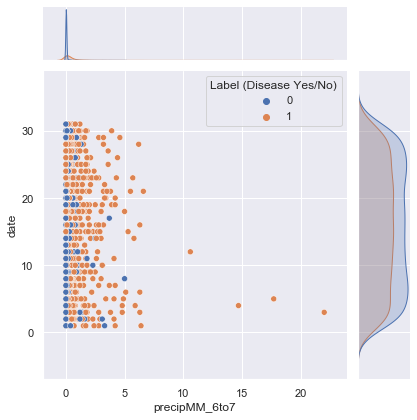

<Figure size 2160x1440 with 0 Axes>

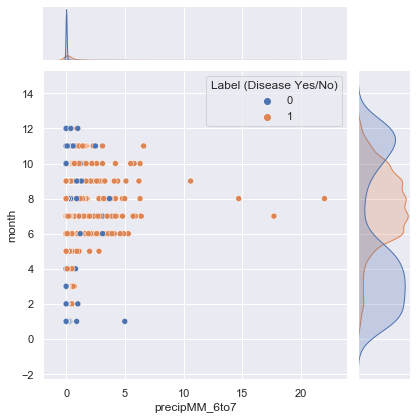

<Figure size 2160x1440 with 0 Axes>

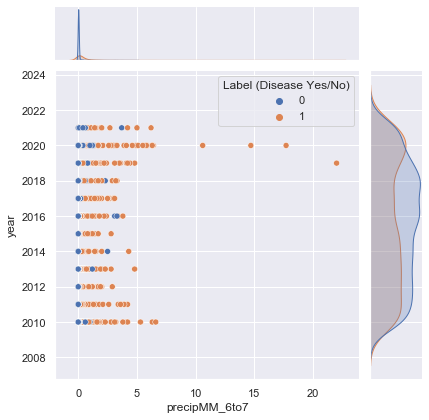

<Figure size 2160x1440 with 0 Axes>

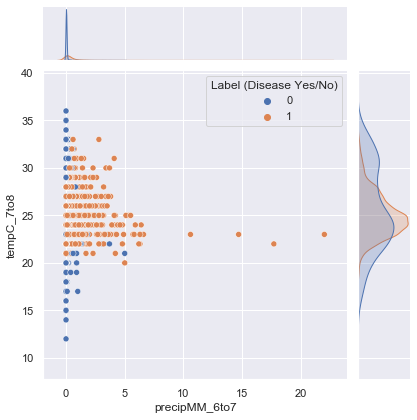

<Figure size 2160x1440 with 0 Axes>

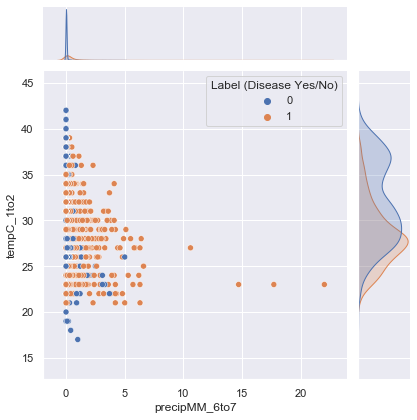

<Figure size 2160x1440 with 0 Axes>

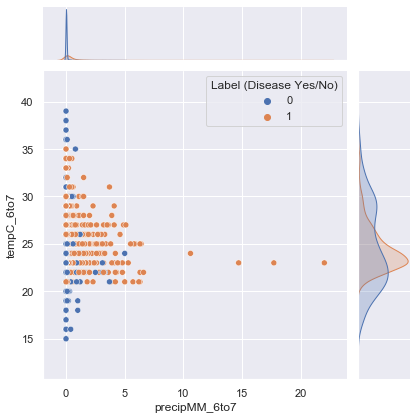

<Figure size 2160x1440 with 0 Axes>

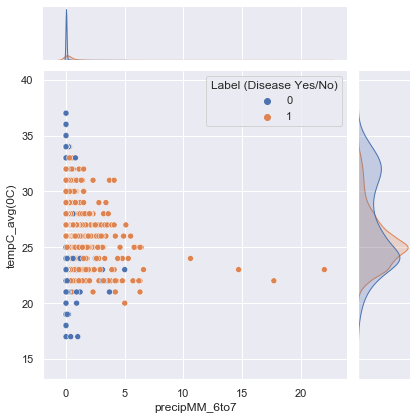

<Figure size 2160x1440 with 0 Axes>

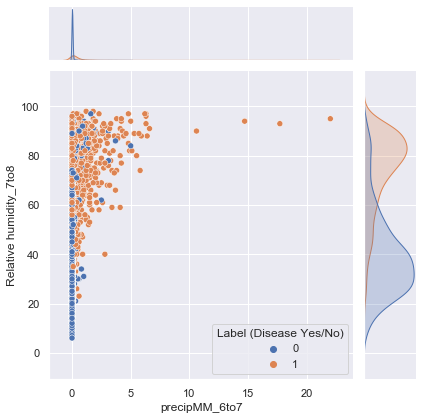

<Figure size 2160x1440 with 0 Axes>

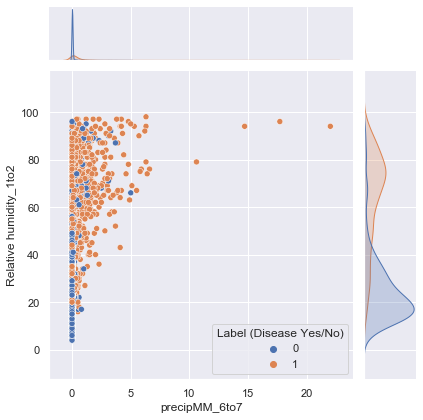

<Figure size 2160x1440 with 0 Axes>

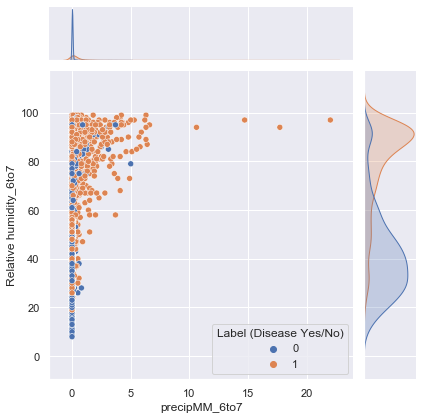

<Figure size 2160x1440 with 0 Axes>

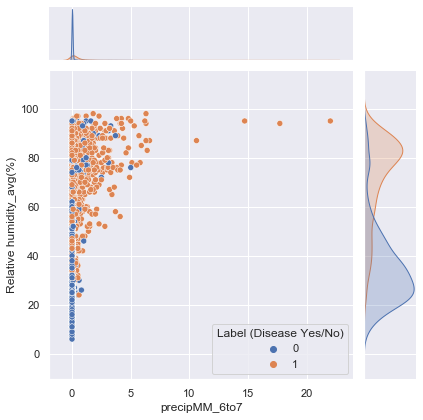

<Figure size 2160x1440 with 0 Axes>

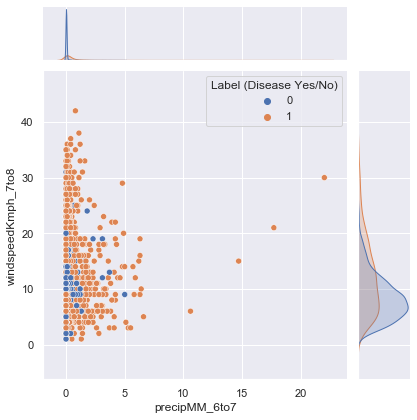

<Figure size 2160x1440 with 0 Axes>

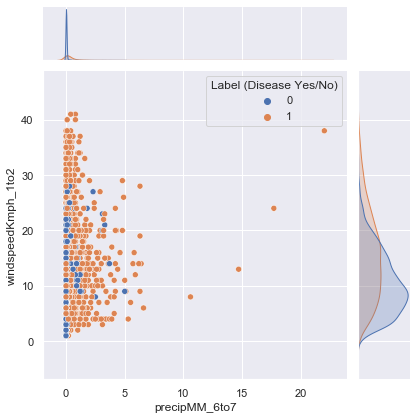

<Figure size 2160x1440 with 0 Axes>

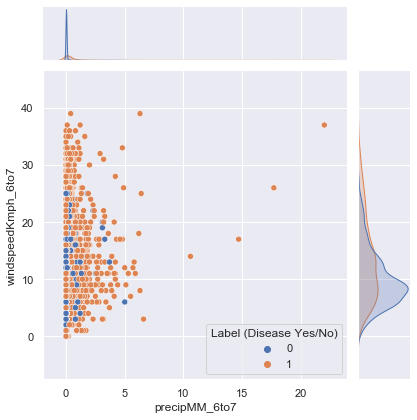

<Figure size 2160x1440 with 0 Axes>

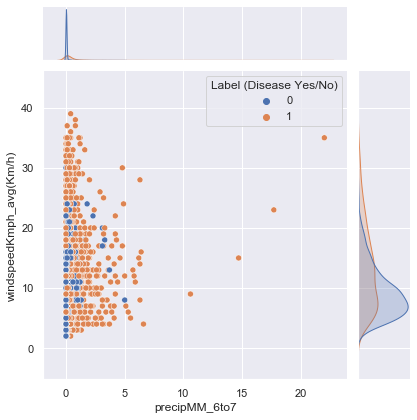

<Figure size 2160x1440 with 0 Axes>

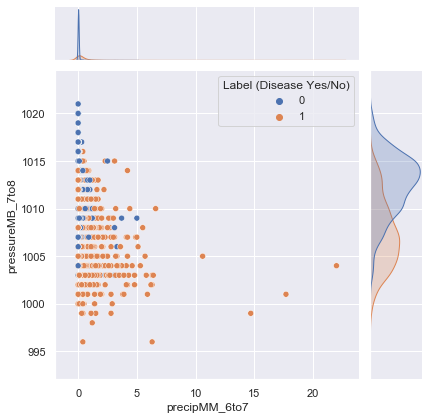

<Figure size 2160x1440 with 0 Axes>

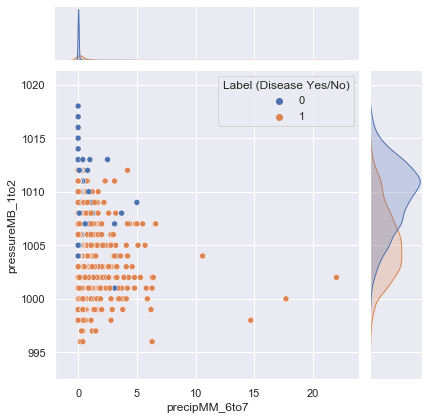

<Figure size 2160x1440 with 0 Axes>

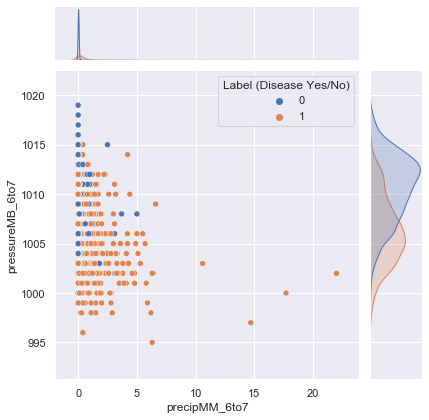

<Figure size 2160x1440 with 0 Axes>

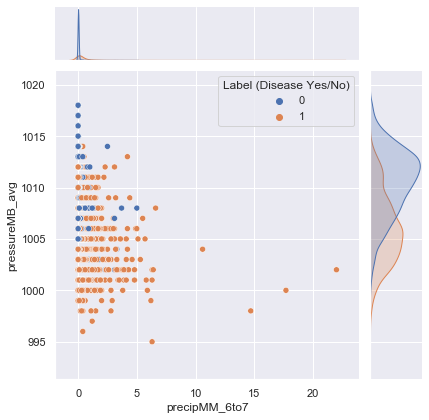

<Figure size 2160x1440 with 0 Axes>

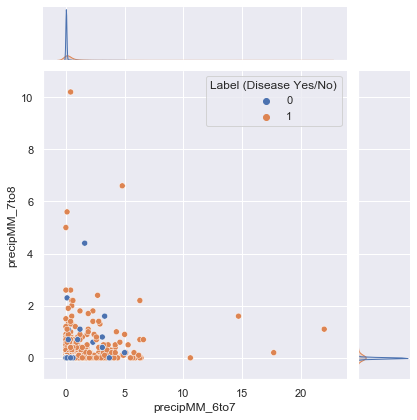

<Figure size 2160x1440 with 0 Axes>

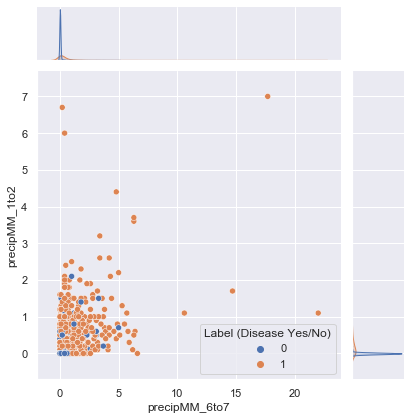

<Figure size 2160x1440 with 0 Axes>

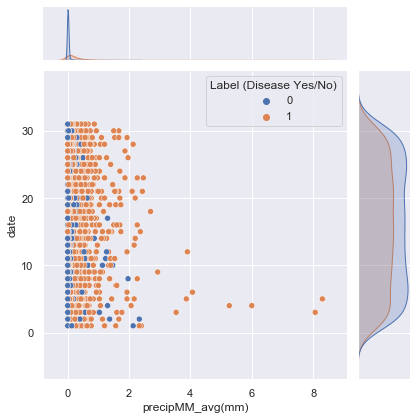

<Figure size 2160x1440 with 0 Axes>

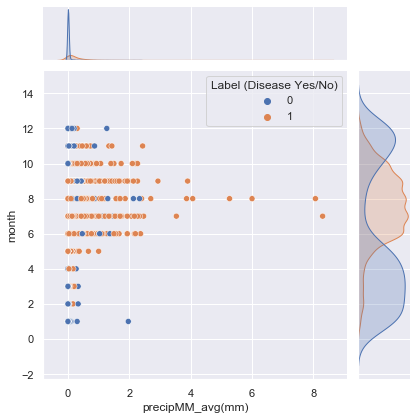

<Figure size 2160x1440 with 0 Axes>

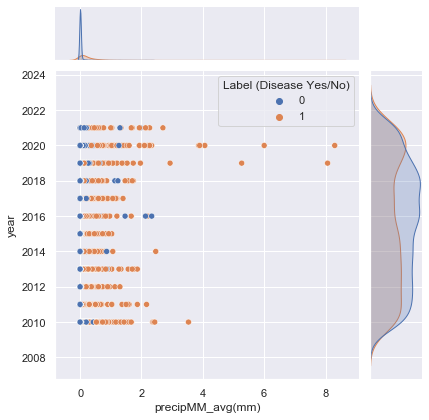

<Figure size 2160x1440 with 0 Axes>

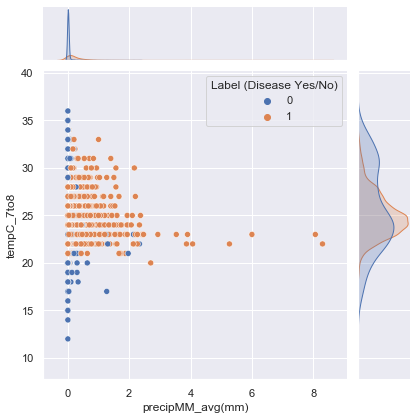

<Figure size 2160x1440 with 0 Axes>

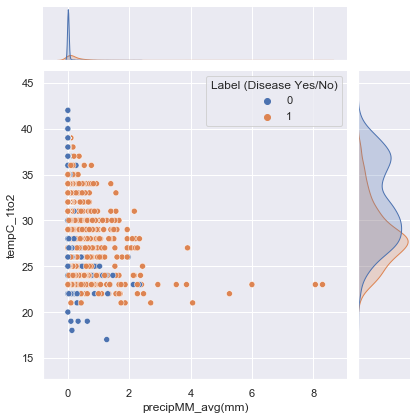

<Figure size 2160x1440 with 0 Axes>

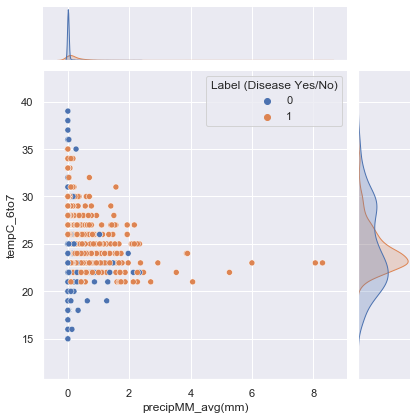

<Figure size 2160x1440 with 0 Axes>

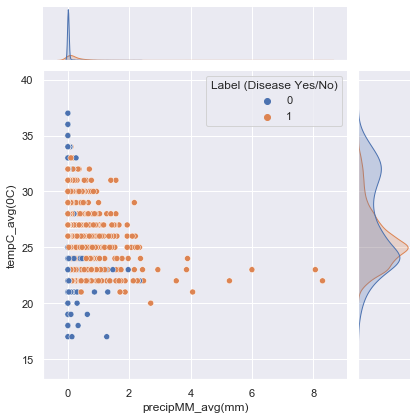

<Figure size 2160x1440 with 0 Axes>

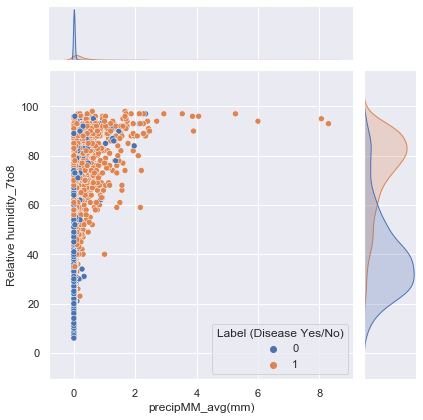

<Figure size 2160x1440 with 0 Axes>

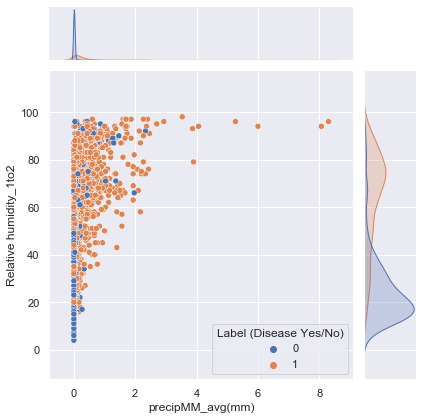

<Figure size 2160x1440 with 0 Axes>

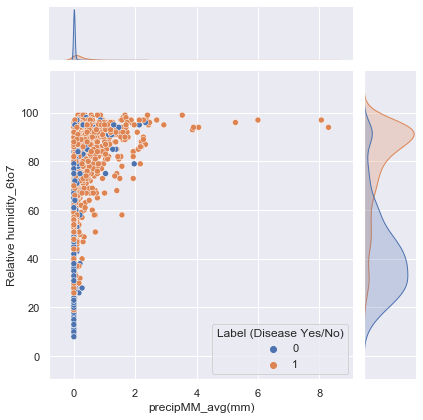

<Figure size 2160x1440 with 0 Axes>

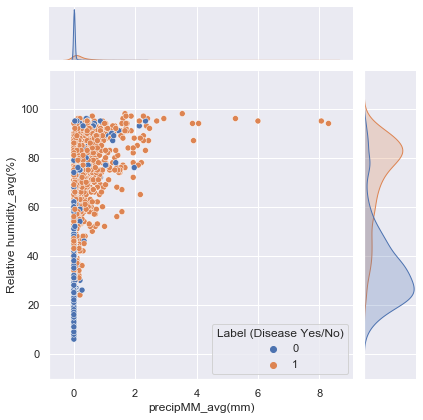

<Figure size 2160x1440 with 0 Axes>

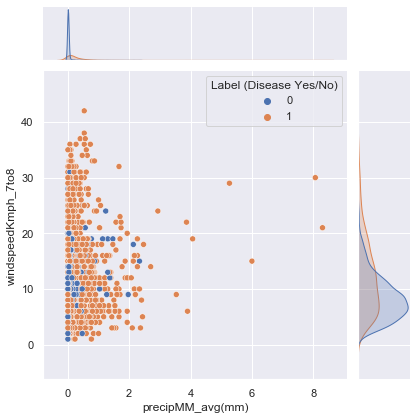

<Figure size 2160x1440 with 0 Axes>

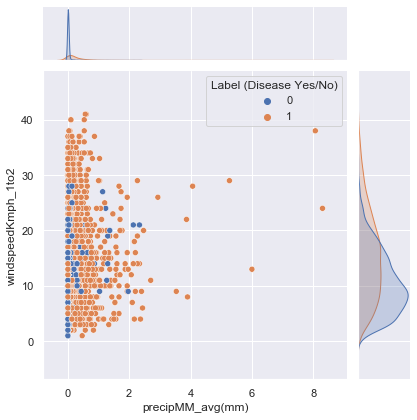

<Figure size 2160x1440 with 0 Axes>

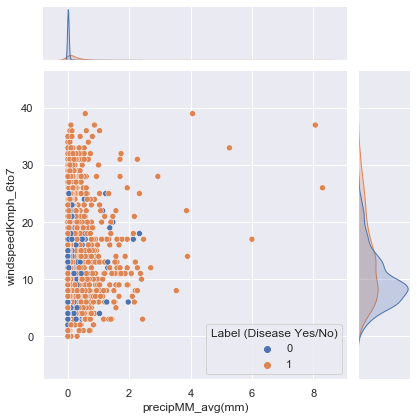

<Figure size 2160x1440 with 0 Axes>

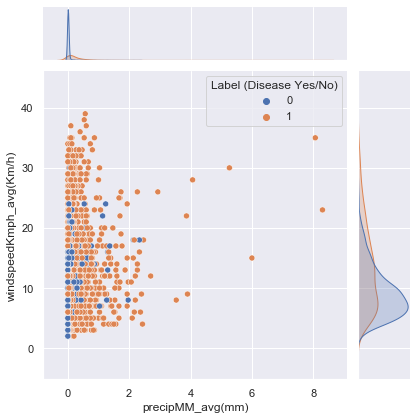

<Figure size 2160x1440 with 0 Axes>

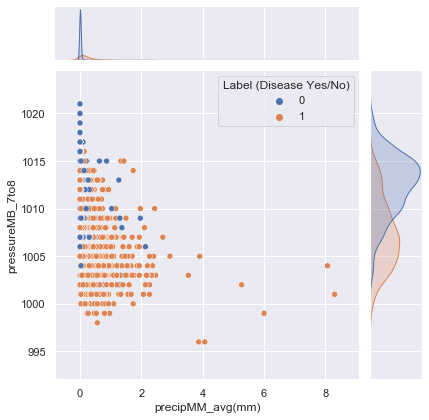

<Figure size 2160x1440 with 0 Axes>

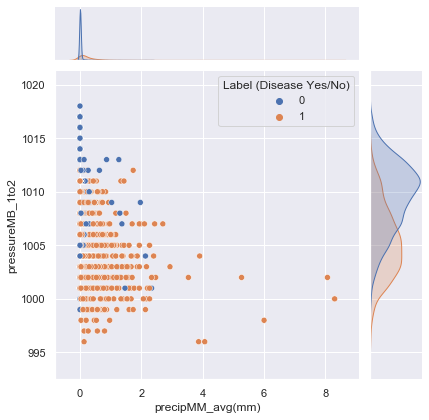

<Figure size 2160x1440 with 0 Axes>

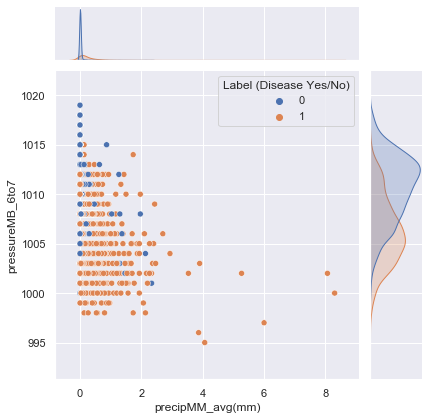

<Figure size 2160x1440 with 0 Axes>

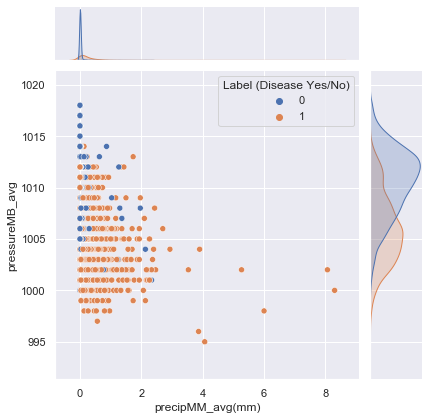

<Figure size 2160x1440 with 0 Axes>

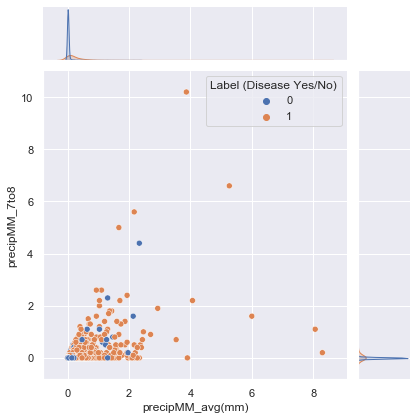

<Figure size 2160x1440 with 0 Axes>

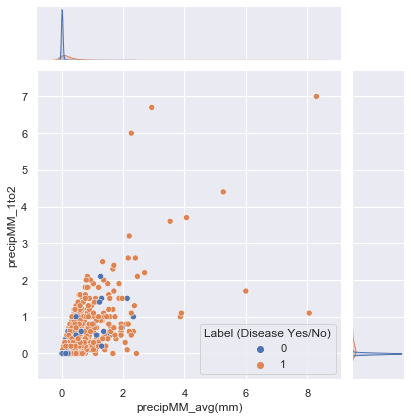

<Figure size 2160x1440 with 0 Axes>

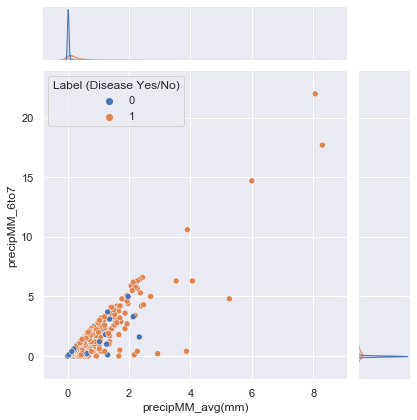

<Figure size 2160x1440 with 0 Axes>

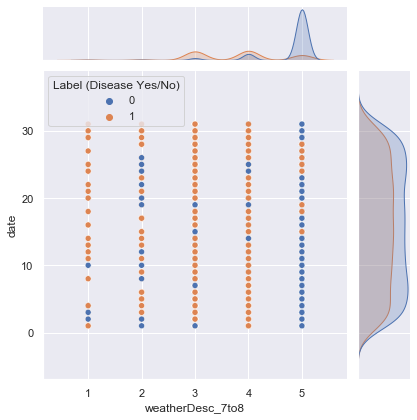

<Figure size 2160x1440 with 0 Axes>

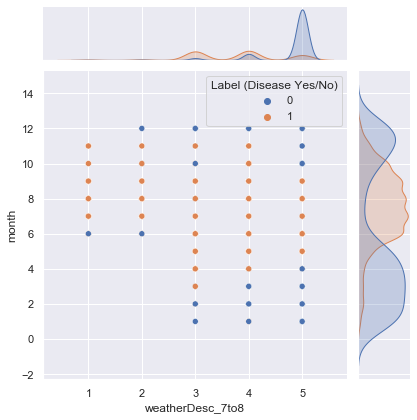

<Figure size 2160x1440 with 0 Axes>

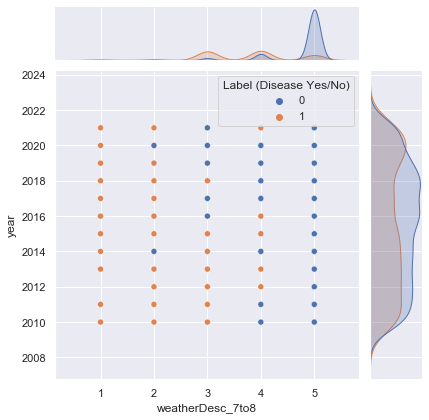

<Figure size 2160x1440 with 0 Axes>

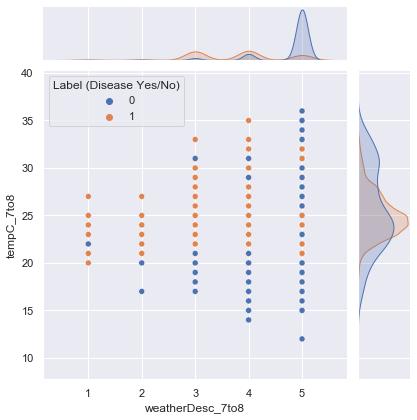

<Figure size 2160x1440 with 0 Axes>

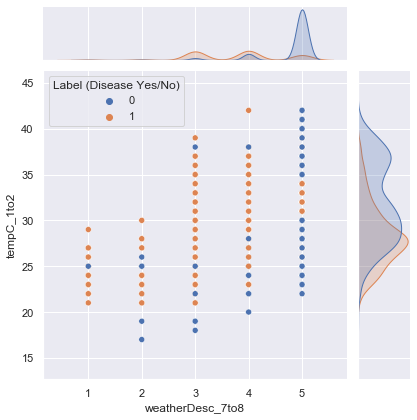

<Figure size 2160x1440 with 0 Axes>

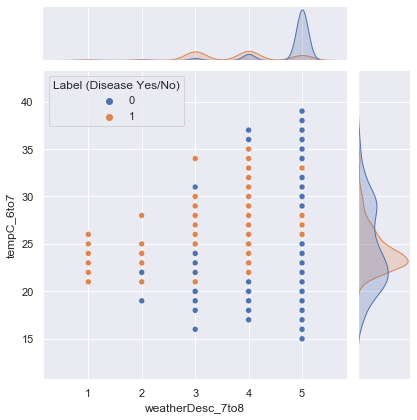

<Figure size 2160x1440 with 0 Axes>

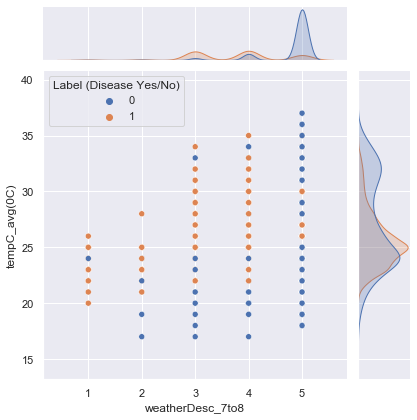

<Figure size 2160x1440 with 0 Axes>

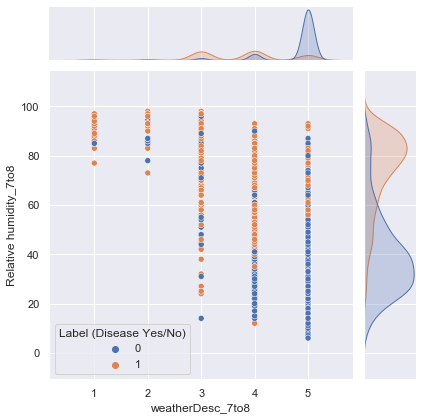

<Figure size 2160x1440 with 0 Axes>

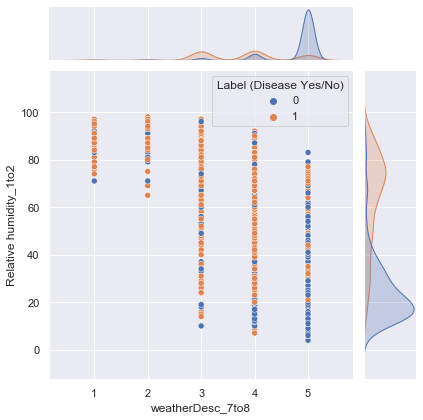

<Figure size 2160x1440 with 0 Axes>

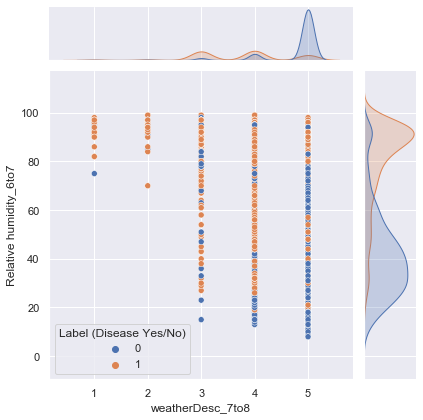

<Figure size 2160x1440 with 0 Axes>

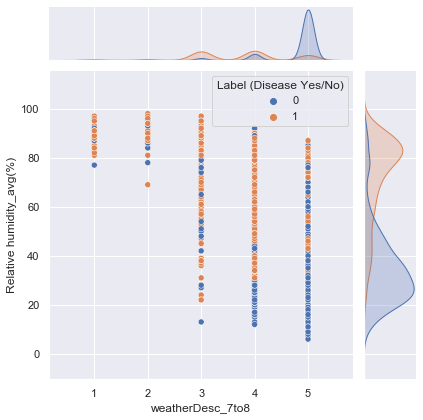

<Figure size 2160x1440 with 0 Axes>

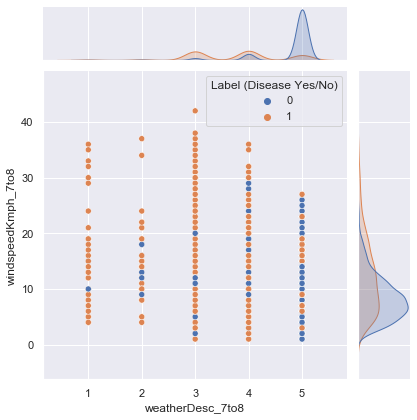

<Figure size 2160x1440 with 0 Axes>

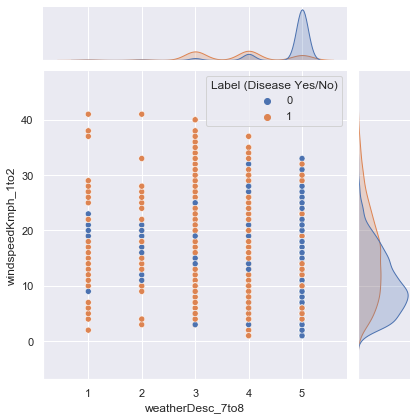

<Figure size 2160x1440 with 0 Axes>

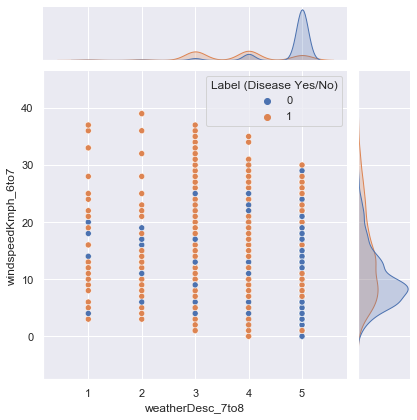

<Figure size 2160x1440 with 0 Axes>

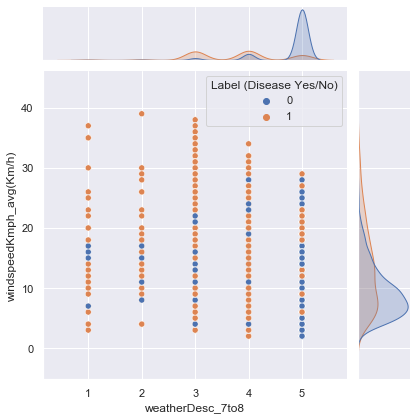

<Figure size 2160x1440 with 0 Axes>

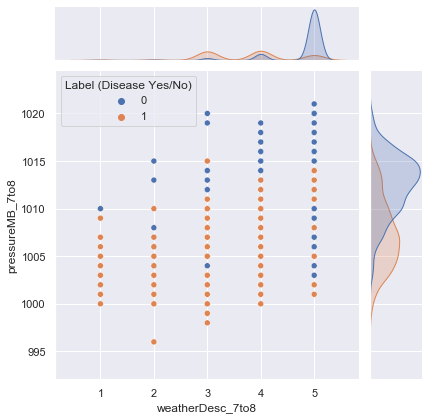

<Figure size 2160x1440 with 0 Axes>

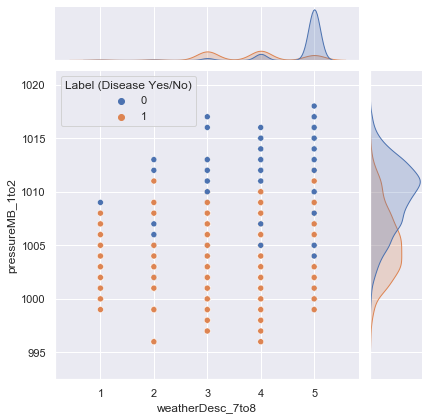

<Figure size 2160x1440 with 0 Axes>

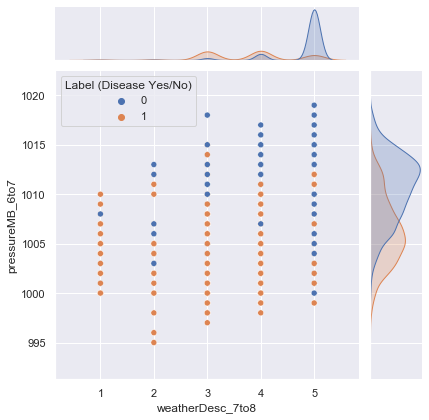

<Figure size 2160x1440 with 0 Axes>

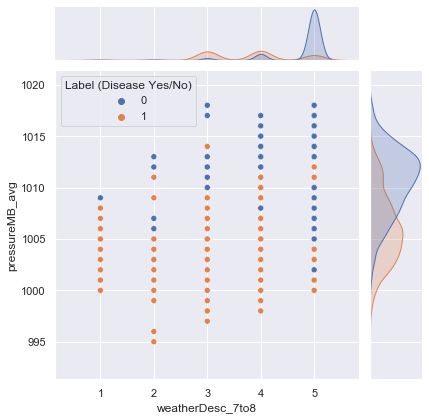

<Figure size 2160x1440 with 0 Axes>

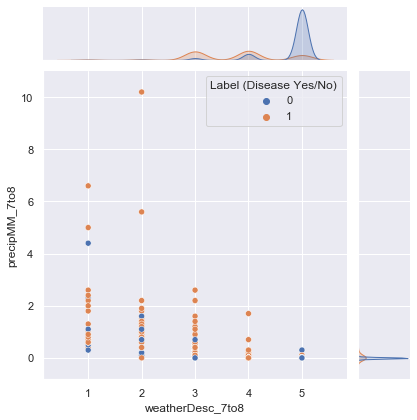

<Figure size 2160x1440 with 0 Axes>

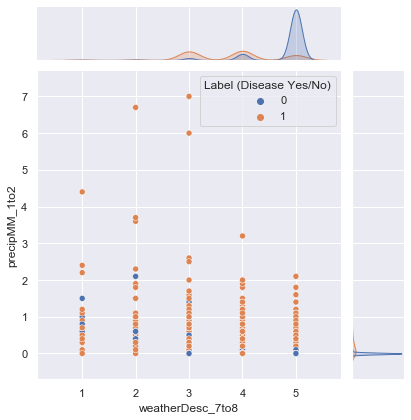

<Figure size 2160x1440 with 0 Axes>

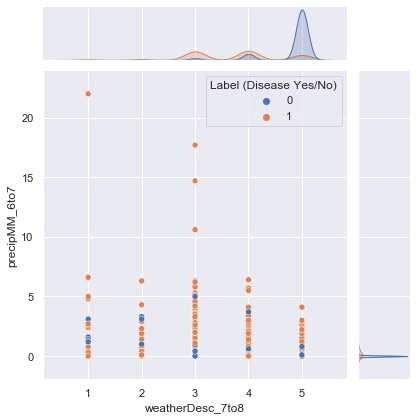

<Figure size 2160x1440 with 0 Axes>

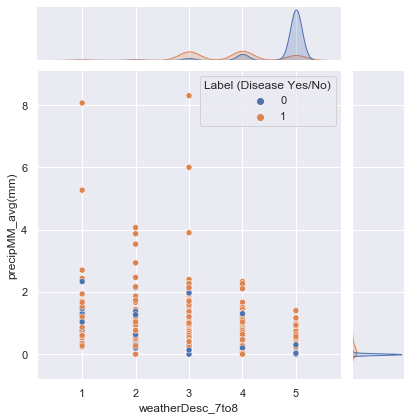

<Figure size 2160x1440 with 0 Axes>

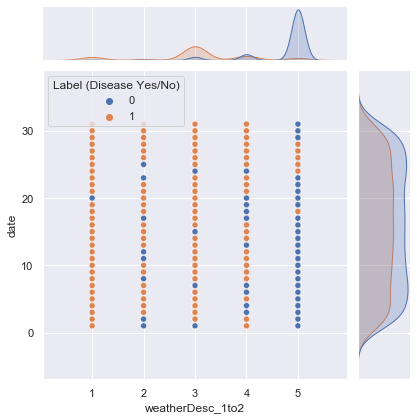

<Figure size 2160x1440 with 0 Axes>

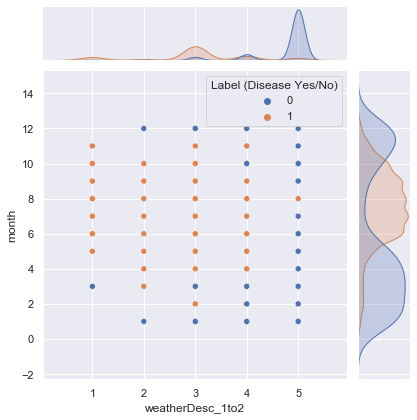

<Figure size 2160x1440 with 0 Axes>

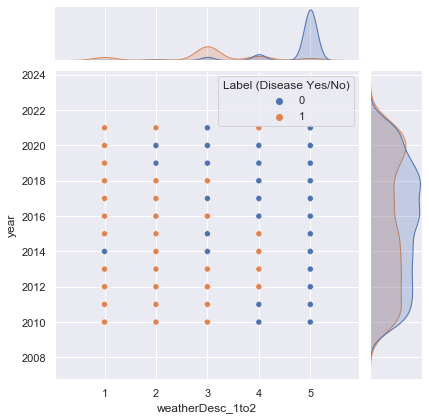

<Figure size 2160x1440 with 0 Axes>

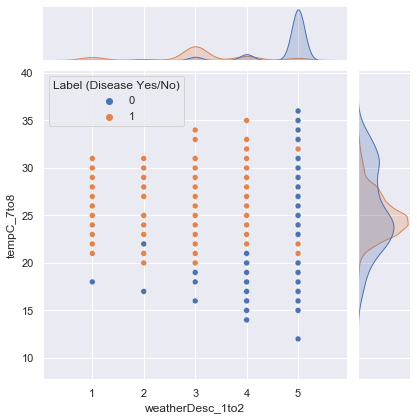

<Figure size 2160x1440 with 0 Axes>

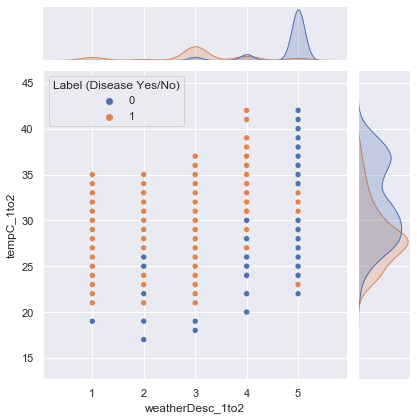

<Figure size 2160x1440 with 0 Axes>

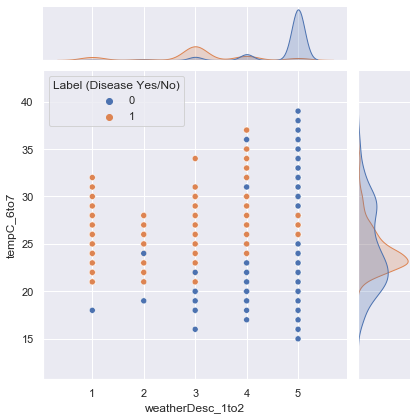

<Figure size 2160x1440 with 0 Axes>

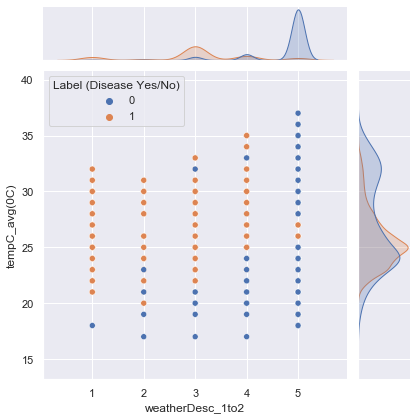

<Figure size 2160x1440 with 0 Axes>

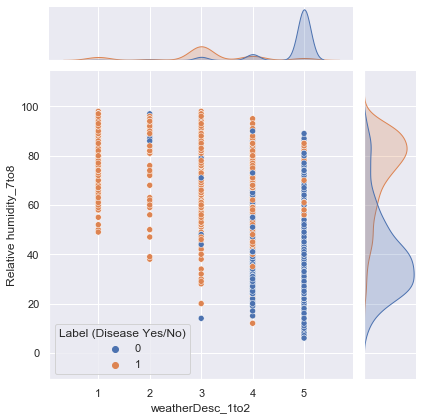

<Figure size 2160x1440 with 0 Axes>

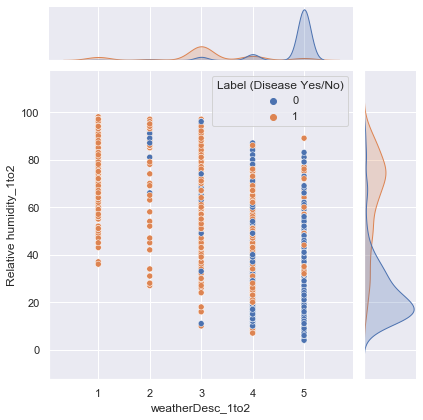

<Figure size 2160x1440 with 0 Axes>

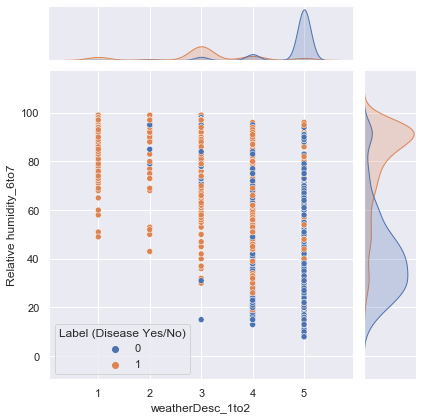

<Figure size 2160x1440 with 0 Axes>

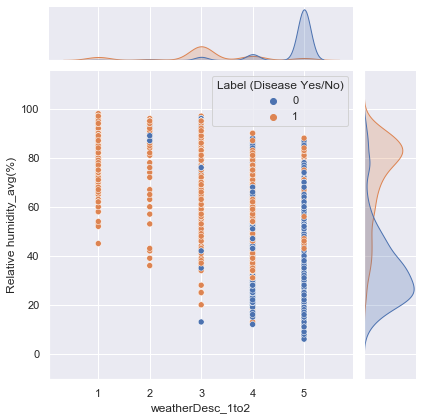

<Figure size 2160x1440 with 0 Axes>

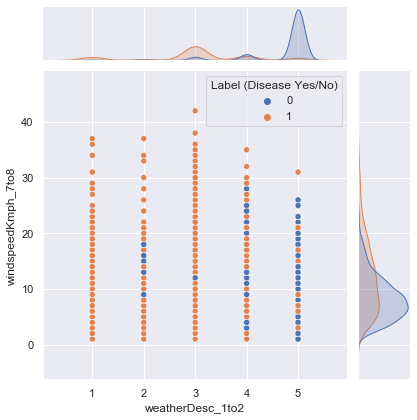

<Figure size 2160x1440 with 0 Axes>

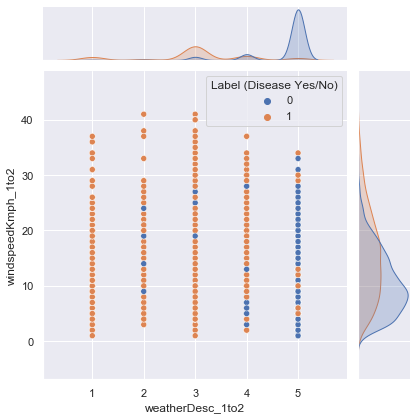

<Figure size 2160x1440 with 0 Axes>

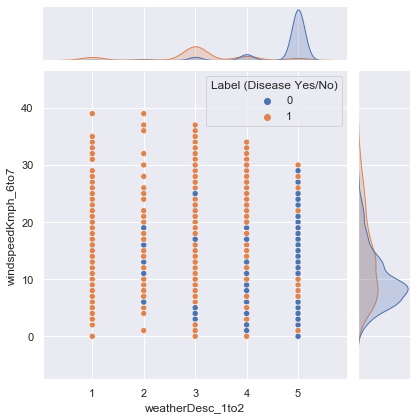

<Figure size 2160x1440 with 0 Axes>

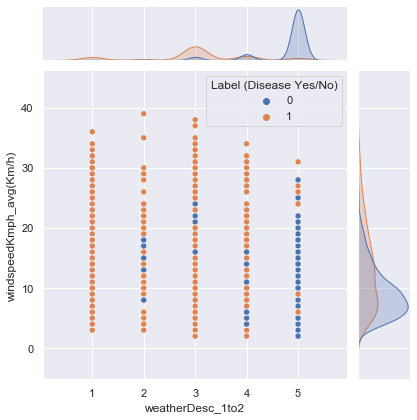

<Figure size 2160x1440 with 0 Axes>

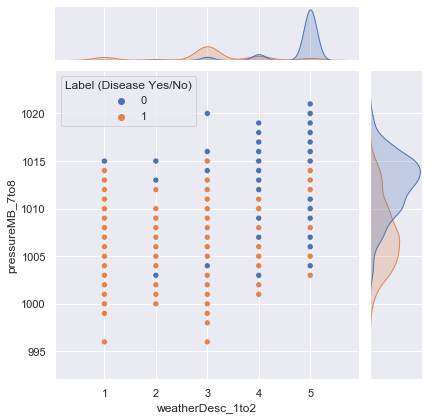

<Figure size 2160x1440 with 0 Axes>

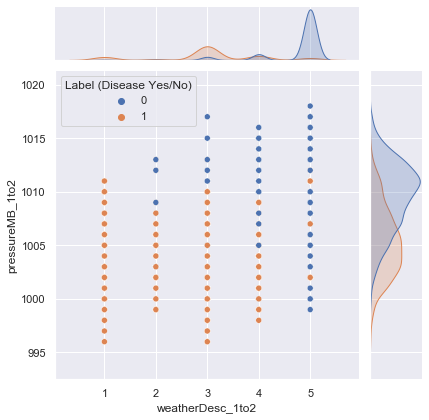

<Figure size 2160x1440 with 0 Axes>

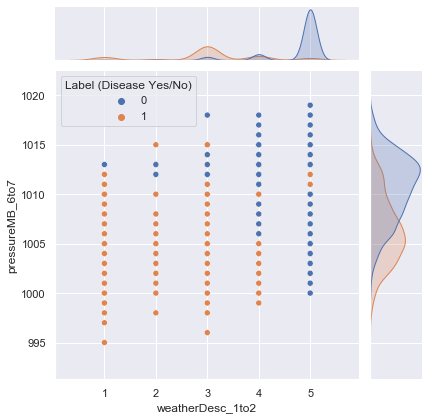

<Figure size 2160x1440 with 0 Axes>

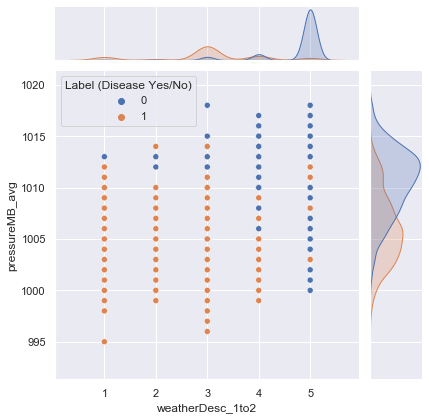

<Figure size 2160x1440 with 0 Axes>

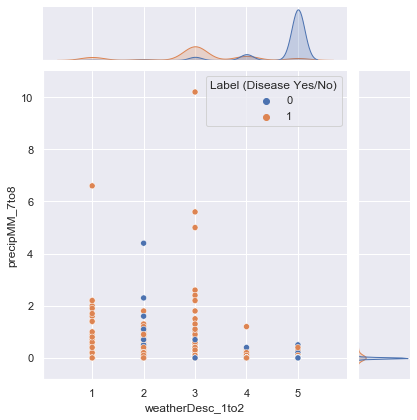

<Figure size 2160x1440 with 0 Axes>

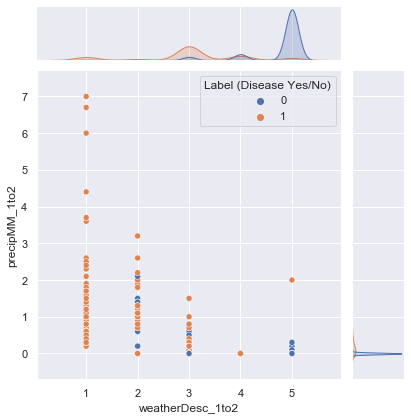

<Figure size 2160x1440 with 0 Axes>

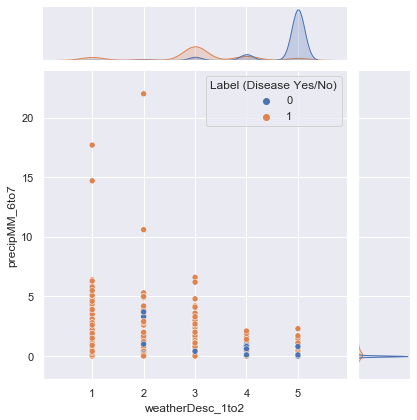

<Figure size 2160x1440 with 0 Axes>

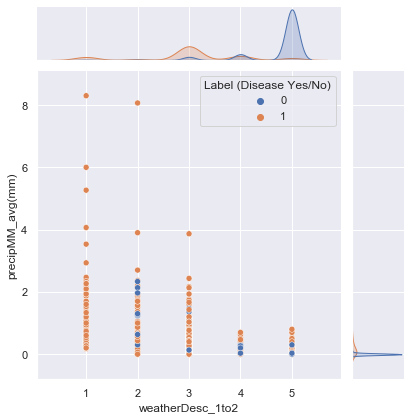

<Figure size 2160x1440 with 0 Axes>

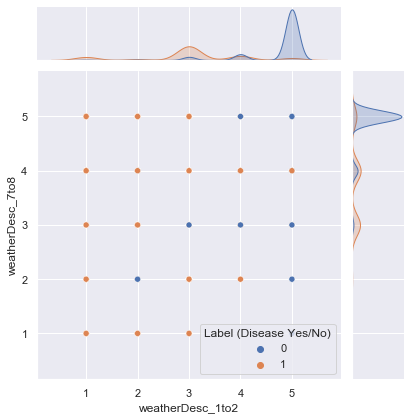

<Figure size 2160x1440 with 0 Axes>

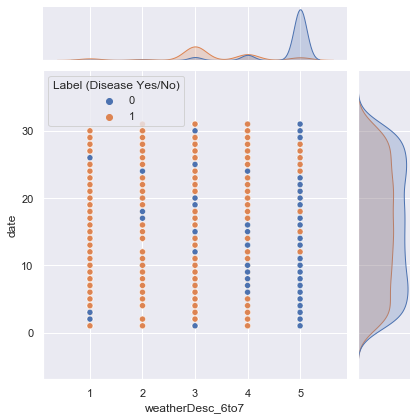

<Figure size 2160x1440 with 0 Axes>

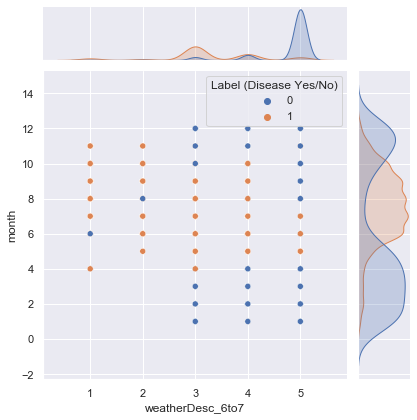

<Figure size 2160x1440 with 0 Axes>

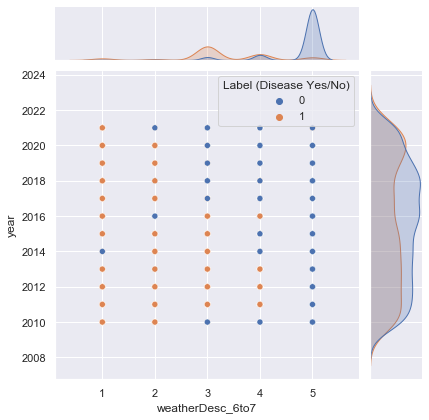

<Figure size 2160x1440 with 0 Axes>

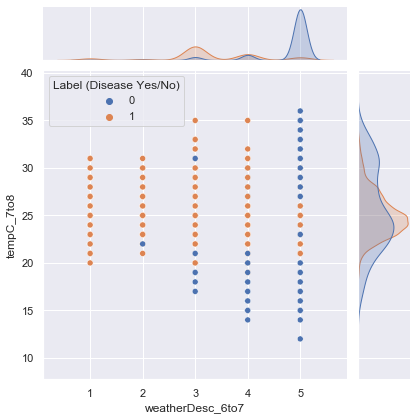

<Figure size 2160x1440 with 0 Axes>

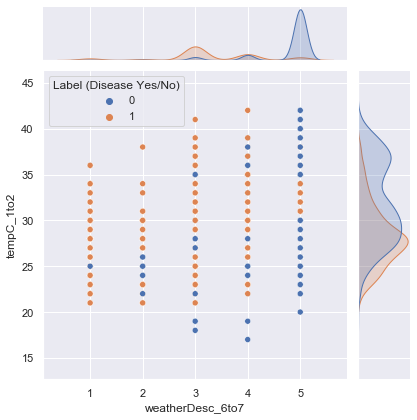

<Figure size 2160x1440 with 0 Axes>

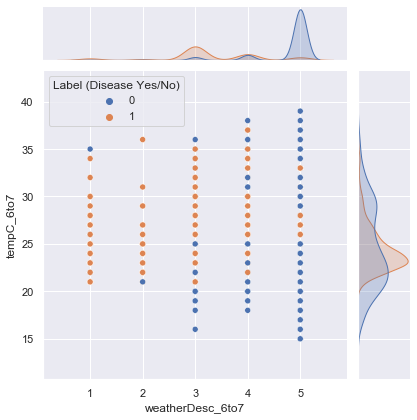

<Figure size 2160x1440 with 0 Axes>

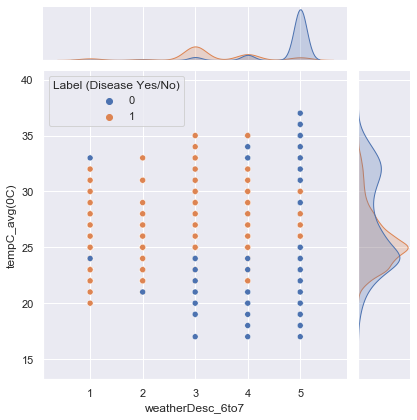

<Figure size 2160x1440 with 0 Axes>

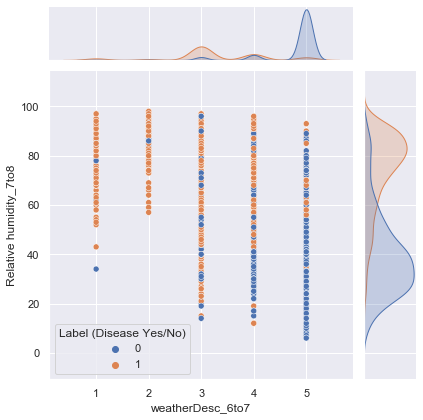

<Figure size 2160x1440 with 0 Axes>

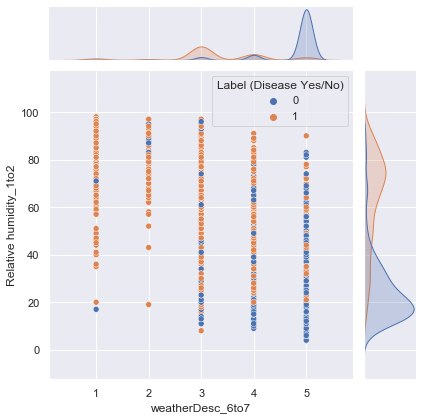

<Figure size 2160x1440 with 0 Axes>

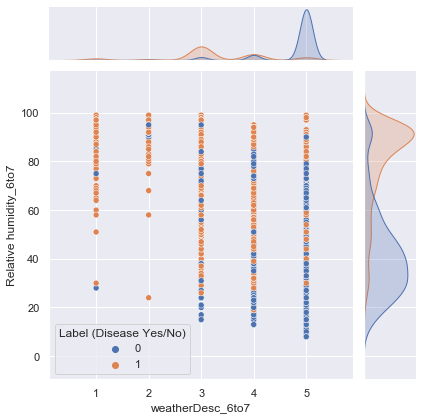

<Figure size 2160x1440 with 0 Axes>

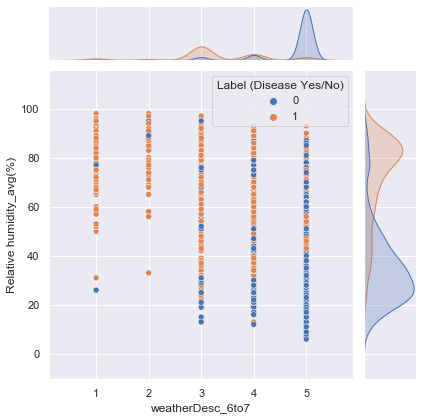

<Figure size 2160x1440 with 0 Axes>

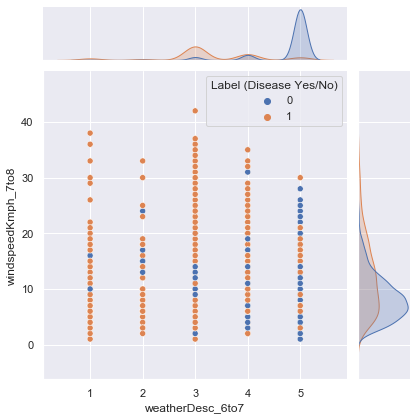

<Figure size 2160x1440 with 0 Axes>

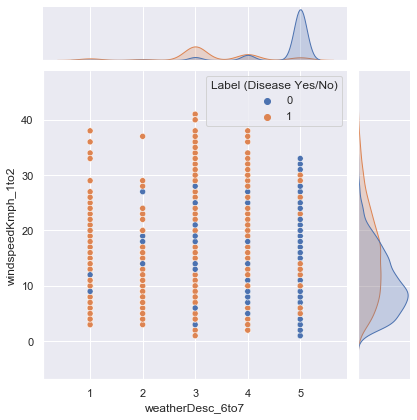

<Figure size 2160x1440 with 0 Axes>

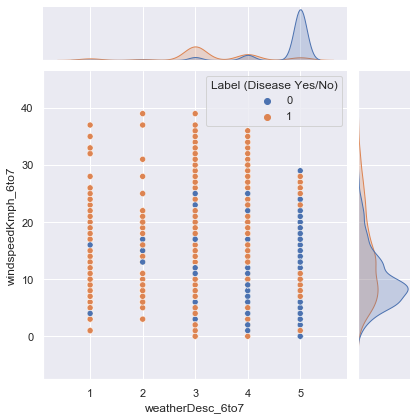

<Figure size 2160x1440 with 0 Axes>

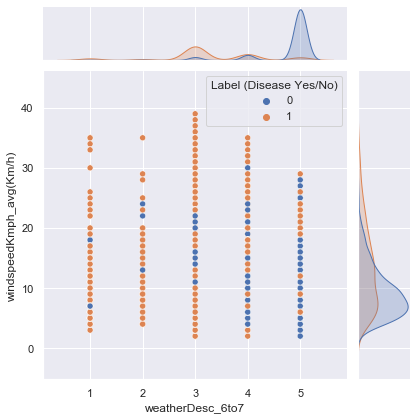

<Figure size 2160x1440 with 0 Axes>

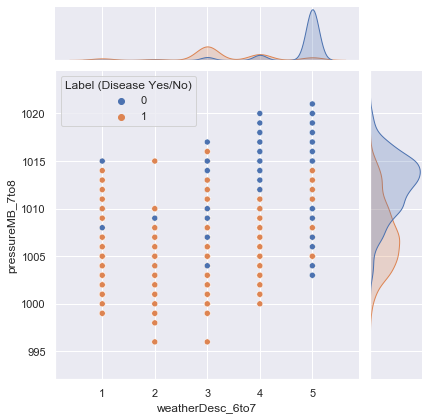

<Figure size 2160x1440 with 0 Axes>

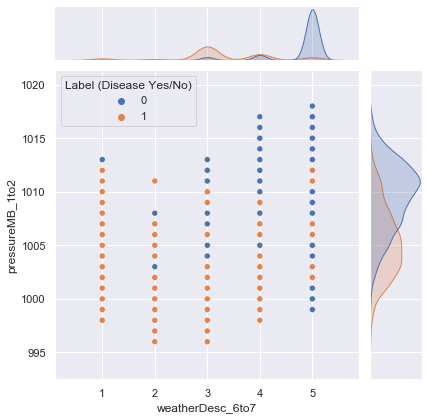

<Figure size 2160x1440 with 0 Axes>

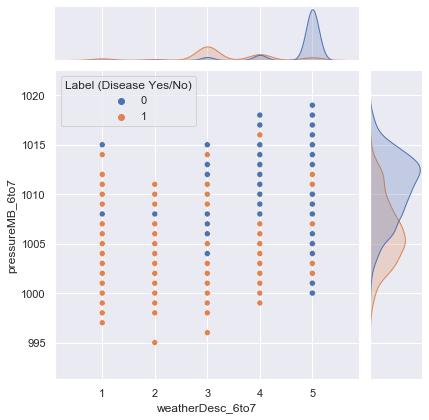

<Figure size 2160x1440 with 0 Axes>

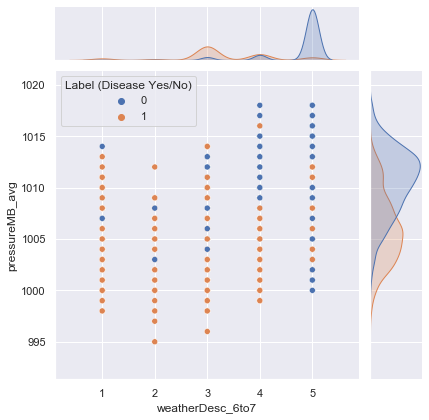

<Figure size 2160x1440 with 0 Axes>

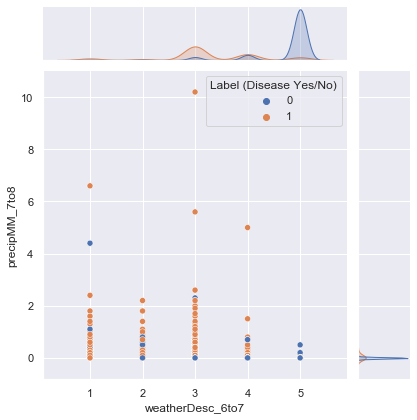

<Figure size 2160x1440 with 0 Axes>

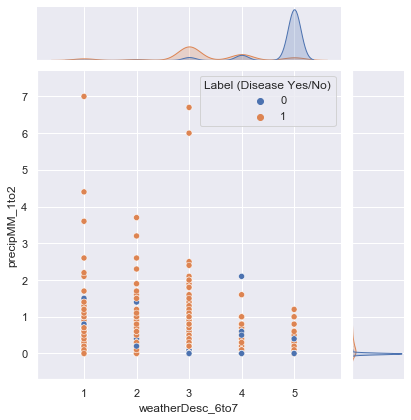

<Figure size 2160x1440 with 0 Axes>

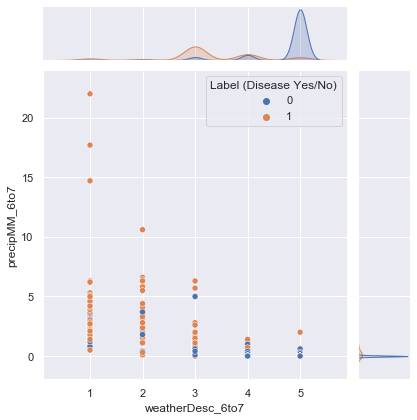

<Figure size 2160x1440 with 0 Axes>

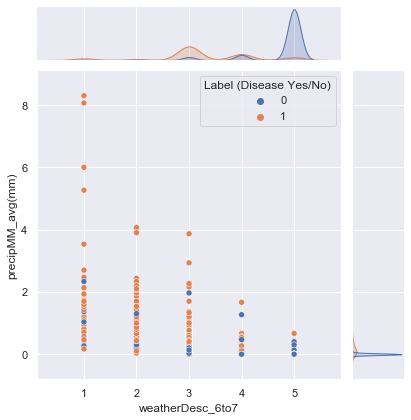

<Figure size 2160x1440 with 0 Axes>

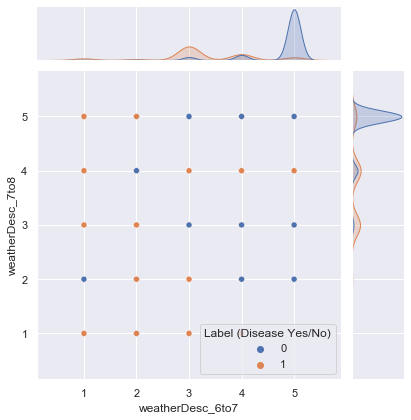

<Figure size 2160x1440 with 0 Axes>

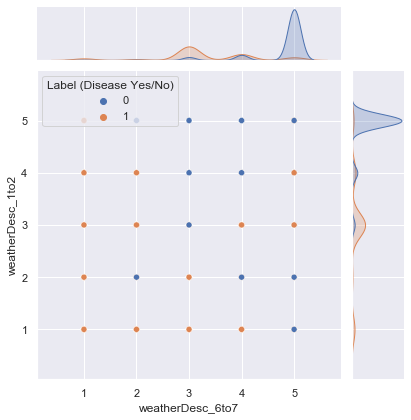

<Figure size 2160x1440 with 0 Axes>

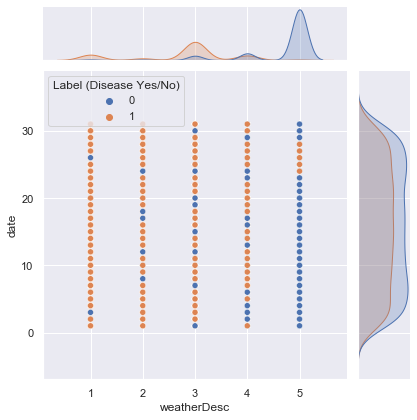

<Figure size 2160x1440 with 0 Axes>

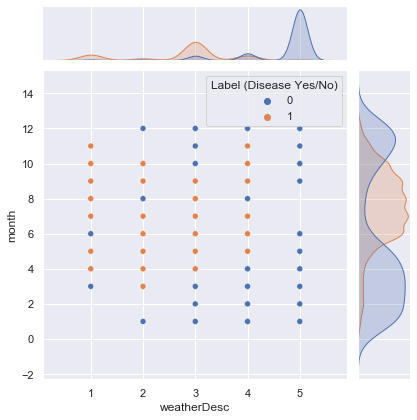

<Figure size 2160x1440 with 0 Axes>

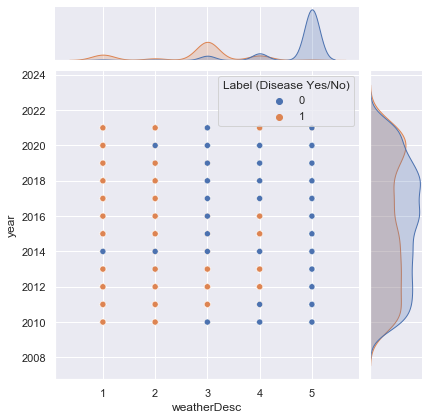

<Figure size 2160x1440 with 0 Axes>

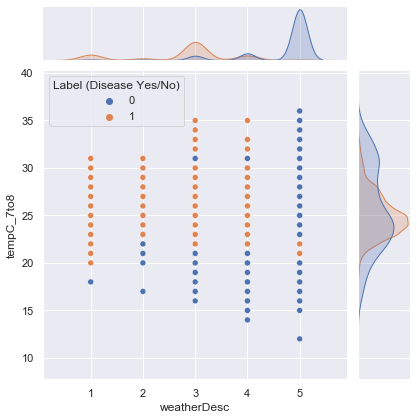

<Figure size 2160x1440 with 0 Axes>

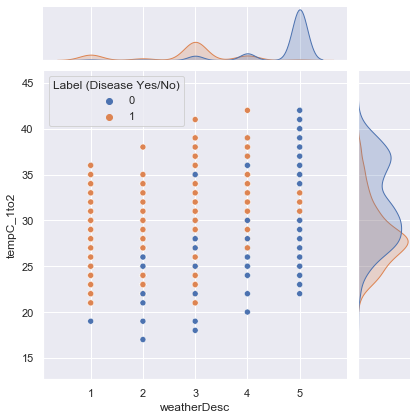

<Figure size 2160x1440 with 0 Axes>

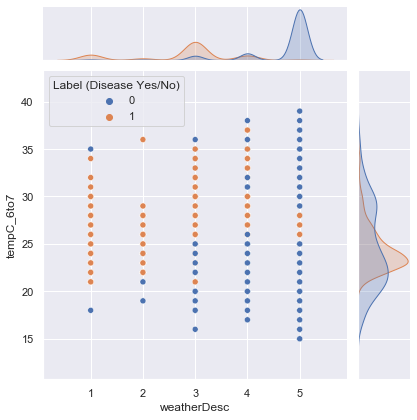

<Figure size 2160x1440 with 0 Axes>

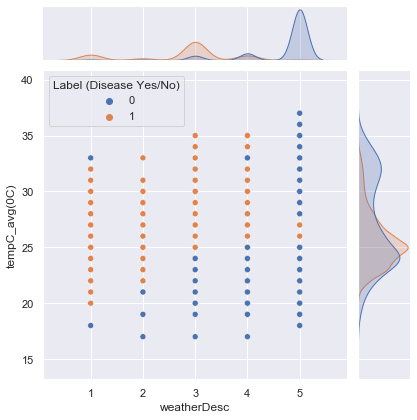

<Figure size 2160x1440 with 0 Axes>

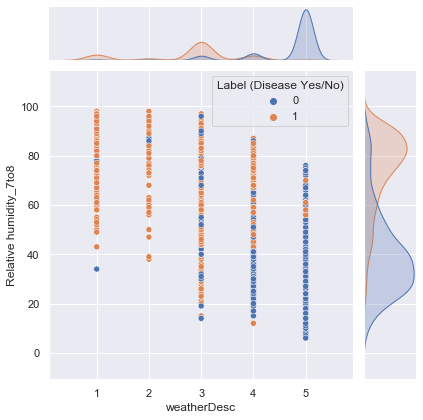

<Figure size 2160x1440 with 0 Axes>

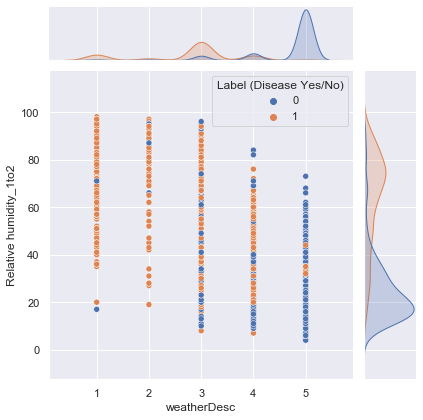

<Figure size 2160x1440 with 0 Axes>

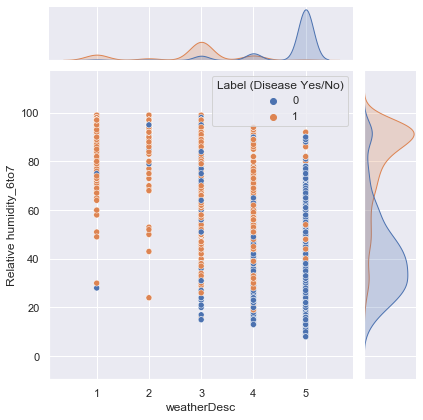

<Figure size 2160x1440 with 0 Axes>

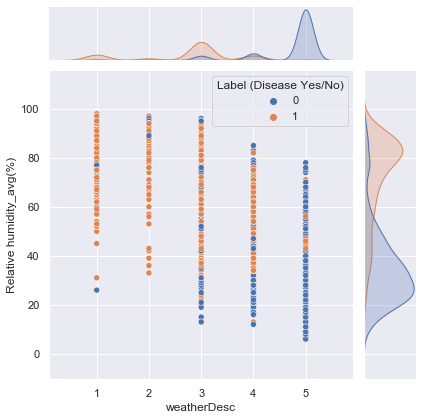

<Figure size 2160x1440 with 0 Axes>

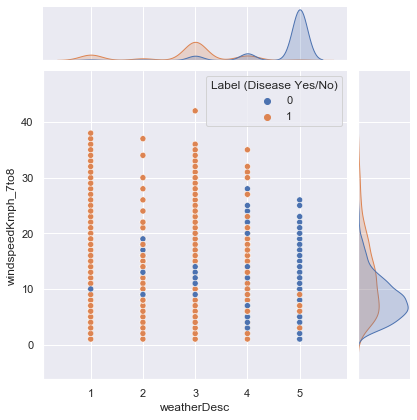

<Figure size 2160x1440 with 0 Axes>

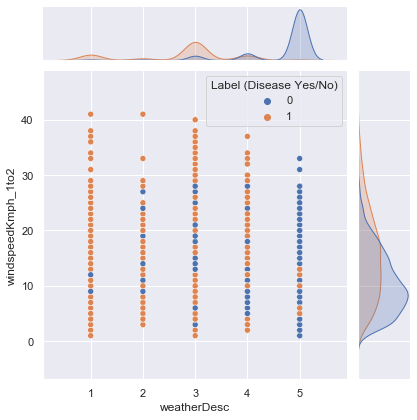

<Figure size 2160x1440 with 0 Axes>

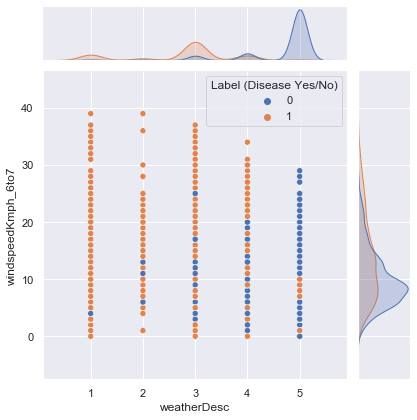

<Figure size 2160x1440 with 0 Axes>

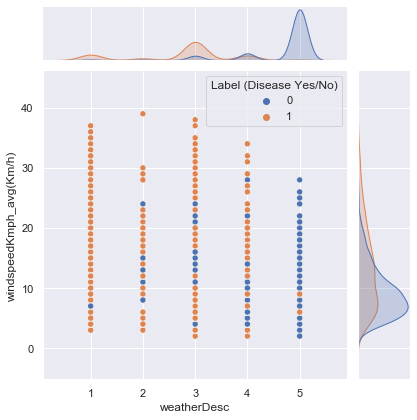

<Figure size 2160x1440 with 0 Axes>

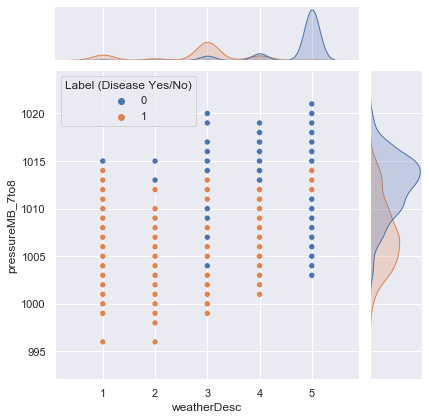

<Figure size 2160x1440 with 0 Axes>

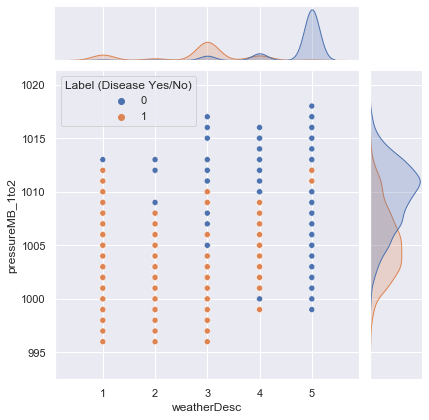

<Figure size 2160x1440 with 0 Axes>

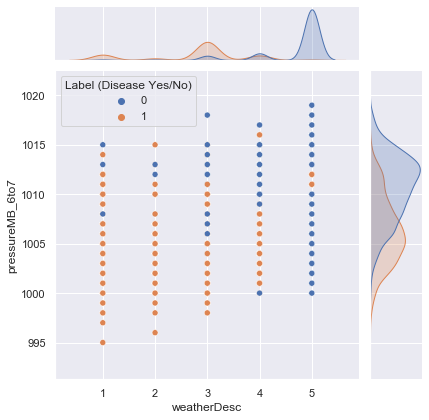

<Figure size 2160x1440 with 0 Axes>

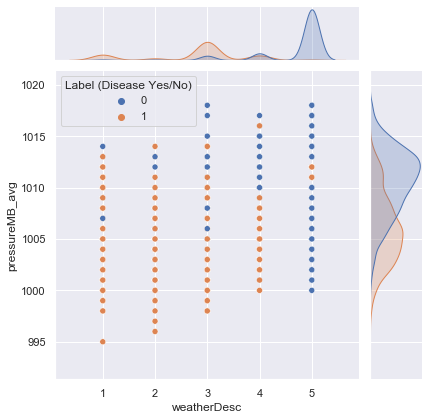

<Figure size 2160x1440 with 0 Axes>

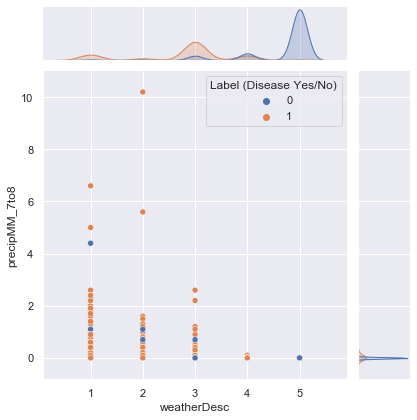

<Figure size 2160x1440 with 0 Axes>

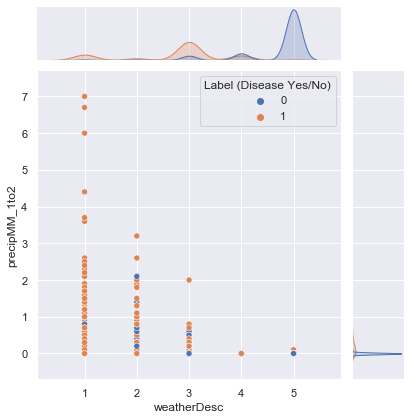

<Figure size 2160x1440 with 0 Axes>

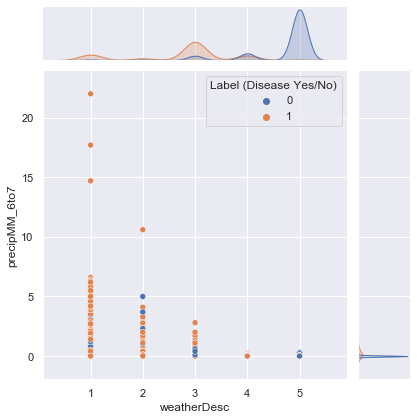

<Figure size 2160x1440 with 0 Axes>

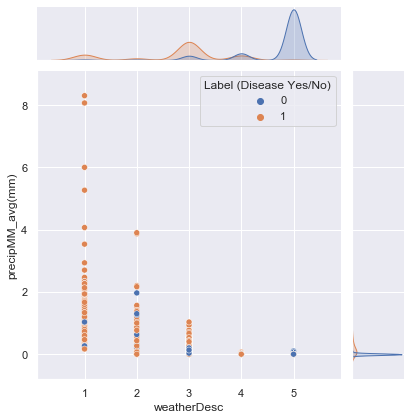

<Figure size 2160x1440 with 0 Axes>

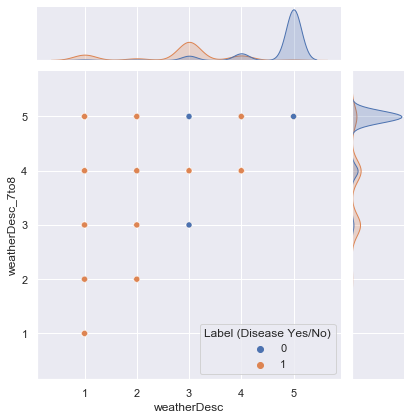

<Figure size 2160x1440 with 0 Axes>

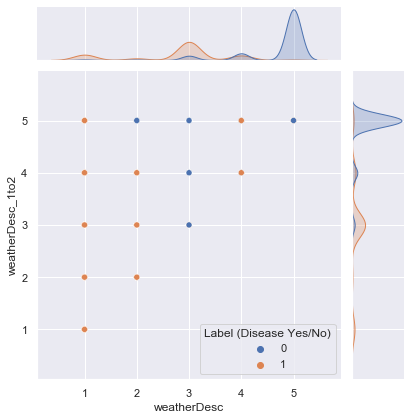

<Figure size 2160x1440 with 0 Axes>

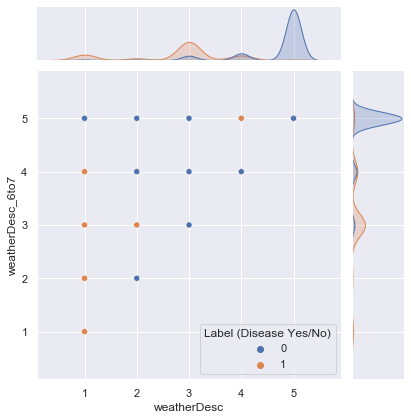

<Figure size 2160x1440 with 0 Axes>

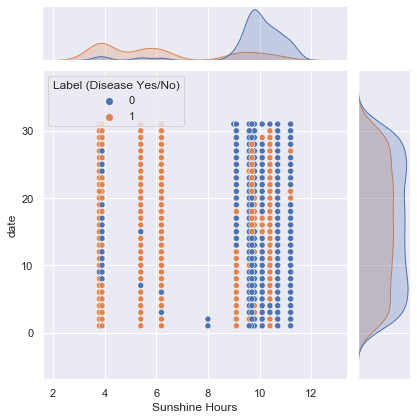

<Figure size 2160x1440 with 0 Axes>

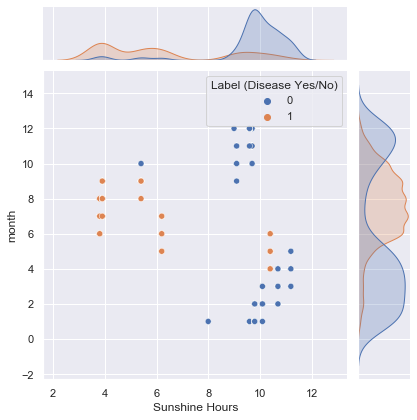

<Figure size 2160x1440 with 0 Axes>

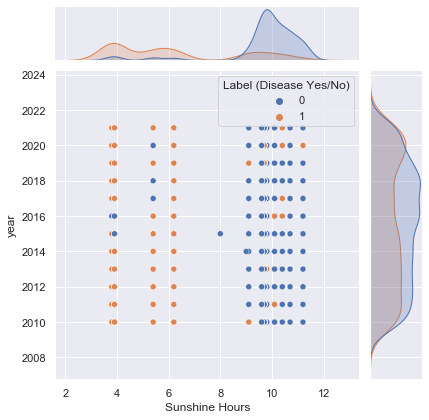

<Figure size 2160x1440 with 0 Axes>

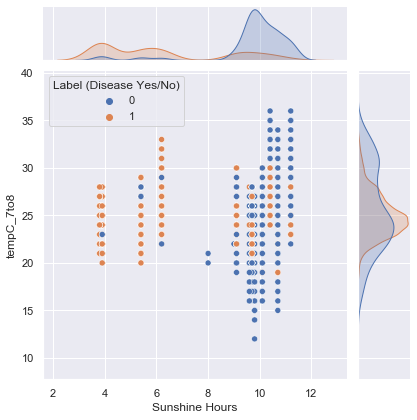

<Figure size 2160x1440 with 0 Axes>

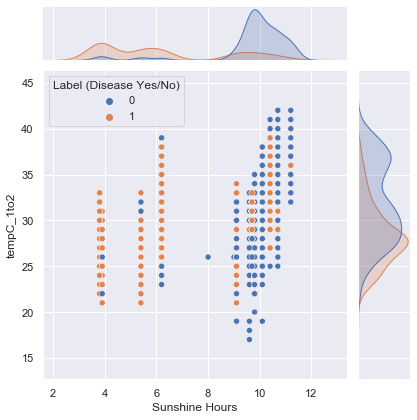

<Figure size 2160x1440 with 0 Axes>

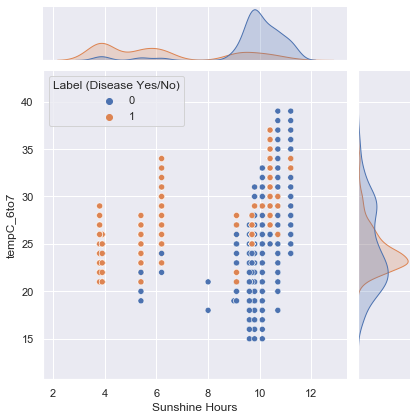

<Figure size 2160x1440 with 0 Axes>

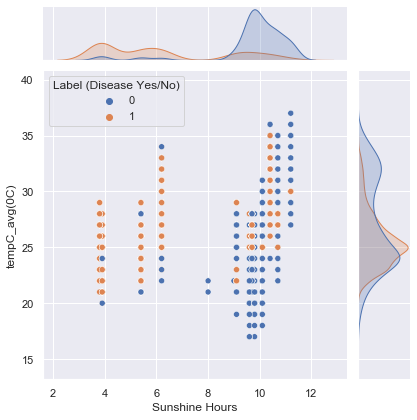

<Figure size 2160x1440 with 0 Axes>

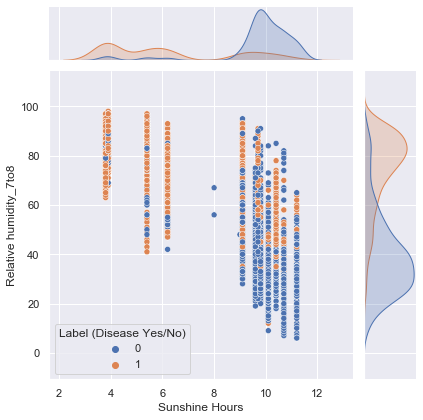

<Figure size 2160x1440 with 0 Axes>

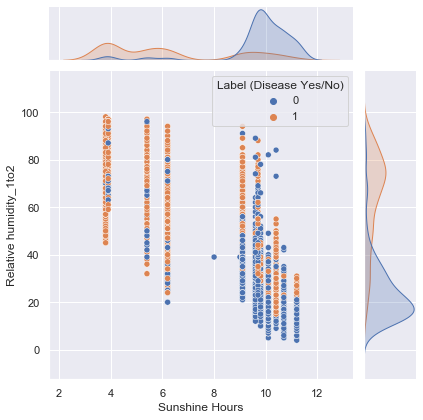

<Figure size 2160x1440 with 0 Axes>

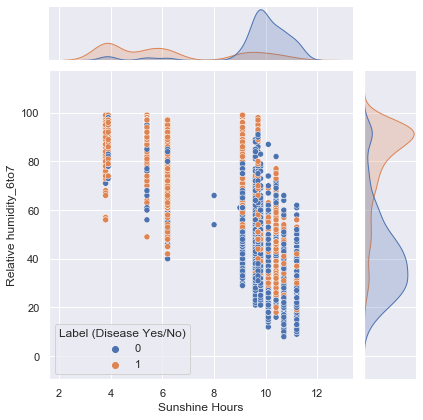

<Figure size 2160x1440 with 0 Axes>

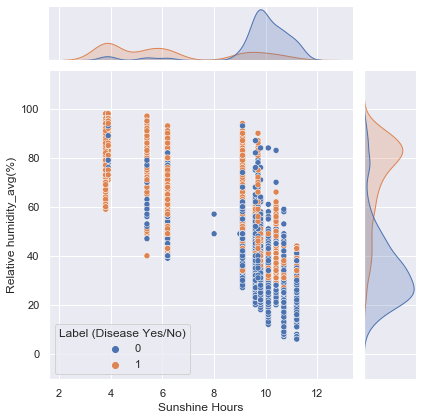

<Figure size 2160x1440 with 0 Axes>

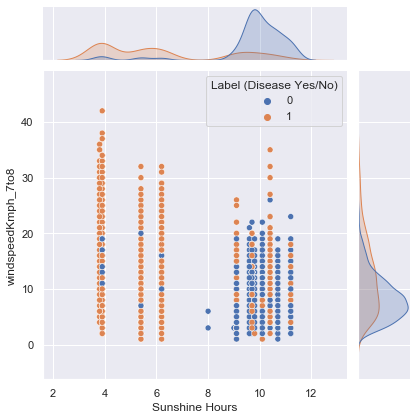

<Figure size 2160x1440 with 0 Axes>

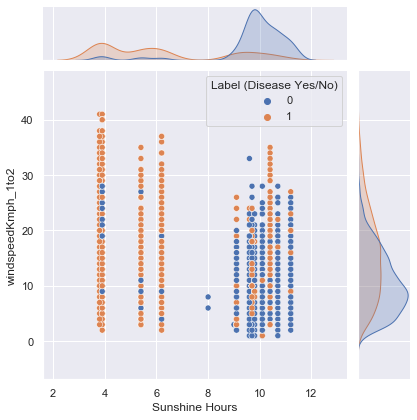

<Figure size 2160x1440 with 0 Axes>

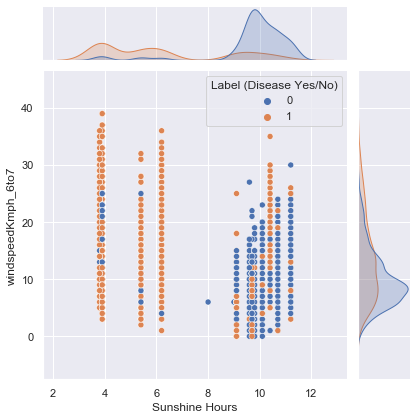

<Figure size 2160x1440 with 0 Axes>

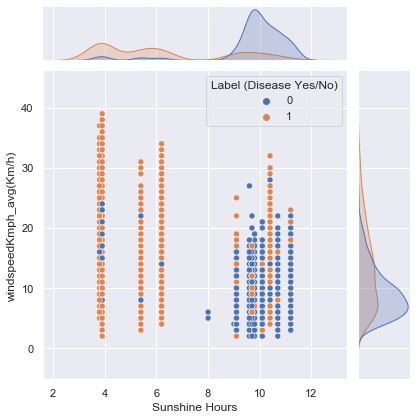

<Figure size 2160x1440 with 0 Axes>

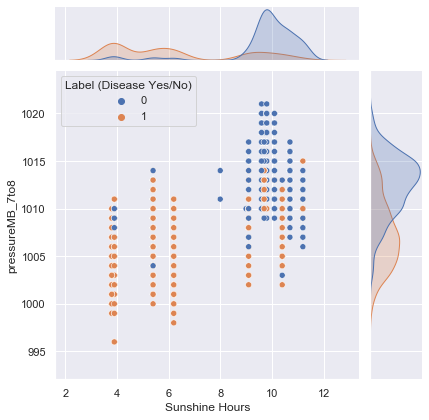

<Figure size 2160x1440 with 0 Axes>

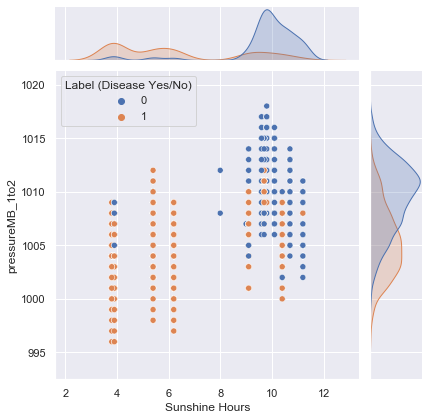

<Figure size 2160x1440 with 0 Axes>

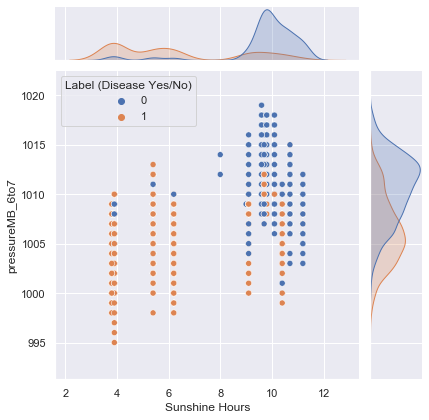

<Figure size 2160x1440 with 0 Axes>

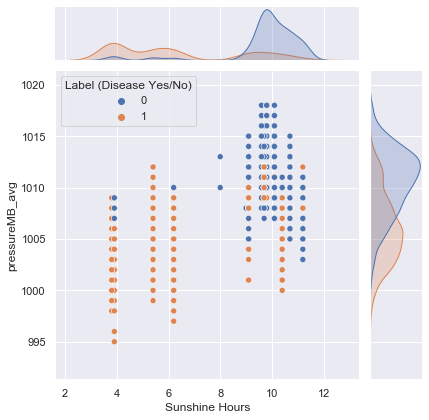

<Figure size 2160x1440 with 0 Axes>

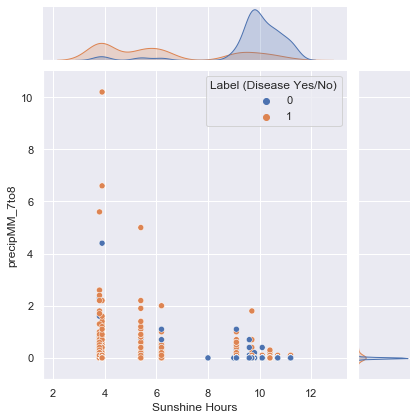

<Figure size 2160x1440 with 0 Axes>

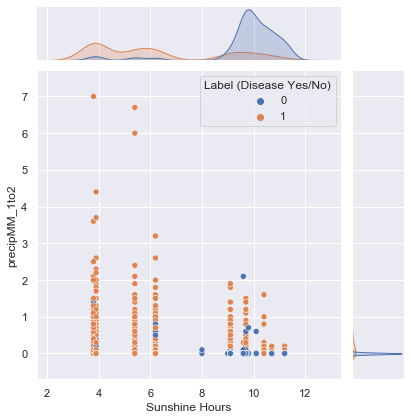

<Figure size 2160x1440 with 0 Axes>

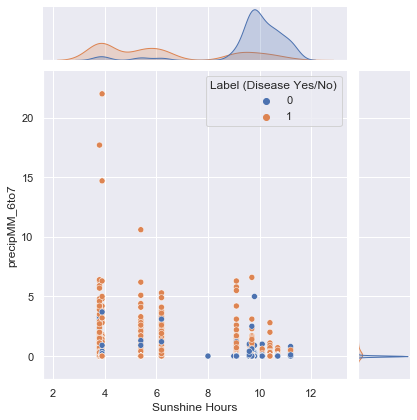

<Figure size 2160x1440 with 0 Axes>

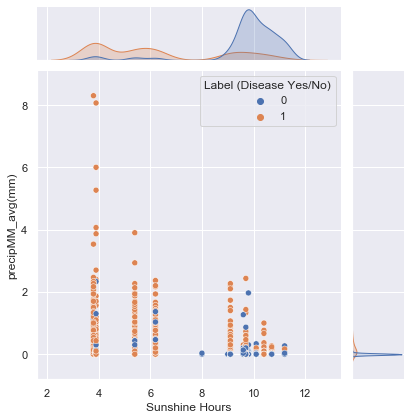

<Figure size 2160x1440 with 0 Axes>

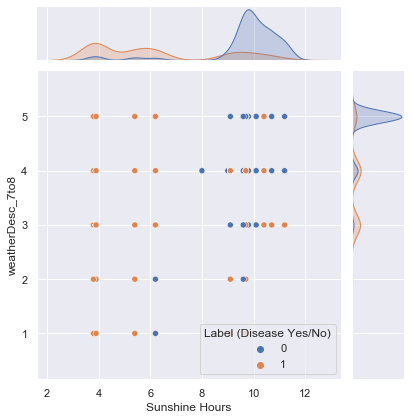

<Figure size 2160x1440 with 0 Axes>

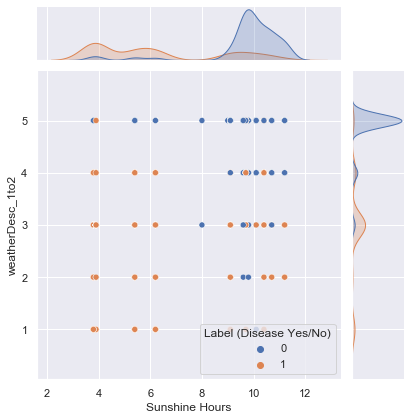

<Figure size 2160x1440 with 0 Axes>

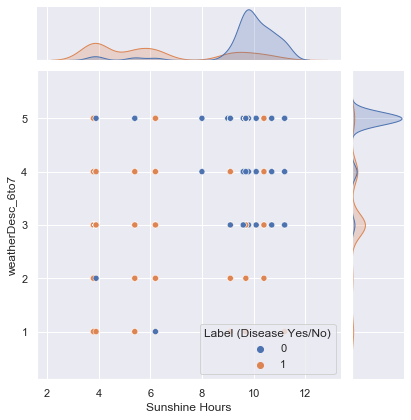

<Figure size 2160x1440 with 0 Axes>

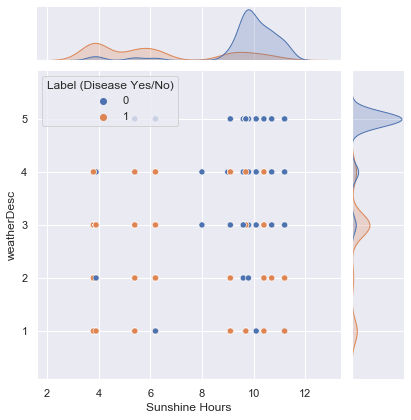

<Figure size 2160x1440 with 0 Axes>

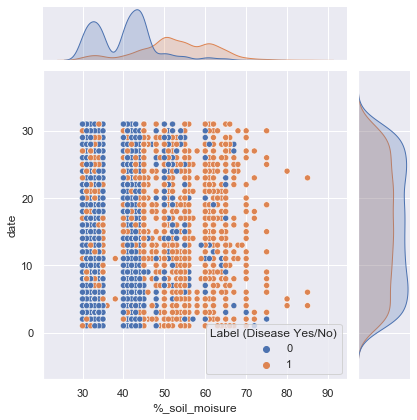

<Figure size 2160x1440 with 0 Axes>

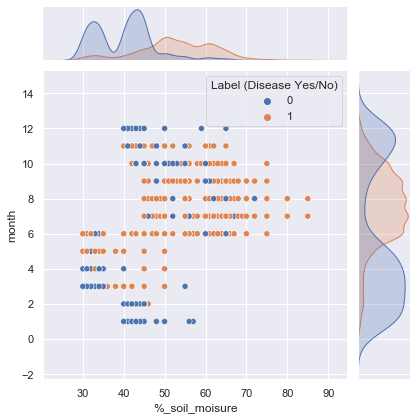

<Figure size 2160x1440 with 0 Axes>

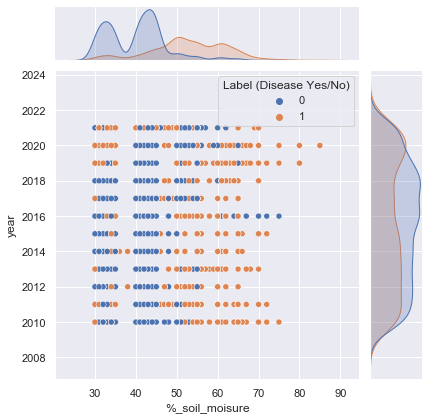

<Figure size 2160x1440 with 0 Axes>

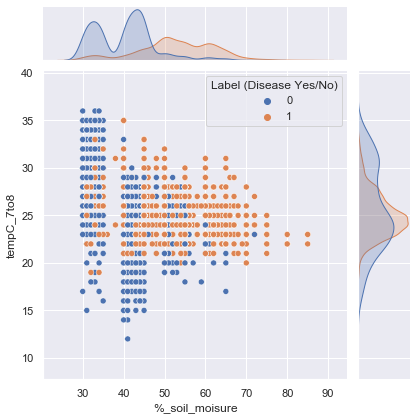

<Figure size 2160x1440 with 0 Axes>

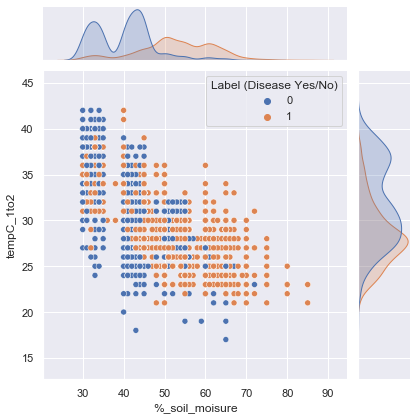

<Figure size 2160x1440 with 0 Axes>

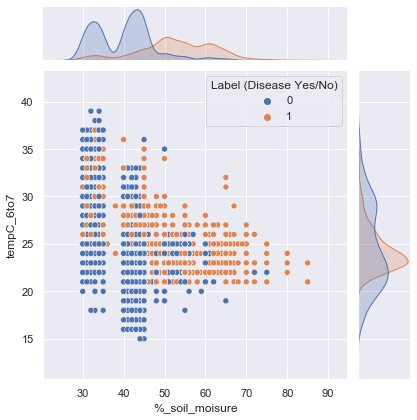

<Figure size 2160x1440 with 0 Axes>

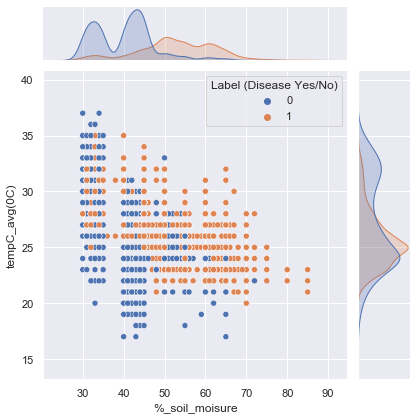

<Figure size 2160x1440 with 0 Axes>

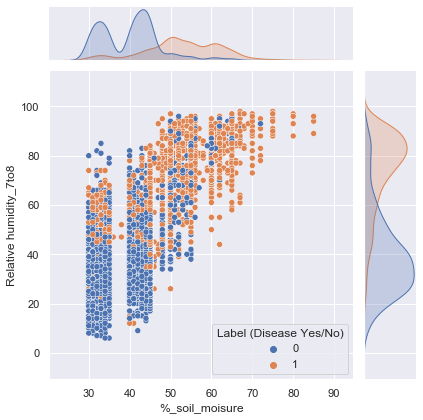

<Figure size 2160x1440 with 0 Axes>

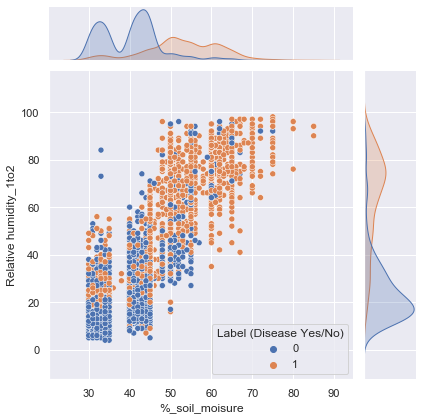

<Figure size 2160x1440 with 0 Axes>

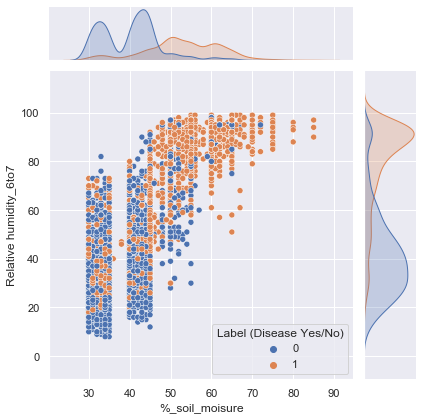

<Figure size 2160x1440 with 0 Axes>

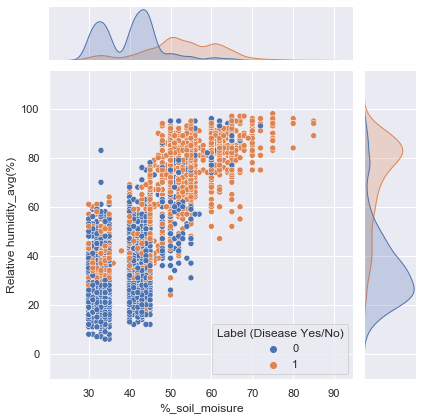

<Figure size 2160x1440 with 0 Axes>

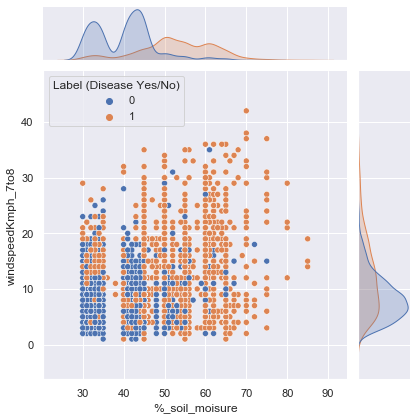

<Figure size 2160x1440 with 0 Axes>

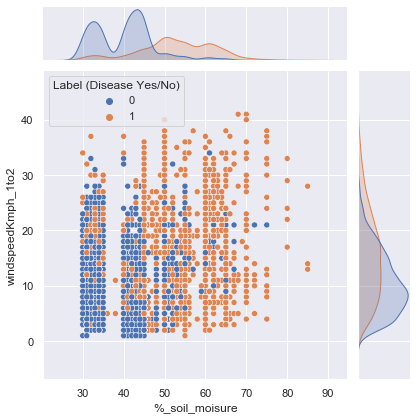

<Figure size 2160x1440 with 0 Axes>

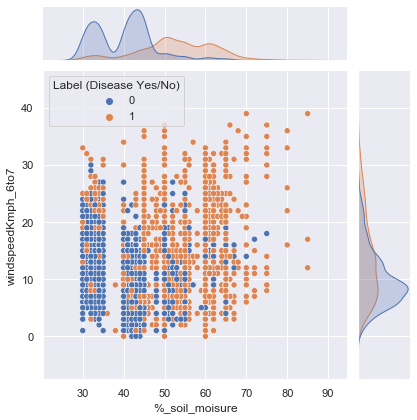

<Figure size 2160x1440 with 0 Axes>

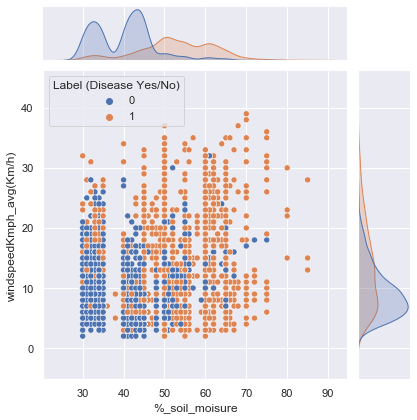

<Figure size 2160x1440 with 0 Axes>

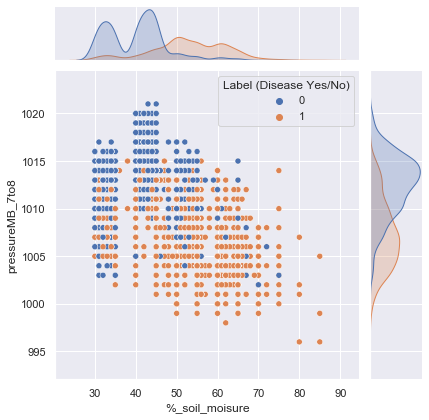

<Figure size 2160x1440 with 0 Axes>

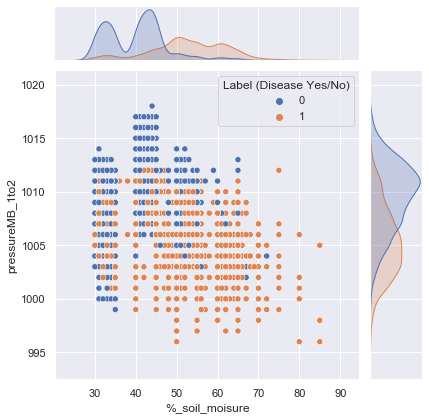

<Figure size 2160x1440 with 0 Axes>

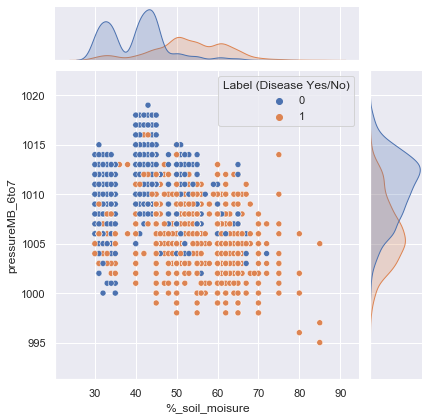

<Figure size 2160x1440 with 0 Axes>

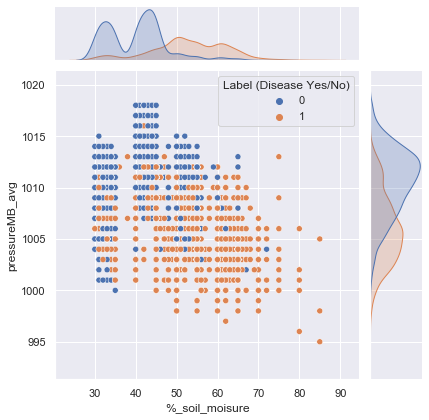

<Figure size 2160x1440 with 0 Axes>

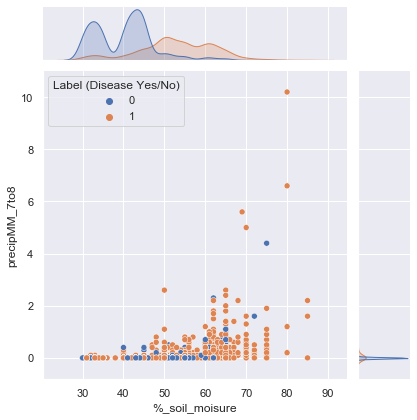

<Figure size 2160x1440 with 0 Axes>

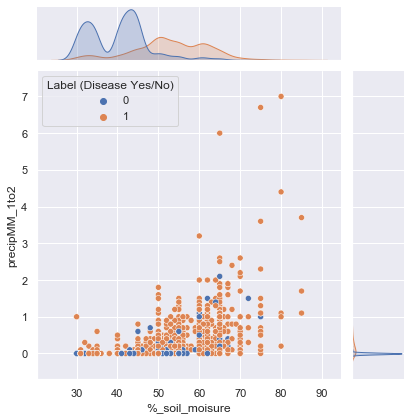

<Figure size 2160x1440 with 0 Axes>

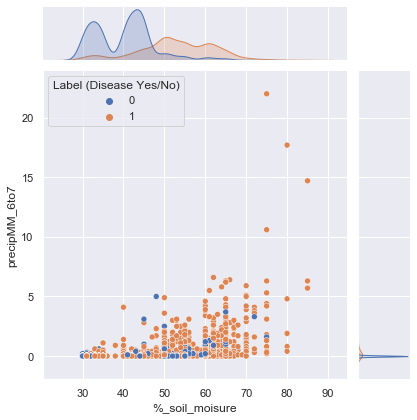

<Figure size 2160x1440 with 0 Axes>

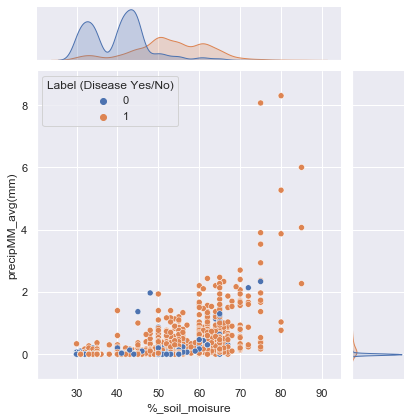

<Figure size 2160x1440 with 0 Axes>

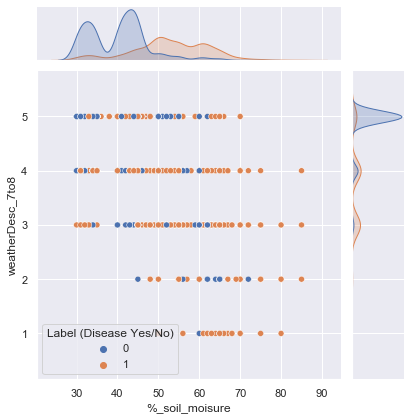

<Figure size 2160x1440 with 0 Axes>

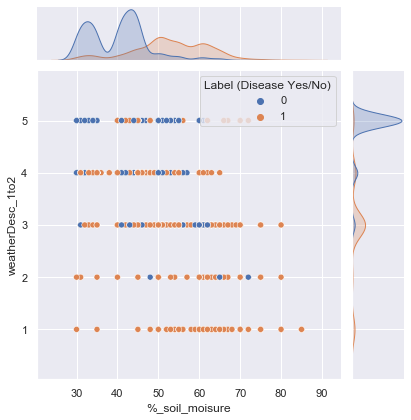

<Figure size 2160x1440 with 0 Axes>

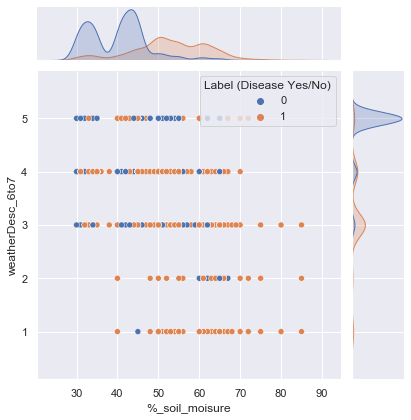

<Figure size 2160x1440 with 0 Axes>

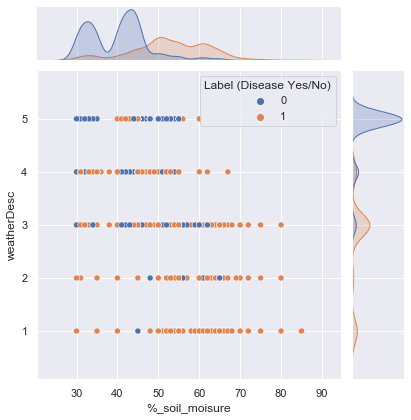

<Figure size 2160x1440 with 0 Axes>

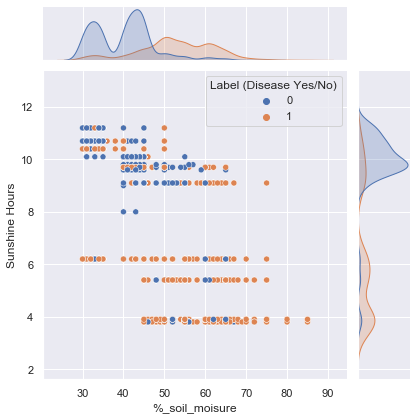

<Figure size 2160x1440 with 0 Axes>

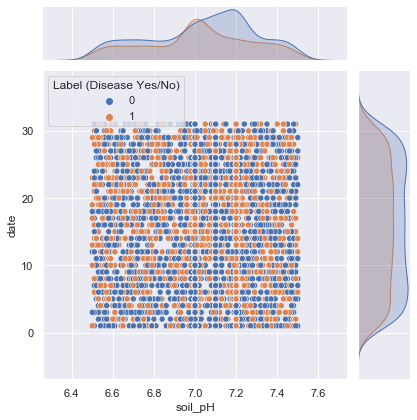

<Figure size 2160x1440 with 0 Axes>

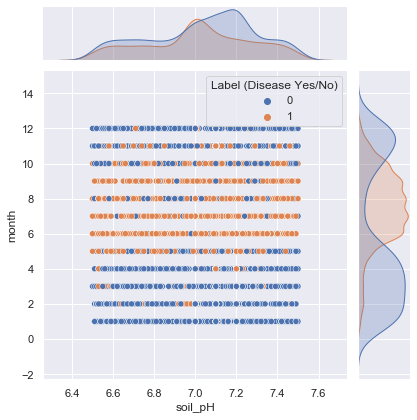

<Figure size 2160x1440 with 0 Axes>

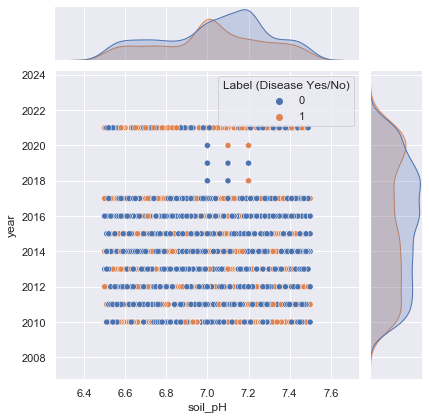

<Figure size 2160x1440 with 0 Axes>

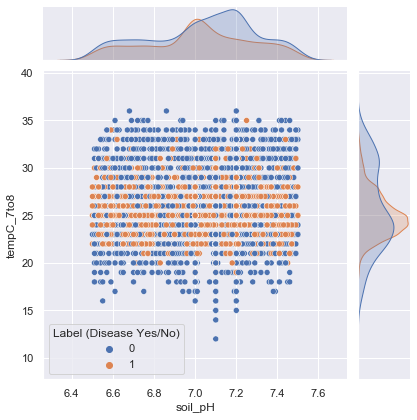

<Figure size 2160x1440 with 0 Axes>

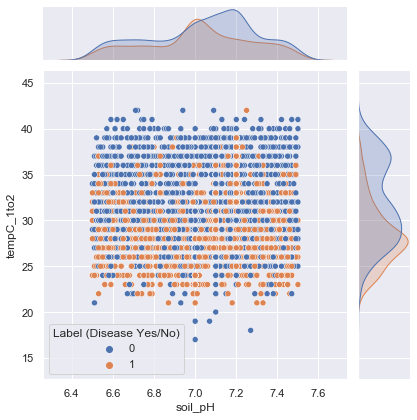

<Figure size 2160x1440 with 0 Axes>

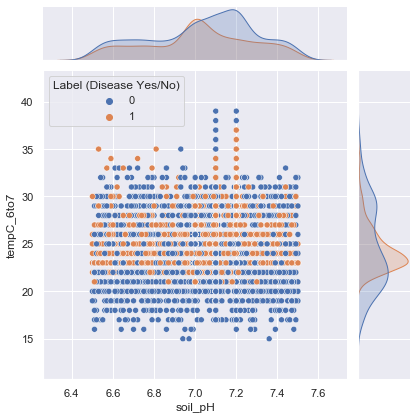

<Figure size 2160x1440 with 0 Axes>

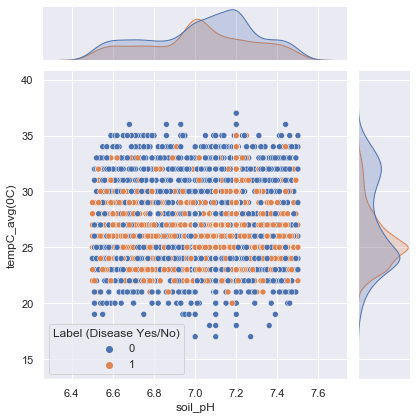

<Figure size 2160x1440 with 0 Axes>

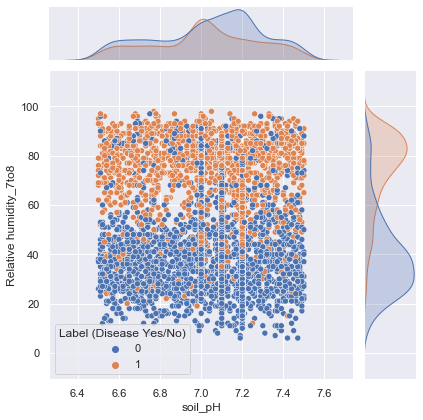

<Figure size 2160x1440 with 0 Axes>

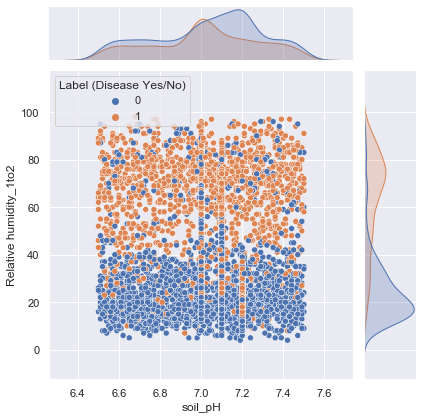

<Figure size 2160x1440 with 0 Axes>

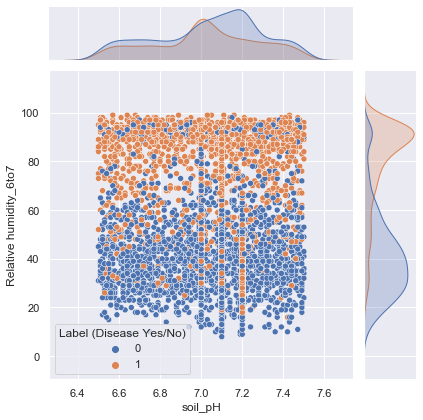

<Figure size 2160x1440 with 0 Axes>

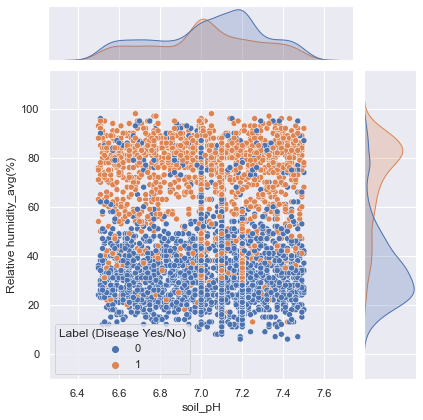

<Figure size 2160x1440 with 0 Axes>

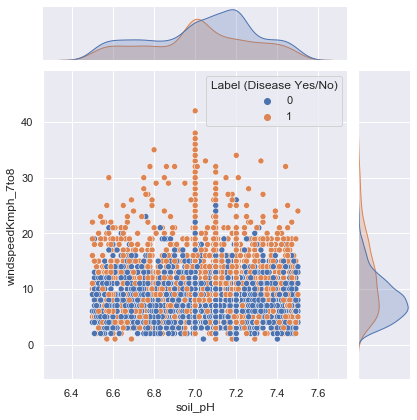

<Figure size 2160x1440 with 0 Axes>

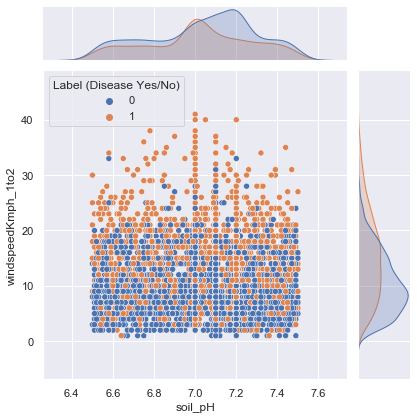

<Figure size 2160x1440 with 0 Axes>

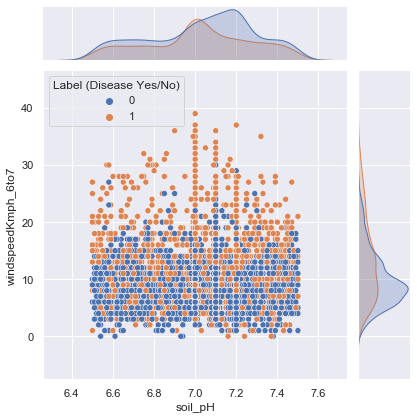

<Figure size 2160x1440 with 0 Axes>

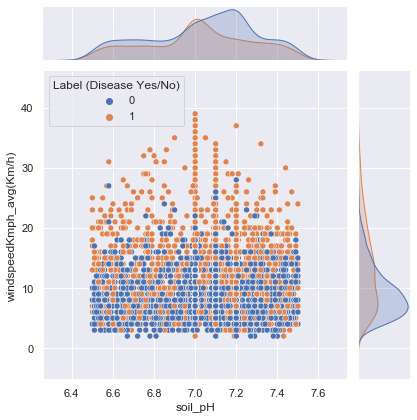

<Figure size 2160x1440 with 0 Axes>

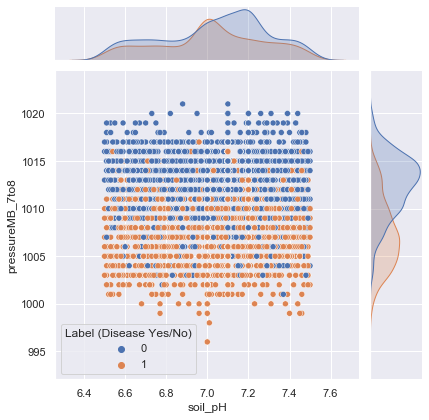

<Figure size 2160x1440 with 0 Axes>

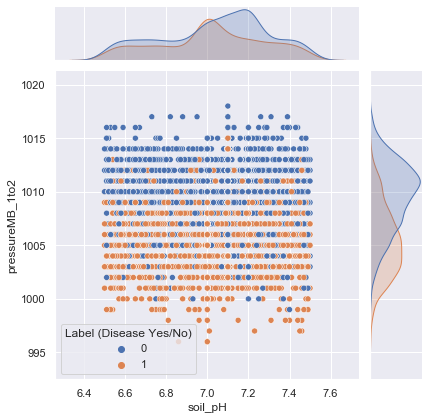

<Figure size 2160x1440 with 0 Axes>

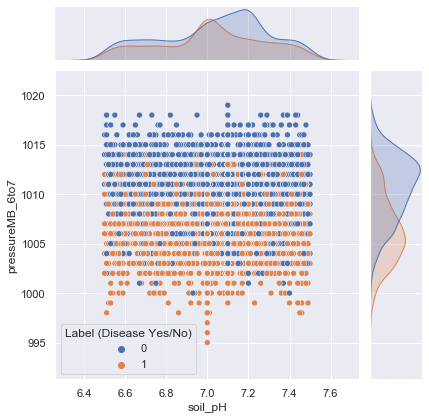

<Figure size 2160x1440 with 0 Axes>

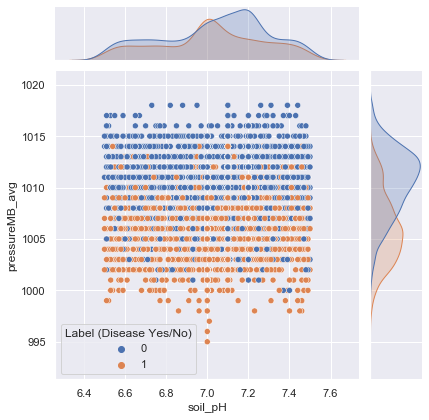

<Figure size 2160x1440 with 0 Axes>

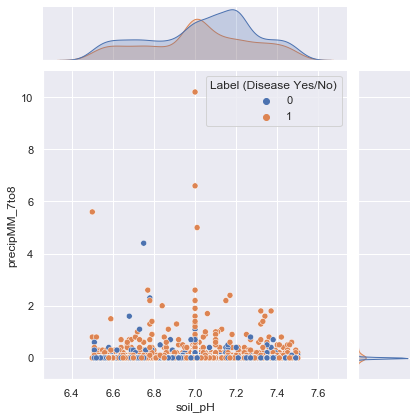

<Figure size 2160x1440 with 0 Axes>

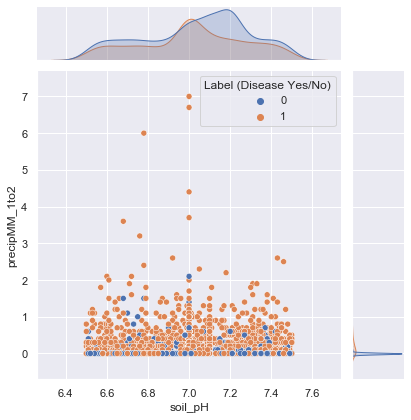

<Figure size 2160x1440 with 0 Axes>

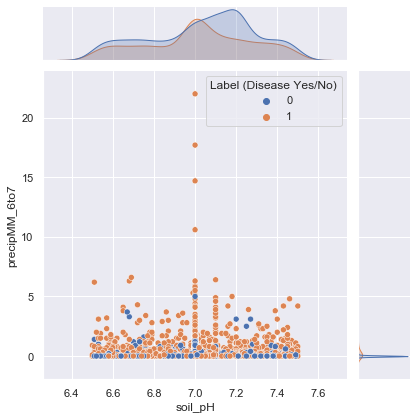

<Figure size 2160x1440 with 0 Axes>

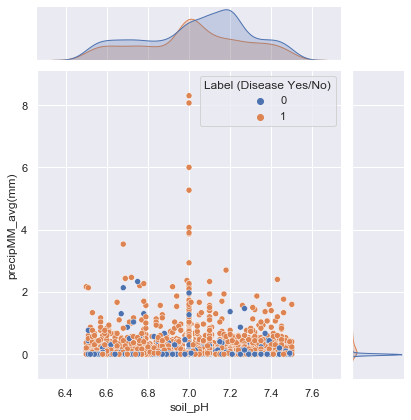

<Figure size 2160x1440 with 0 Axes>

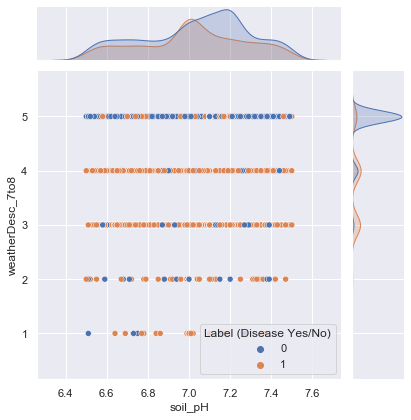

<Figure size 2160x1440 with 0 Axes>

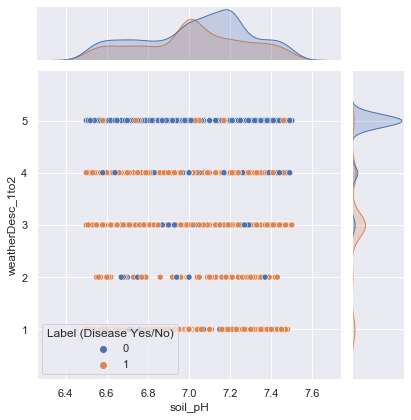

<Figure size 2160x1440 with 0 Axes>

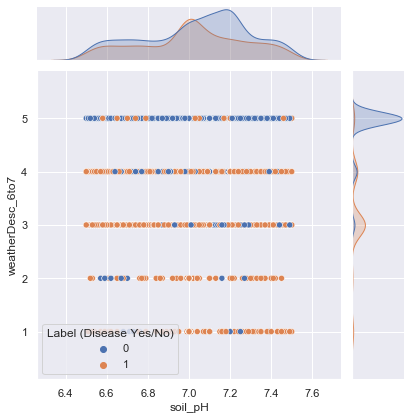

<Figure size 2160x1440 with 0 Axes>

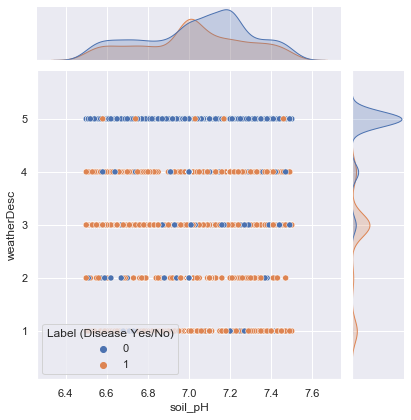

<Figure size 2160x1440 with 0 Axes>

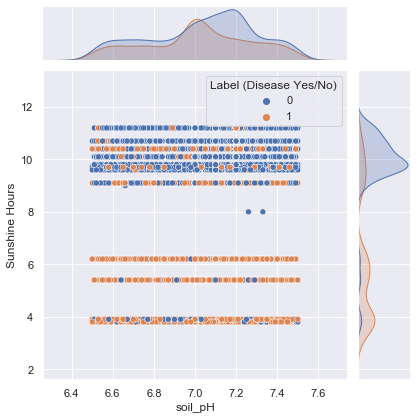

<Figure size 2160x1440 with 0 Axes>

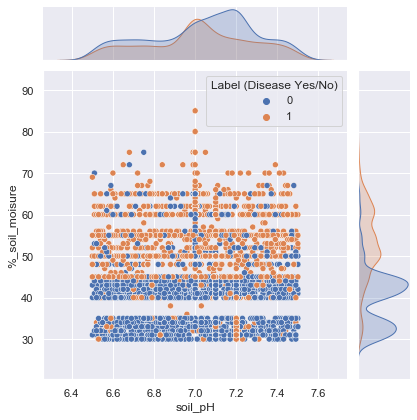

<Figure size 2160x1440 with 0 Axes>

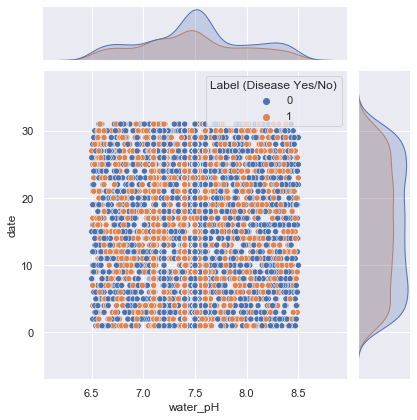

<Figure size 2160x1440 with 0 Axes>

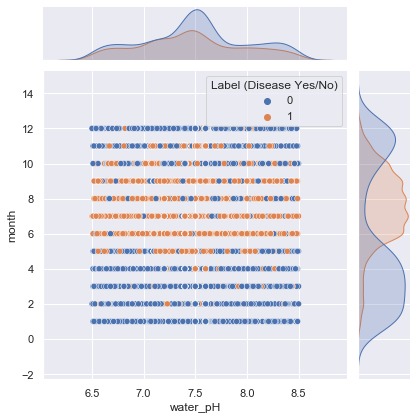

<Figure size 2160x1440 with 0 Axes>

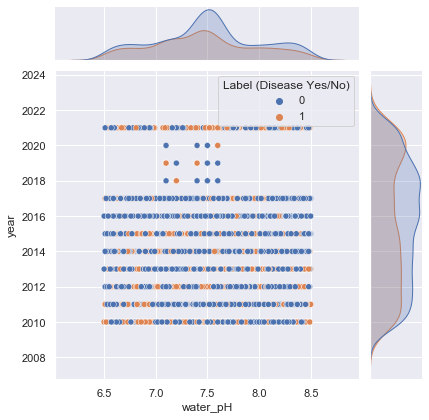

<Figure size 2160x1440 with 0 Axes>

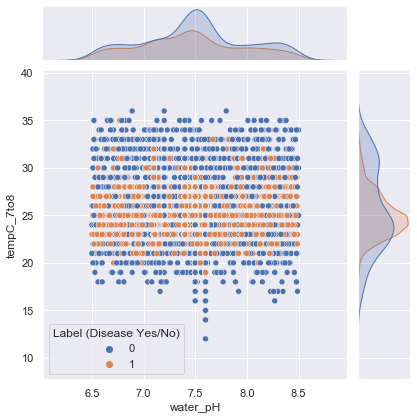

<Figure size 2160x1440 with 0 Axes>

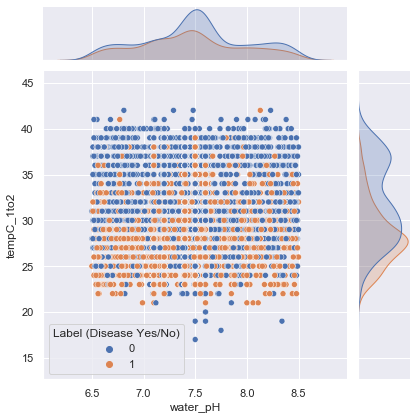

<Figure size 2160x1440 with 0 Axes>

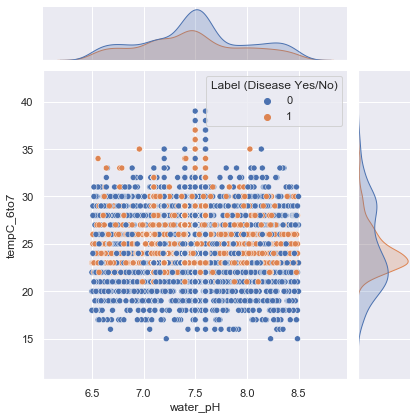

<Figure size 2160x1440 with 0 Axes>

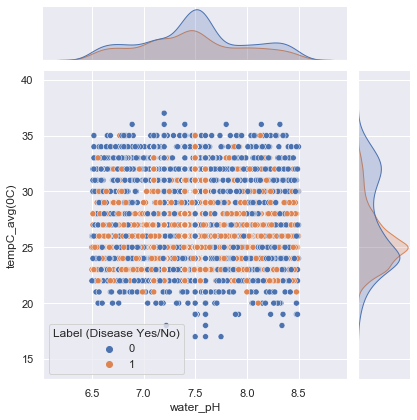

<Figure size 2160x1440 with 0 Axes>

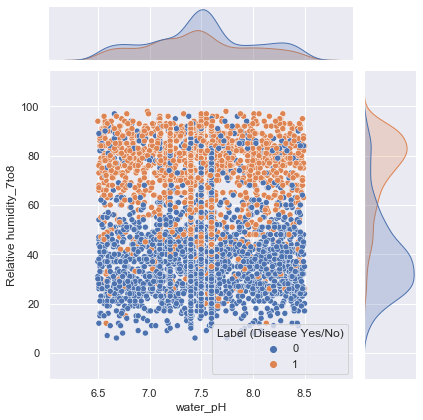

<Figure size 2160x1440 with 0 Axes>

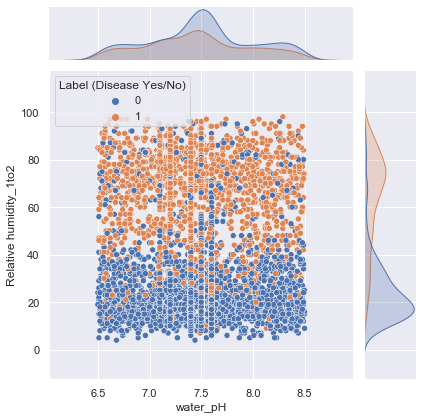

<Figure size 2160x1440 with 0 Axes>

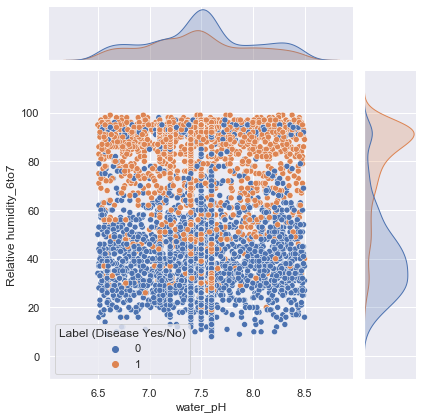

<Figure size 2160x1440 with 0 Axes>

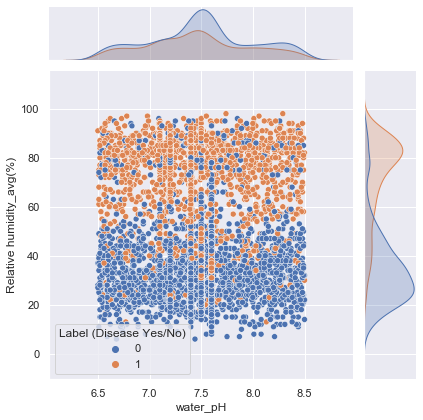

<Figure size 2160x1440 with 0 Axes>

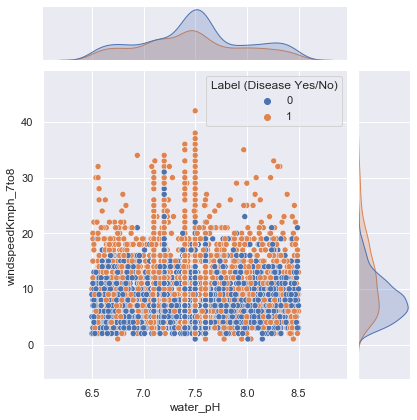

<Figure size 2160x1440 with 0 Axes>

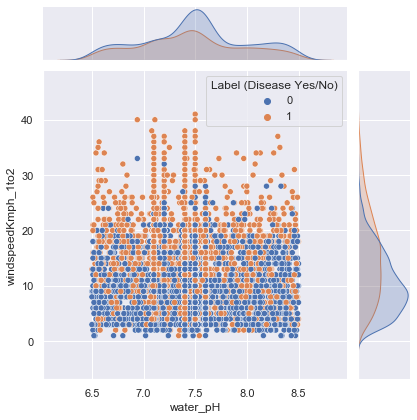

<Figure size 2160x1440 with 0 Axes>

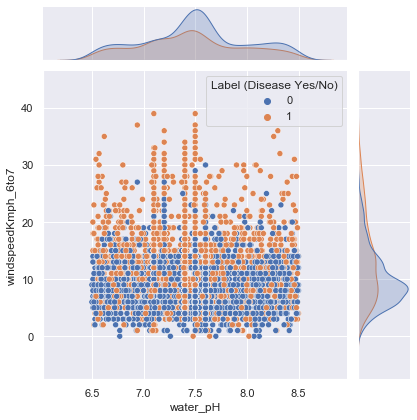

<Figure size 2160x1440 with 0 Axes>

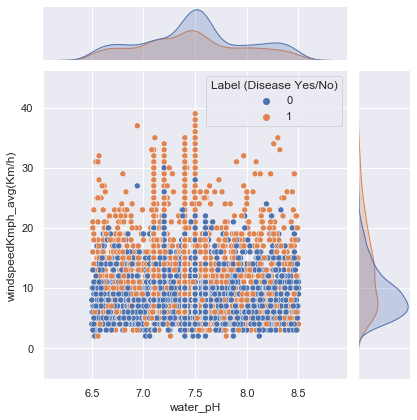

<Figure size 2160x1440 with 0 Axes>

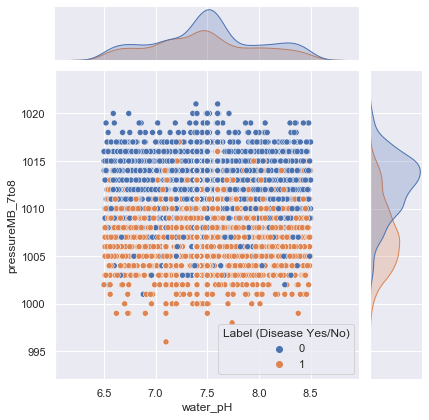

<Figure size 2160x1440 with 0 Axes>

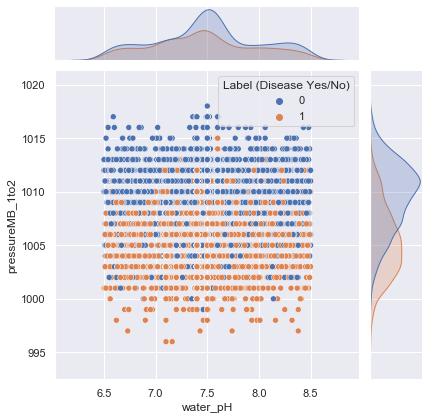

<Figure size 2160x1440 with 0 Axes>

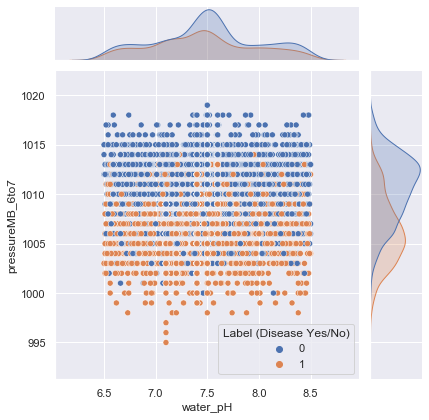

<Figure size 2160x1440 with 0 Axes>

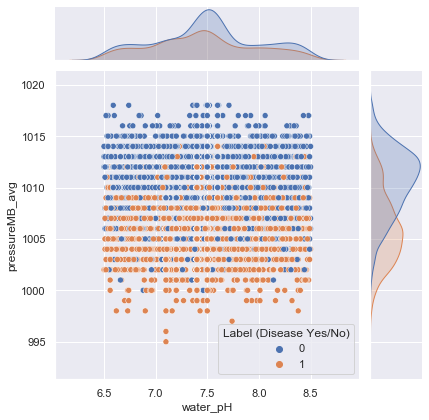

<Figure size 2160x1440 with 0 Axes>

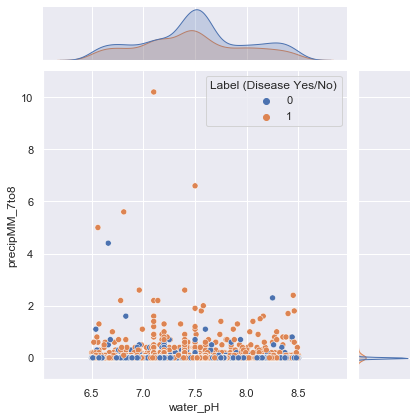

<Figure size 2160x1440 with 0 Axes>

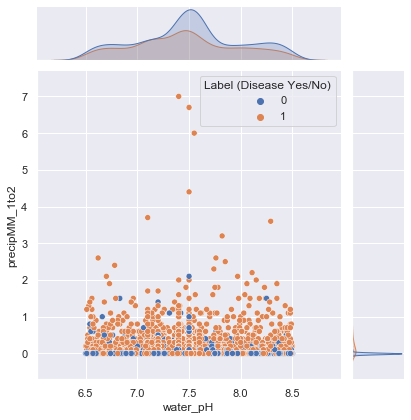

<Figure size 2160x1440 with 0 Axes>

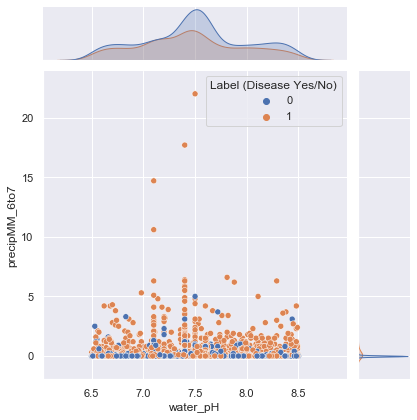

<Figure size 2160x1440 with 0 Axes>

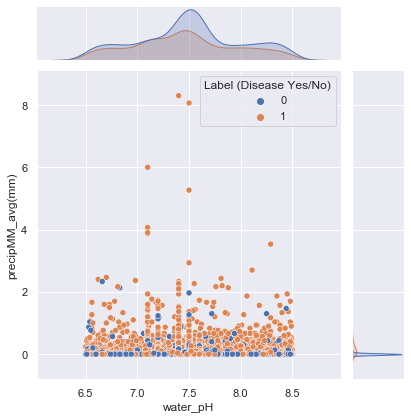

<Figure size 2160x1440 with 0 Axes>

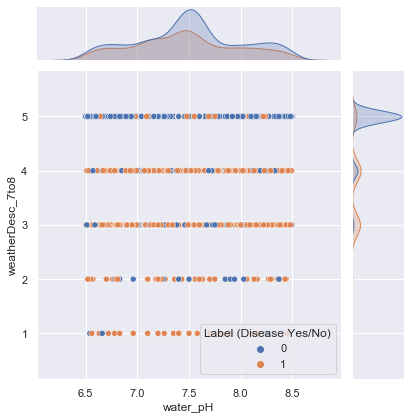

<Figure size 2160x1440 with 0 Axes>

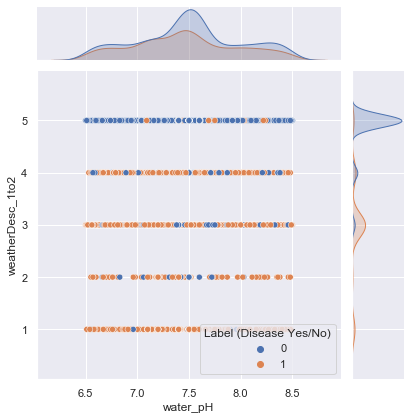

<Figure size 2160x1440 with 0 Axes>

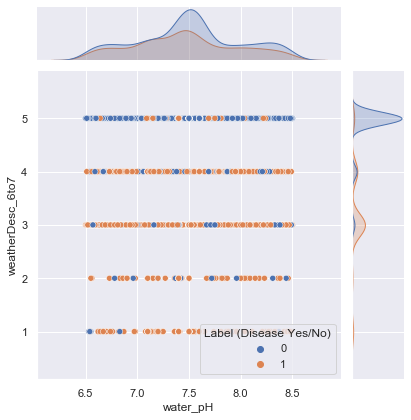

<Figure size 2160x1440 with 0 Axes>

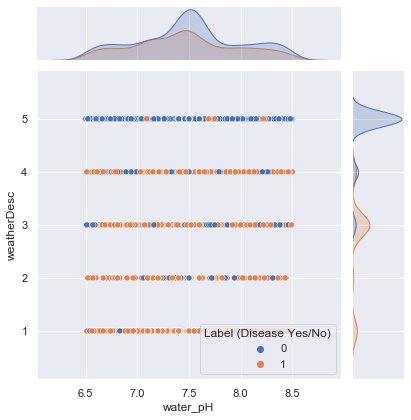

<Figure size 2160x1440 with 0 Axes>

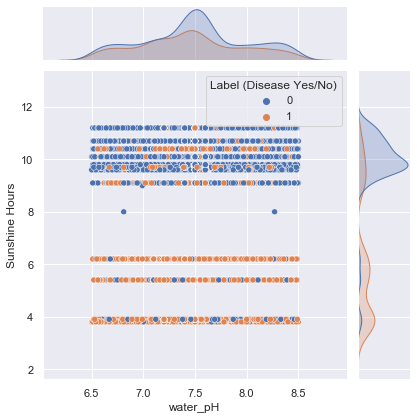

<Figure size 2160x1440 with 0 Axes>

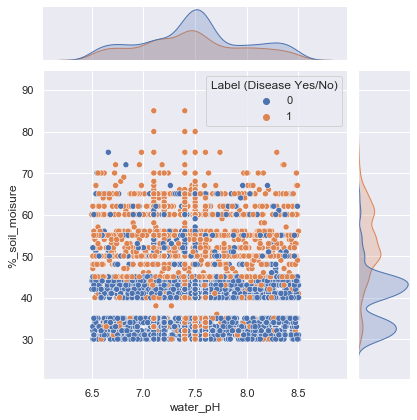

<Figure size 2160x1440 with 0 Axes>

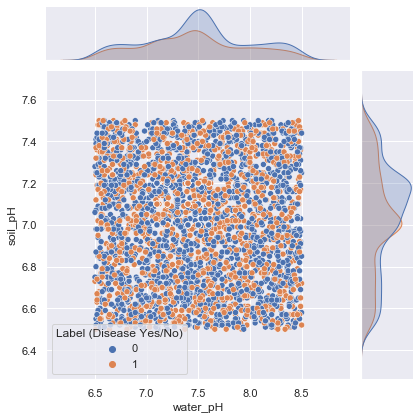

<Figure size 2160x1440 with 0 Axes>

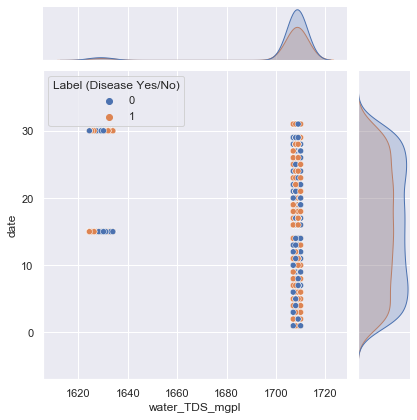

<Figure size 2160x1440 with 0 Axes>

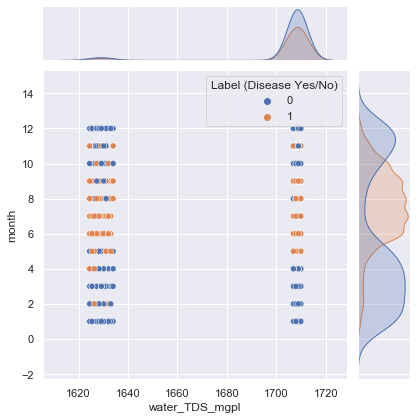

<Figure size 2160x1440 with 0 Axes>

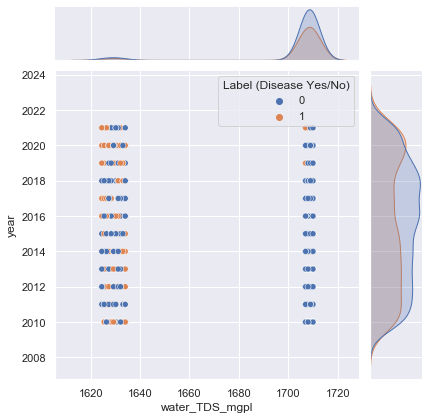

<Figure size 2160x1440 with 0 Axes>

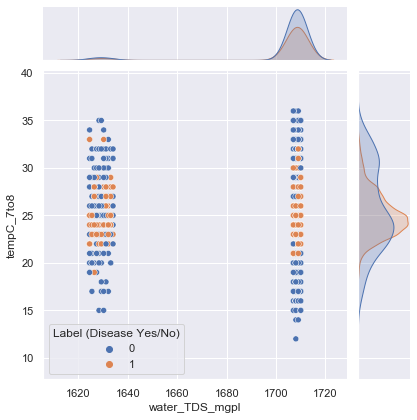

<Figure size 2160x1440 with 0 Axes>

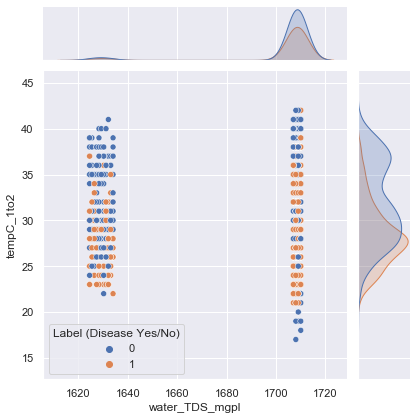

<Figure size 2160x1440 with 0 Axes>

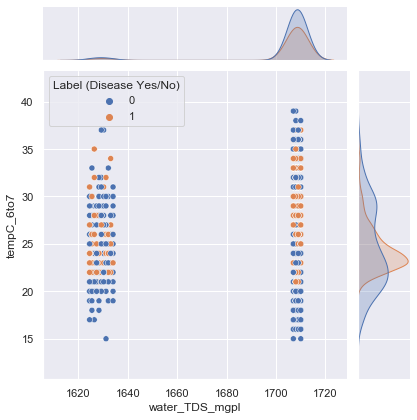

<Figure size 2160x1440 with 0 Axes>

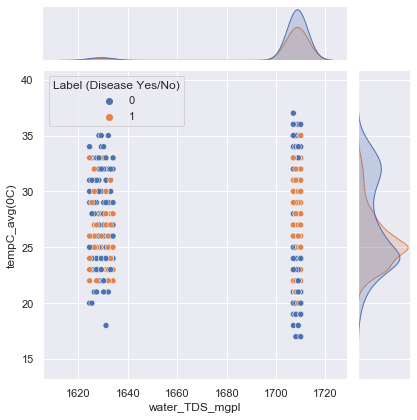

<Figure size 2160x1440 with 0 Axes>

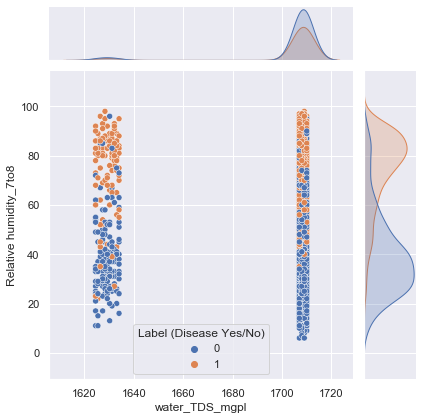

<Figure size 2160x1440 with 0 Axes>

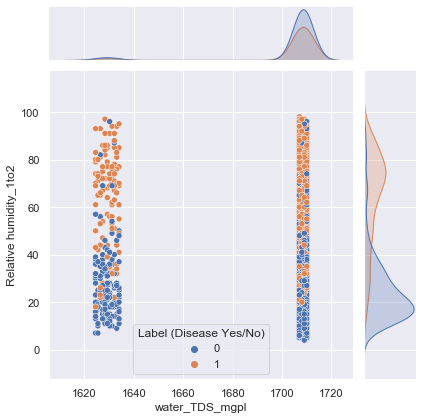

<Figure size 2160x1440 with 0 Axes>

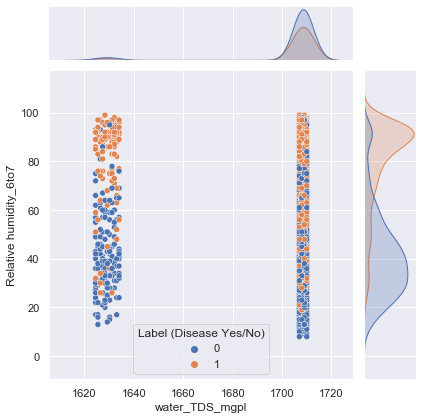

<Figure size 2160x1440 with 0 Axes>

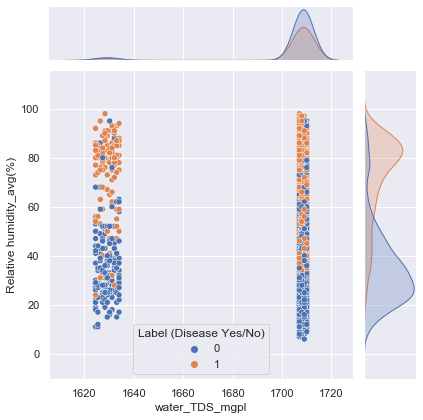

<Figure size 2160x1440 with 0 Axes>

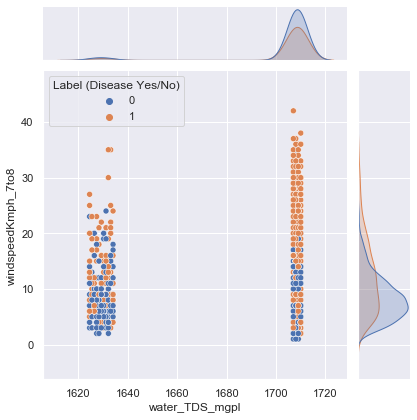

<Figure size 2160x1440 with 0 Axes>

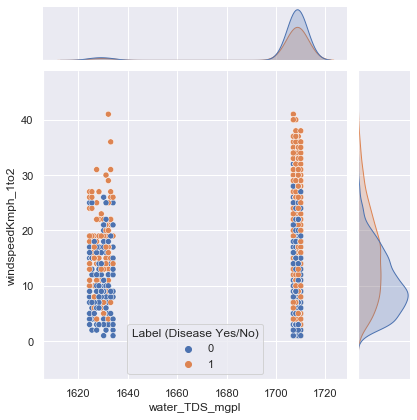

<Figure size 2160x1440 with 0 Axes>

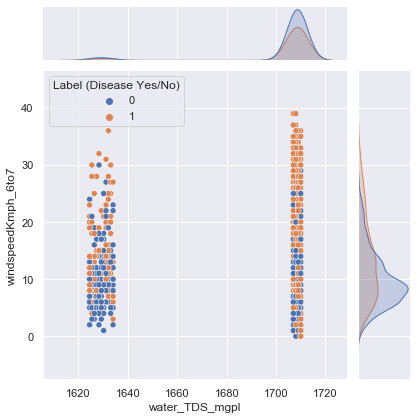

<Figure size 2160x1440 with 0 Axes>

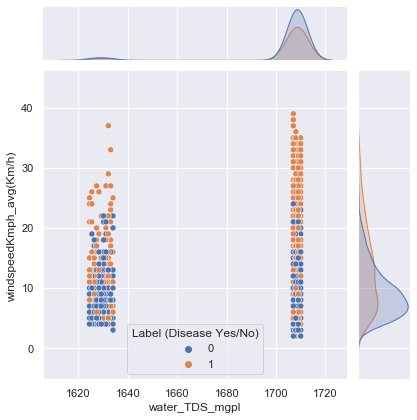

<Figure size 2160x1440 with 0 Axes>

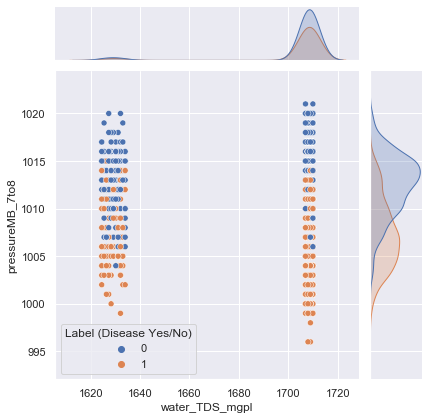

<Figure size 2160x1440 with 0 Axes>

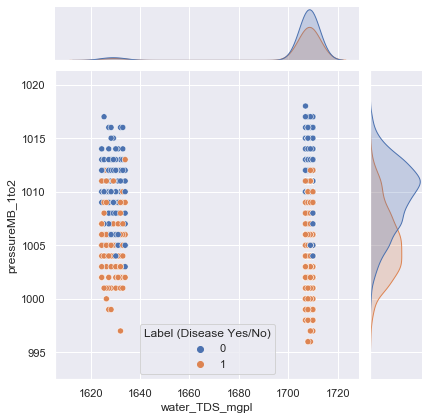

<Figure size 2160x1440 with 0 Axes>

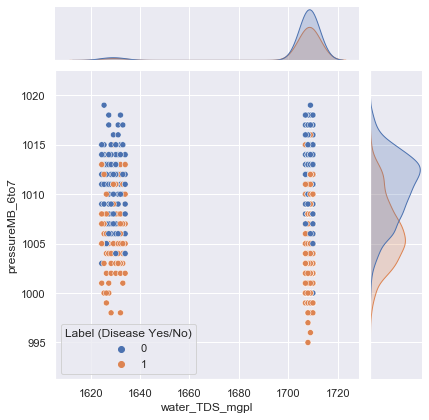

<Figure size 2160x1440 with 0 Axes>

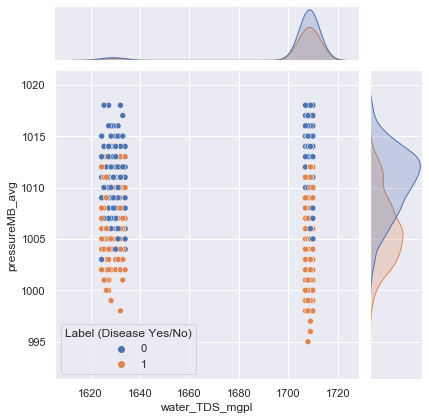

<Figure size 2160x1440 with 0 Axes>

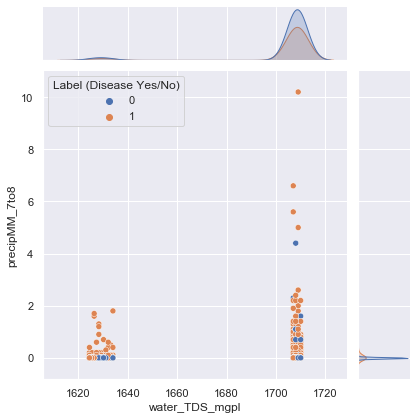

<Figure size 2160x1440 with 0 Axes>

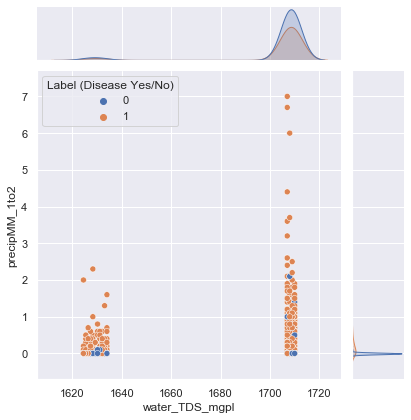

<Figure size 2160x1440 with 0 Axes>

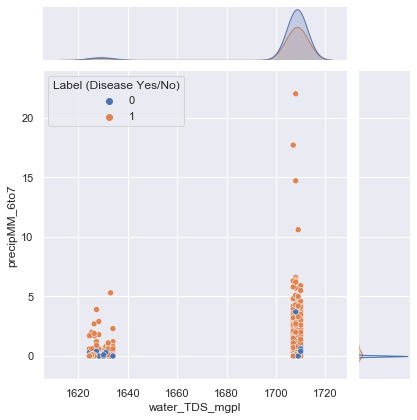

<Figure size 2160x1440 with 0 Axes>

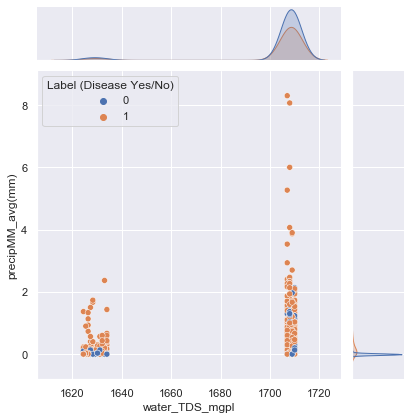

<Figure size 2160x1440 with 0 Axes>

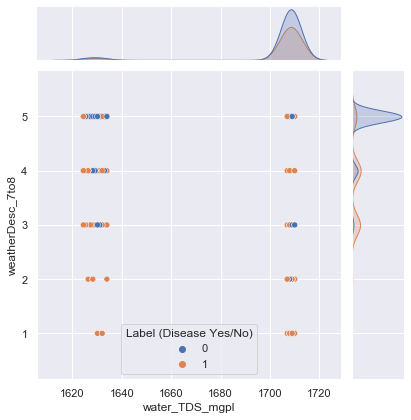

<Figure size 2160x1440 with 0 Axes>

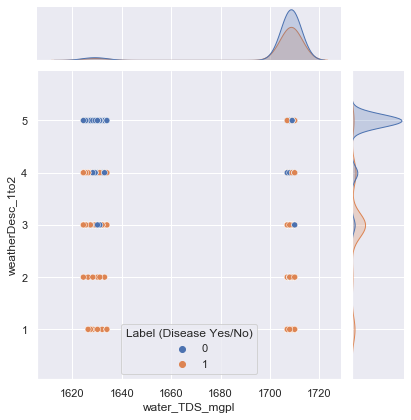

<Figure size 2160x1440 with 0 Axes>

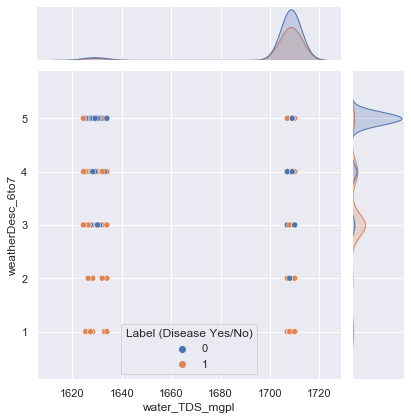

<Figure size 2160x1440 with 0 Axes>

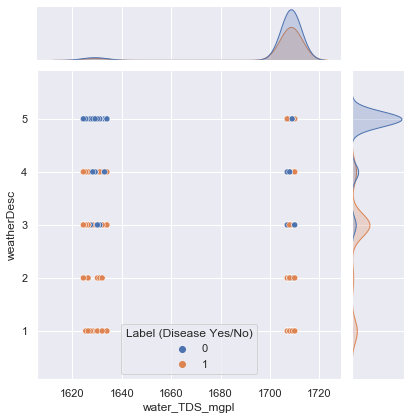

<Figure size 2160x1440 with 0 Axes>

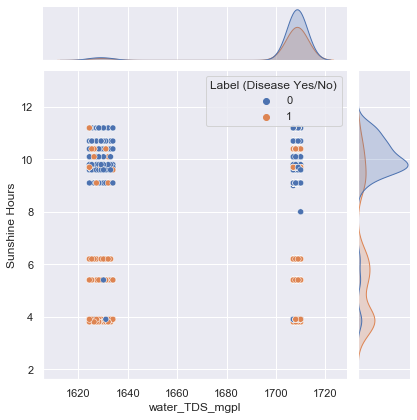

<Figure size 2160x1440 with 0 Axes>

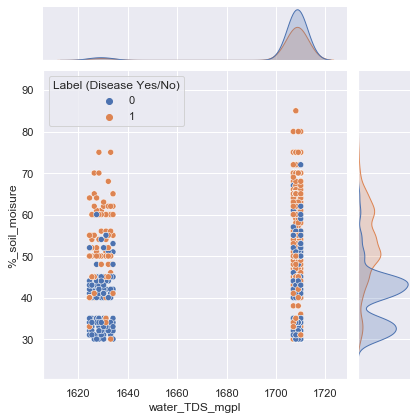

<Figure size 2160x1440 with 0 Axes>

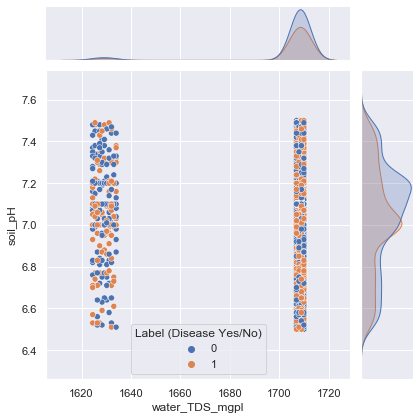

<Figure size 2160x1440 with 0 Axes>

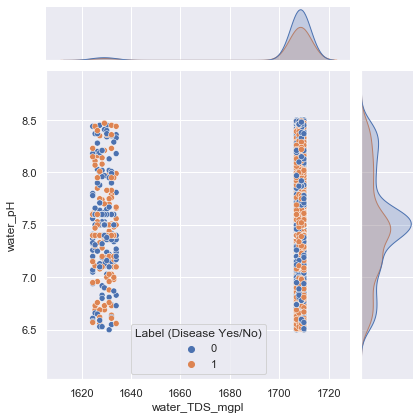

In [56]:
cols = ['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2',
       'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8',
       'Relative humidity_1to2', 'Relative humidity_6to7',
       'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2',
       'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8',
       'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
       'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
       'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7',
       'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH',
       'water_pH', 'water_TDS_mgpl']

for i in range(len(cols)):
    for j in range(i):
#         print(f'Correlation between {cols[i]} & {cols[j]} is : {round(df[cols[i]].corr(df[cols[j]]),2)} % ' )
        plt.figure(figsize=(30, 20))
        sns.set(rc={'figure.figsize':(30,20)})
        sns.jointplot(x = df[cols[i]], y = df[cols[j]], hue=df['Label (Disease Yes/No)'], kind = 'scatter')
        plt.show()
#         print('\n')

In [50]:
# https://towardsdatascience.com/14-data-visualization-plots-of-seaborn-14a7bdd16cd7
# https://seaborn.pydata.org/tutorial/categorical.html
# https://stackoverflow.com/questions/29294983/how-to-calculate-correlation-between-all-columns-and-remove-highly-correlated-on


# Find correlation w.r.t. 'Label (Disease Yes/No)'

In [52]:
data1 = df[['date', 'month', 'year', 'tempC_7to8', 'tempC_1to2',
       'tempC_6to7', 'tempC_avg(0C)', 'Relative humidity_7to8',
       'Relative humidity_1to2', 'Relative humidity_6to7',
       'Relative humidity_avg(%)', 'windspeedKmph_7to8', 'windspeedKmph_1to2',
       'windspeedKmph_6to7', 'windspeedKmph_avg(Km/h)', 'pressureMB_7to8',
       'pressureMB_1to2', 'pressureMB_6to7', 'pressureMB_avg', 'precipMM_7to8',
       'precipMM_1to2', 'precipMM_6to7', 'precipMM_avg(mm)',
       'weatherDesc_7to8', 'weatherDesc_1to2', 'weatherDesc_6to7',
       'weatherDesc', 'Sunshine Hours', '%_soil_moisure', 'soil_pH',
       'water_pH', 'water_TDS_mgpl', 'Label (Disease Yes/No)']]

# separate dataset into train and test
from sklearn.model_selection import train_test_split
train, test = train_test_split(data1, test_size=0.3, random_state=101) # random_state=0,

train.shape, test.shape

((2958, 33), (1269, 33))

In [53]:
train.corr()

,date,month,year,tempC_7to8,tempC_1to2,tempC_6to7,tempC_avg(0C),Relative humidity_7to8,Relative humidity_1to2,Relative humidity_6to7,...,weatherDesc_7to8,weatherDesc_1to2,weatherDesc_6to7,weatherDesc,Sunshine Hours,%_soil_moisure,soil_pH,water_pH,water_TDS_mgpl,Label (Disease Yes/No)
date,1.000000,-0.001586,-0.005383,0.002316,0.011652,0.003134,0.010299,-0.007388,-0.001799,-0.012407,...,-0.002783,0.007790,0.005577,-0.000309,-0.010112,0.016648,-0.007909,-0.015093,-0.185900,-0.003094
month,-0.001586,1.000000,-0.019603,-0.169366,-0.405343,-0.286775,-0.328428,0.396480,0.436940,0.449340,...,-0.188542,-0.251624,-0.243517,-0.255738,-0.316959,0.405426,-0.054263,-0.019023,-0.011602,0.259734
year,-0.005383,-0.019603,1.000000,-0.262669,-0.111837,0.296424,-0.030877,0.112262,0.041334,-0.083882,...,-0.124802,-0.053107,-0.097221,-0.066342,-0.009895,0.004096,0.079259,-0.056434,0.024680,0.006658
tempC_7to8,0.002316,-0.169366,-0.262669,1.000000,0.791498,0.602235,0.888888,-0.359356,-0.318847,-0.237761,...,0.271877,0.173127,0.179092,0.162530,0.249424,-0.411889,0.007868,-0.028174,0.003207,-0.061937
tempC_1to2,0.011652,-0.405343,-0.111837,0.791498,1.000000,0.681746,0.930229,-0.701272,-0.749488,-0.670970,...,0.567981,0.531887,0.506248,0.518509,0.625268,-0.750277,0.037857,0.014743,0.009270,-0.383360
tempC_6to7,0.003134,-0.286775,0.296424,0.602235,0.681746,1.000000,0.846512,-0.222013,-0.296472,-0.346987,...,0.097397,0.090010,0.072770,0.068221,0.260077,-0.440266,0.078987,-0.022702,0.006248,-0.008743
tempC_avg(0C),0.010299,-0.328428,-0.030877,0.888888,0.930229,0.846512,1.000000,-0.493375,-0.525460,-0.483169,...,0.364529,0.311758,0.296224,0.294560,0.436257,-0.609211,0.045217,-0.012249,0.006804,-0.179998
Relative humidity_7to8,-0.007388,0.396480,0.112262,-0.359356,-0.701272,-0.222013,-0.493375,1.000000,0.947646,0.920676,...,-0.755288,-0.763163,-0.722469,-0.765936,-0.822066,0.771469,-0.032468,-0.050761,-0.003705,0.691395
Relative humidity_1to2,-0.001799,0.436940,0.041334,-0.318847,-0.749488,-0.296472,-0.525460,0.947646,1.000000,0.952138,...,-0.778631,-0.811868,-0.767449,-0.807876,-0.868475,0.847898,-0.041018,-0.057041,-0.013927,0.698796
Relative humidity_6to7,-0.012407,0.449340,-0.083882,-0.237761,-0.670970,-0.346987,-0.483169,0.920676,0.952138,1.000000,...,-0.680800,-0.759023,-0.714871,-0.761998,-0.838104,0.802292,-0.051234,-0.046953,-0.011324,0.689645


In [1]:
.8 * (1 - .8)

0.15999999999999998

In [2]:
(1 - .8)

0.19999999999999996

In [3]:
# pearson's correlation feature selection for numeric input and numeric output
from sklearn.datasets import make_regression
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
# generate dataset
X, y = make_regression(n_samples=100, n_features=100, n_informative=10)
# define feature selection
fs = SelectKBest(score_func=f_regression, k=10)
# apply feature selection
X_selected = fs.fit_transform(X, y)
print(X_selected.shape)

(100, 10)


In [4]:
X_selected

array([[-1.35984344e+00,  1.64874838e+00, -4.58771194e-01,
        -3.15580799e-01, -1.27276168e+00,  7.74864036e-01,
        -1.99218801e-01,  1.80058920e+00,  3.32378603e-01,
         8.47537215e-01],
       [-3.07027385e-02, -7.14982970e-01, -7.95838498e-01,
         1.26667086e+00,  1.65309791e-01, -3.44224396e-01,
        -4.66183030e-01,  2.53342020e-01,  1.16429746e+00,
         3.43377211e-01],
       [-1.07940714e+00,  6.32057734e-01, -6.15142940e-01,
         1.54578251e+00,  3.30294070e-01, -9.05558657e-01,
         5.94050687e-01, -8.11210944e-01, -7.16302934e-01,
         1.52639468e+00],
       [-1.94037814e-01, -3.87806817e-01,  1.78991377e+00,
         9.82456731e-01,  1.13307596e+00,  1.26557514e+00,
        -4.02326457e-01, -1.13238809e+00,  1.06372386e+00,
         9.14308254e-02],
       [-4.51903109e-01,  1.26012219e+00,  5.18820712e-01,
        -1.55288722e+00, -7.69064600e-01, -3.14564646e-01,
        -7.65233021e-01, -1.52986460e+00, -1.39840426e+00,
         3.

In [5]:
# ANOVA feature selection for numeric input and categorical output
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
# generate dataset
X, y = make_classification(n_samples=100, n_features=20, n_informative=2)
# define feature selection
fs = SelectKBest(score_func=f_classif, k=2)
# apply feature selection
X_selected = fs.fit_transform(X, y)
print(X_selected.shape)

(100, 2)


In [9]:
X_selected, y

(array([[-0.36061881,  0.33190407],
        [ 0.64674727, -1.37419331],
        [-0.04359339, -0.47817394],
        [ 0.34284075, -1.08884669],
        [ 0.74495447, -1.16588708],
        [-0.93427624,  1.88945533],
        [-0.23221945, -0.10756892],
        [-0.15119041,  0.19103538],
        [-0.3569979 ,  1.28608741],
        [ 0.4400453 , -1.05141357],
        [-0.7168451 ,  1.70699775],
        [ 0.90896715, -1.43723197],
        [-0.37554601,  0.08976395],
        [-0.65328156,  1.37400603],
        [ 0.52854534, -0.77954328],
        [ 0.29847659, -1.13147264],
        [-0.5645743 ,  1.68925468],
        [-0.10058746,  1.01858047],
        [-0.91920708,  1.70151218],
        [-0.87266534,  1.10453915],
        [-0.18434425, -0.16984298],
        [ 0.75676194, -1.22178629],
        [ 0.54435224, -0.76532315],
        [ 0.57174593, -0.87999457],
        [-0.58570162,  1.26998401],
        [-0.56319437,  0.53180938],
        [-0.15923698, -0.34006542],
        [-0.79355324,  1.638

In [12]:
# # Feature Selection with Univariate Statistical Tests
# from pandas import read_csv
# from numpy import set_printoptions
# from sklearn.feature_selection import SelectKBest
# from sklearn.feature_selection import f_classif
# # load data
# filename = 'pima-indians-diabetes.data.csv'
# names = ['preg', 'plas', 'pres', 'skin', 'test', 'mass', 'pedi', 'age', 'class']
# dataframe = read_csv(filename, names=names)
# array = dataframe.values
# X = array[:,0:8]
# Y = array[:,8]
# # feature extraction
# test = SelectKBest(score_func=f_classif, k=4)
# fit = test.fit(X, Y)
# # summarize scores
# set_printoptions(precision=3)
# print(fit.scores_)
# features = fit.transform(X)
# # summarize selected features
# print(features[0:5,:])